In [1]:
import ps_utils
import os
from skimage.io import imshow
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
path = r'C:\Users\tibor\Documents\semester 1\Vision and Image processing\assignments\assignment 3\DataAndCodeAssignment3'
filename ='face'

In [3]:
I_face, mask_face, S_face = ps_utils.read_data_file(os.path.join(path,filename))

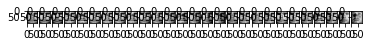

In [4]:
# show the 3 available images of the face
fig, axes = plt.subplots(1, S_face.shape[0])
ax = axes.ravel()

for i in range(S_face.shape[0]):
    ax[i].imshow(I_face[:,:,i],cmap = 'Greys_r')



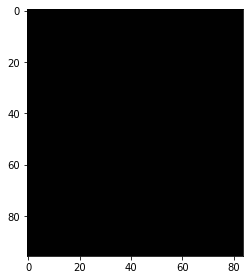

In [5]:
# show what is masked, which is nothing.
imshow(mask_face, cmap = 'Greys_r')

In [6]:
mask_face.sum() == mask_face.size #no part of the image is masked. so the masked image is identical to the unmasked image

True

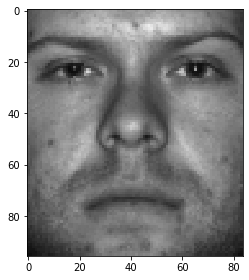

In [7]:
# show face clipped with the mask
imshow(mask_face * I_face[:,:,0])

In [8]:
mask_face_new = 1 - mask_face #take 1-mask so that the face is shown and not the background

In [9]:
nr_of_pictures = I_face.shape[2]

In [10]:
J = np.ndarray((nr_of_pictures,mask_face.size)) #create nd array with the the amount of non-zero cells
for i in range(nr_of_pictures):
    masked_I_face = np.ma.masked_array(I_face[:,:,i], mask=mask_face_new)
    compressed_I_face = masked_I_face.compressed()
    J[i] = compressed_I_face


In [11]:
J.shape

(27, 8064)

In [12]:
# implement ransac

In [13]:
normal_field = np.zeros((I_face.shape[0], I_face.shape[1],3))
for i in range(I_face.shape[0]):
    for j in range(I_face.shape[1]):
        m, inliers, best_fit =ps_utils.ransac_3dvector(data =(I_face[i,j,:],S_face), threshold =10) 
        normal_field[i,j] = m

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [23, 1, 5]
ransac_3dvector(): estimated model [-136.04008205  -20.55644842   91.48659749]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [-121.15435316  -27.43599828   89.22996101]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 19, 11]
ransac_3dvector(): estimated model [-105.16536492  -26.23546932   77.9470726 ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [-106.74920249  -27.36396074   82.88209365]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [25, 11, 7]
ransac_3dvector(): selected indices =  [5, 3, 13]
ransac_3dvector(): estimated model [-30.54494807 -59.1356168

ransac_3dvector(): estimated model [  36.36894212 -162.98256017  261.57240239]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [22, 12, 15]
ransac_3dvector(): estimated model [-55.65737343 -94.01038657 166.48877922]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-57.1165134  -95.26837018 165.94472509]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [26, 5, 6]
ransac_3dvector(): estimated model [ -40.2406866  -118.0547949   170.27096282]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ -47.8086373  -120.0852968   172.12828545]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector()

ransac_3dvector(): estimated model [  21.42972    -239.89798275  113.65540784]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [  14.13952673 -234.44932278  117.10178625]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [8, 10, 24]
ransac_3dvector(): estimated model [ 19.49913769 -97.71007385 148.69044518]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 20.19509592 -92.1009645  147.79116851]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 1, 14]
ransac_3dvector(): selected indices =  [21, 13, 6]
ransac_3dvector(): estimated model [ 87.31599662 -56.32649044 152.15728772]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at 

ransac_3dvector(), updating best model to [   6.00520255 -112.30633936  173.3473556 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [6, 15, 3]
ransac_3dvector(): selected indices =  [10, 21, 0]
ransac_3dvector(): estimated model [  35.62690555 -171.77461299  172.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [6, 2, 3]
ransac_3dvector(): selected indices =  [10, 18, 15]
ransac_3dvector(): estimated model [   3.77435151 -115.63105994  170.9415774 ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [23, 12, 19]
ransac_3dvector(): estimated model [ 15.26702231 -74.51237015 151.27621928]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =

ransac_3dvector(), updating best model to [  79.83858935 -103.02751151  144.88860383]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [18, 8, 6]
ransac_3dvector(): selected indices =  [23, 15, 0]
ransac_3dvector(): estimated model [ 64.05512131 -68.39251645 135.        ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [0, 2, 21]
ransac_3dvector(): estimated model [ 133.31882899 -150.6711396   135.        ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [17, 10, 16]
ransac_3dvector(): estimated model [ 40.08627047   8.63815572 144.80183806]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [24, 20, 18]
ransac_3dvector(): selected indices = 

ransac_3dvector(): selected indices =  [6, 0, 22]
ransac_3dvector(): selected indices =  [15, 21, 13]
ransac_3dvector(): estimated model [-36.83001766  80.37838182 100.88731804]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [1, 23, 24]
ransac_3dvector(): estimated model [-105.24027322  -29.68802818  100.93310754]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [-103.081891    -36.26611322  101.87144743]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [11, 18, 2]
ransac_3dvector(): estimated model [-98.43453813 -49.72069595  94.52908741]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-100.0252747   -43.40623414   97.45942525]
ransac_3dvector()

ransac_3dvector(): selected indices =  [7, 14, 0]
ransac_3dvector(): selected indices =  [16, 7, 5]
ransac_3dvector(): selected indices =  [10, 3, 26]
ransac_3dvector(): estimated model [-65.36856691 -81.89546112 157.50884287]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-64.8923095  -77.91865156 158.13885913]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 15, 7]
ransac_3dvector(): selected indices =  [23, 1, 25]
ransac_3dvector(): estimated model [-82.16183346 -68.26456996 160.32066089]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [16, 25, 17]
ransac_3dvector(): estimated model [-22.29467734   5.75877048 142.61467349]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  4
ransac_3dvector(): selected i

ransac_3dvector(), updating best model to [  -7.07988191 -136.66719148  172.94213775]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [24, 13, 18]
ransac_3dvector(): selected indices =  [4, 7, 13]
ransac_3dvector(): estimated model [ 168.21928828 -158.99680259  205.33040306]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [19, 7, 8]
ransac_3dvector(): estimated model [ -24.51342218 -130.30467435  171.34642614]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [23, 1, 2]
ransac_3dvector(): estimated model [ 323.30899085 -203.41184291  147.31312056]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [0, 10, 3]
ransac_3dvector(): estimated model [

ransac_3dvector(): estimated model [-143.69195322 -137.22864911  145.25490253]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 16, 25]
ransac_3dvector(): estimated model [  51.31066221 -108.78951569  133.22812576]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [8, 9, 11]
ransac_3dvector(): selected indices =  [18, 6, 9]
ransac_3dvector(): estimated model [ -32.53153567 -137.25317952  162.11188569]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [5, 3, 12]
ransac_3dvector(): estimated model [ -37.14386519 -109.06094054  158.8828466 ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [11, 0, 24]
ransac_3dvector(): selected indices =  [12, 22, 4]
ransac_3dvector(): selected indices =  

ransac_3dvector(): selected indices =  [4, 22, 24]
ransac_3dvector(): selected indices =  [11, 17, 1]
ransac_3dvector(): estimated model [ 99.69575595 -88.99052538 177.25311881]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [1, 13, 20]
ransac_3dvector(): selected indices =  [9, 26, 20]
ransac_3dvector(): estimated model [ 123.3500153  -171.05423938  170.2110136 ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [16, 21, 1]
ransac_3dvector(): selected indices =  [16, 12, 3]
ransac_3dvector(): selected indices =  [4, 21, 20]
ransac_3dvector(): estimated model [  27.94322649 -144.14204571  205.91596161]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [7, 19, 0]
ransac_3dvector(): selected indices =  [22, 0, 12]
ransac_3dvector(): estimated model [ 53.9715288  -75

ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 80.69338127 -83.89558294 144.87499794]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [22, 15, 8]
ransac_3dvector(): selected indices =  [25, 4, 15]
ransac_3dvector(): estimated model [  80.56154627 -128.65959387  169.43876576]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [14, 1, 22]
ransac_3dvector(): estimated model [  90.89024435 -113.59239045  142.75850568]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [15, 3, 13]
ransac_3dvector(): estimated model [ 77.23536601 -22.34660315 119.87216449]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices 

ransac_3dvector(): estimated model [-176.91104713  -24.3901576    83.        ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 5, 18]
ransac_3dvector(): estimated model [-132.5600069   -51.6269589    96.48462184]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [-121.3385422   -45.17860613   96.8718231 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [12, 2, 1]
ransac_3dvector(): estimated model [-121.56868979  -42.24383017   92.10645826]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [22, 10, 17]
ransac_3dvector(): selected indices =  [17, 12, 23]
ransac_3dvector(): estimated model [-95.41888941 -36.30134516  96

ransac_3dvector(): estimated model [-60.39437873 -53.09817757 170.261358  ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [24, 14, 2]
ransac_3dvector(): estimated model [-121.28895176  -92.91598188  195.58358484]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [24, 1, 5]
ransac_3dvector(): selected indices =  [17, 23, 22]
ransac_3dvector(): estimated model [-83.44429439 -64.14313853 180.72335362]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 12, 8]
ransac_3dvector(): estimated model [-48.49535081 -76.1103093  179.50617021]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-52.73210986 -79.62313001 177.77102598]
ransac_3dvector(): estimate of runs to selec

ransac_3dvector(): estimated model [105.44726017 -77.43580052 147.        ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [13, 2, 16]
ransac_3dvector(): estimated model [  -0.7478157  -238.97992822  118.81610306]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [7, 3, 4]
ransac_3dvector(): selected indices =  [26, 22, 2]
ransac_3dvector(): estimated model [ 141.33218028 -226.29645843  131.49957285]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [2, 26, 20]
ransac_3dvector(): selected indices =  [25, 20, 7]
ransac_3dvector(): estimated model [ -12.99688169 -199.52896864  166.26911667]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [9, 19, 13]
ransac_3dvector(): estimated model [ 100.11

ransac_3dvector(): estimated model [  22.61416947 -167.03607252  183.29313585]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [4, 6, 3]
ransac_3dvector(): selected indices =  [16, 4, 10]
ransac_3dvector(): estimated model [-13.67610093 -90.62313803 175.76626655]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [25, 15, 3]
ransac_3dvector(): estimated model [  -9.88013747 -155.75750268  196.09838293]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [23, 11, 2]
ransac_3dvector(): estimated model [  96.31669324 -149.54520105  206.83661667]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [12, 3, 25]
ransac_3dvector(): selected indices =  [3, 20, 2]
ransac_3dvector(): estimated model [ -18

ransac_3dvector(): estimated model [125.78587966 -87.4203057  172.30284462]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [18, 25, 21]
ransac_3dvector(): selected indices =  [19, 24, 15]
ransac_3dvector(): estimated model [  39.02375309 -144.39580417  183.72108426]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [20, 16, 2]
ransac_3dvector(): estimated model [ 266.43176997 -196.85154066  110.03280238]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [3, 1, 4]
ransac_3dvector(): selected indices =  [22, 13, 20]
ransac_3dvector(): estimated model [ 105.93816179 -170.28437337  163.04770179]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [21, 23, 18]
ransac_3dvector(): estimated model

ransac_3dvector(): estimated model [ 90.93539421 -72.14642883 123.01169957]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 97.14185852 -75.69928458 123.27477093]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [15, 25, 6]
ransac_3dvector(): selected indices =  [19, 1, 20]
ransac_3dvector(): estimated model [ 204.07989679 -100.40420623  113.50492346]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [1, 20, 16]
ransac_3dvector(): selected indices =  [3, 2, 21]
ransac_3dvector(): estimated model [ 129.92442609 -112.7881867   134.69918671]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 132.06147989 -108.81712488  133.59902799]
ransac_3dvector(): estimate of runs to select enough inliers with 

ransac_3dvector(), updating best model to [-95.10210958 -57.28456026 135.52793089]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [1, 8, 2]
ransac_3dvector(): selected indices =  [5, 11, 3]
ransac_3dvector(): estimated model [-73.83902786 -71.7583271  136.79238346]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 20, 10]
ransac_3dvector(): estimated model [-85.84905973 -72.13340895 132.43563658]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [8, 10, 16]
ransac_3dvector(): estimated model [-132.07072929  -35.0344549   122.57369313]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [9, 6, 22]
ransac_3dvector(): estimated model [-97.45297

ransac_3dvector(): selected indices =  [26, 1, 9]
ransac_3dvector(): estimated model [-108.05165844  -10.86860739  196.10957165]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [11, 14, 25]
ransac_3dvector(): estimated model [-111.00435977 -186.84806422  170.79538794]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [13, 6, 3]
ransac_3dvector(): selected indices =  [12, 9, 3]
ransac_3dvector(): estimated model [-97.32447442 -77.33329459 173.93937218]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [14, 1, 7]
ransac_3dvector(): estimated model [-158.32832255  -34.92740171  187.35288664]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [0, 4, 1]
ransac_3dvector(): selected indices =  [9, 24

ransac_3dvector(): estimated model [-30.28179923 -59.89618383 175.32052477]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [17, 25, 6]
ransac_3dvector(): selected indices =  [7, 25, 14]
ransac_3dvector(): estimated model [  -6.31732129 -101.1184625   178.61659611]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [23, 1, 26]
ransac_3dvector(): estimated model [-41.05439906 -97.59776569 200.72478385]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [2, 23, 25]
ransac_3dvector(): estimated model [ -91.13119468 -114.15789897  233.73863737]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [0, 21, 2]
ransac_3dvector(): estimated model [  26.89007417 -188.89653634  159.        ]
ransac_3dvect

ransac_3dvector(), updating best model to [ 42.10661582 -64.17878747 172.64621162]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [1, 3, 12]
ransac_3dvector(): estimated model [ -69.21663212 -124.26168701  189.95573239]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [11, 26, 17]
ransac_3dvector(): selected indices =  [2, 3, 6]
ransac_3dvector(): selected indices =  [2, 12, 11]
ransac_3dvector(): estimated model [385.66539894 -57.5787478  295.97464279]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [4, 16, 12]
ransac_3dvector(): estimated model [ -6.46817107 -79.68966346 172.9936636 ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [18, 11

ransac_3dvector(): estimated model [ 107.66217203 -196.12333699  173.78202224]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): returning after 33 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [11, 18, 24]
ransac_3dvector(): selected indices =  [15, 18, 12]
ransac_3dvector(): estimated model [ 59.07333116 -70.16021222 185.56111397]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 59.93256177 -72.62274656 186.09511346]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [26, 12, 6]
ransac_3dvector(): estimated model [ 88.43404853 -44.87936806 173.67298162]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 10, 25]
ransac_3dvector(): estimated model [ 125.5626334  -128.38703047  184.7

ransac_3dvector(): estimated model [ 39.24723948   3.79755495 139.9412334 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [25, 14, 8]
ransac_3dvector(): estimated model [116.41920659 -96.72861329 161.09495742]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [6, 16, 5]
ransac_3dvector(): selected indices =  [23, 22, 21]
ransac_3dvector(): selected indices =  [4, 25, 2]
ransac_3dvector(): estimated model [124.07873436 -95.64330558 156.08670852]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [117.9055124  -96.15489755 154.6314478 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): returning after 11 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [11, 7, 0]
ransac_3dvector(): selected in

ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [21, 22, 6]
ransac_3dvector(): estimated model [-92.26946121 -46.07016387 143.80396927]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-95.19452991 -54.18822988 143.89710724]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [21, 2, 4]
ransac_3dvector(): estimated model [-120.50481659  -67.78220927  150.00667934]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [25, 0, 17]
ransac_3dvector(): estimated model [-68.04891484  19.12980844 131.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [23, 25, 20]
ransac_3dvector(): estimated model [-144.73750795  -49.56212498  162.22841728]
ransac_3dvect

ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [18, 0, 16]
ransac_3dvector(): selected indices =  [23, 10, 8]
ransac_3dvector(): estimated model [-13.84593454 -84.54209212 202.77978573]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [8, 15, 23]
ransac_3dvector(): estimated model [-72.98857804 -23.48616076 169.78598181]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [3, 1, 26]
ransac_3dvector(): estimated model [-37.4334641 -74.5570122 193.1482657]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-42.6812006  -69.43047951 193.63640819]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at tria

ransac_3dvector(), updating best model to [-52.47615095 -32.58227333 183.98589259]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 208.66965671577267
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [22, 11, 12]
ransac_3dvector(): estimated model [ 16.32899838 -58.01627442 160.54869104]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ 10.07690061 -66.8046291  164.36845339]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [3, 20, 7]
ransac_3dvector(): estimated model [  -5.78281397 -152.89130499  192.92681674]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [23, 16, 20]
ransac_3dvector(): estimated model [ 218.85421792 -125.11648675  143.20132677]
ransac_3dvector(): number of inliers fo

ransac_3dvector(), updating best model to [   8.84821774 -103.71203838  192.38758215]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [13, 21, 16]
ransac_3dvector(): selected indices =  [15, 20, 17]
ransac_3dvector(): estimated model [   6.02548973 -112.55704993  190.63879772]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [   3.63912558 -115.36118556  190.52694518]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [17, 23, 8]
ransac_3dvector(): estimated model [ 30.3825895  -95.68913042 185.52219707]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [19, 12, 3]
ransac_3dvector(): selected indices =  [1, 19, 17]
ransac_3dve

ransac_3dvector(), updating best model to [ 72.13525515 -70.30927391 182.78184518]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [23, 26, 0]
ransac_3dvector(): estimated model [116.78431056 -66.22856479 175.        ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [5, 3, 9]
ransac_3dvector(): selected indices =  [26, 14, 13]
ransac_3dvector(): estimated model [ 202.68449487 -291.13003111  214.78152532]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [7, 21, 17]
ransac_3dvector(): estimated model [121.78405094 -79.71686325 202.21975092]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [5, 19, 16]
ransac_3dvector(): selected indices =  [20

ransac_3dvector(): selected indices =  [7, 3, 1]
ransac_3dvector(): estimated model [ 54.57765225 -77.4808166  132.49013267]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ 73.0437005  -76.61192305 133.89179836]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10, 4, 22]
ransac_3dvector(): estimated model [ 90.19942994 -74.1806852  131.29222324]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 91.02156267 -72.63835955 135.52784908]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 5, 20]
ransac_3dvector(): selected indices =  [6, 23, 18]
ransac_3dvector(): estimated model [115.8785829  -71.60348818 132.89689774]
ransac_3dvector(): number of 

ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [11, 9, 16]
ransac_3dvector(): estimated model [-141.62912253  -71.48666922   90.45594346]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [11, 25, 26]
ransac_3dvector(): estimated model [-98.78649991 -25.61829484  97.44249184]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [24, 7, 6]
ransac_3dvector(): selected indices =  [7, 3, 6]
ransac_3dvector(): selected indices =  [3, 20, 17]
ransac_3dvector(): selected indices =  [17, 7, 3]
ransac_3dvector(): selected indices =  [21, 23, 15]
ransac_3dvector(): estimated model [-112.12458701  -38.86061952  110.24028365]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-109.83667241  -41.13567164  108.58430387]
ransac_3dvector(): estimate of runs to select enough inliers with 

ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [19, 5, 20]
ransac_3dvector(): estimated model [-44.75901981 -65.48979303 181.21830336]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-42.1393207  -59.48144891 181.6507278 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [24, 4, 25]
ransac_3dvector(): selected indices =  [6, 1, 17]
ransac_3dvector(): selected indices =  [24, 10, 21]
ransac_3dvector(): estimated model [ -32.65799675 -114.79681556  170.80496056]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [4, 7, 9]
ransac_3dvector(): selected indices =  [6, 13, 0]
ransac

ransac_3dvector(), updating best model to [  7.53633054 -81.33448871 190.05440068]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [0, 18, 1]
ransac_3dvector(): selected indices =  [5, 8, 6]
ransac_3dvector(): selected indices =  [4, 20, 15]
ransac_3dvector(): estimated model [  12.60251626 -118.01800472  213.25997755]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [1, 11, 15]
ransac_3dvector(): selected indices =  [17, 12, 16]
ransac_3dvector(): estimated model [139.51326079 -11.51754097 176.36566594]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [11, 10, 21]
ransac_3dvector(): estimated model [  22.26681597 -109.41663918  193.96670018]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): r

ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [9, 1, 25]
ransac_3dvector(): selected indices =  [5, 3, 26]
ransac_3dvector(): estimated model [  24.85419458 -149.85145076  214.16813351]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [17, 16, 25]
ransac_3dvector(): estimated model [ 24.60461077 -23.03508193 202.72775618]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [22, 6, 9]
ransac_3dvector(): estimated model [  10.50397209 -119.72893923  205.5860309 ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [   9.54615107 -123.36670344  205.48684358]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [14, 15, 25]
ransac_3dvector(): estimated model 

ransac_3dvector(), updating best model to [ 112.71568704 -127.29849017  193.19587928]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [20, 11, 4]
ransac_3dvector(): estimated model [  79.22476962 -117.92066561  211.97104538]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [4, 14, 17]
ransac_3dvector(): estimated model [ 108.43455291 -106.64693818  204.07709645]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [22, 6, 7]
ransac_3dvector(): selected indices =  [14, 26, 10]
ransac_3dvector(): selected indices =  [10, 0, 22]
ransac_3dvector(): selected indices =  [22, 5, 9]
ransac_3dvector(): selected indices =  [20, 6, 11]
ransac_3dvector(): estimated model [  18.81517898 -185.55073593  202.67407895]
ransac_3dvector(

ransac_3dvector(): estimated model [151.57112035 -53.89731139 132.46793763]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [13, 12, 0]
ransac_3dvector(): estimated model [111.96650028 -49.35839045 114.        ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [21, 23, 4]
ransac_3dvector(): estimated model [138.22616514 -90.43858421 130.46838079]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [134.57592149 -85.28123131 128.65475277]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [17, 20, 1]
ransac_3dvector(): estimated model [205.82848254 -46.36985905 126.78675082]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  5
ransac_3dvector(

ransac_3dvector(): selected indices =  [1, 12, 3]
ransac_3dvector(): estimated model [-85.93202188 -40.9332616  119.18791052]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-98.34453855 -47.796915   119.6662834 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [23, 25, 16]
ransac_3dvector(): estimated model [-99.6645929  -31.95248262 116.20681276]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [-103.63312786  -36.11645593  120.74523103]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [14, 6, 3]
ransac_3dvector(): selected indices =  [24, 19, 5]
ransac_3dvector(): estimated model [-124.13566914  -

ransac_3dvector(), updating best model to [-82.03584889 -42.40033524 187.13524507]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [0, 20, 3]
ransac_3dvector(): selected indices =  [13, 17, 7]
ransac_3dvector(): selected indices =  [11, 19, 18]
ransac_3dvector(): estimated model [-53.53913925 -42.9431963  183.07834541]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 26, 13]
ransac_3dvector(): estimated model [-33.44918214  -9.9564311  164.252991  ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [20, 24, 9]
ransac_3dvector(): estimated model [-49.34000612 -75.7078033  186.30755471]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [13, 

ransac_3dvector(), updating best model to [  2.20885347 -86.29948319 198.01710147]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [18, 22, 25]
ransac_3dvector(): estimated model [ -0.66888244 -93.54849451 196.09527812]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [23, 19, 26]
ransac_3dvector(): estimated model [ 34.58322682 -44.57708259 160.57969362]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [18, 19, 2]
ransac_3dvector(): selected indices =  [25, 26, 16]
ransac_3dvector(): estimated model [ 33.69130281 -79.38331545 176.66952629]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 1

ransac_3dvector(): selected indices =  [21, 8, 19]
ransac_3dvector(): estimated model [   3.06417777 -165.74202377  236.85237096]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [8, 16, 24]
ransac_3dvector(): estimated model [ 41.7778451  -86.61586756 214.43478971]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [1, 22, 4]
ransac_3dvector(): estimated model [ 72.23032925 -95.63596102 211.0164223 ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [24, 18, 14]
ransac_3dvector(): selected indices =  [7, 8, 21]
ransac_3dvector(): estimated model [  -6.2243849  -174.74835816  238.54315341]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [25, 18, 3]
ransac_3dvector(): selected indices =  [5, 

ransac_3dvector(): selected indices =  [23, 13, 12]
ransac_3dvector(): estimated model [ 89.69375605 -28.33096283 156.57618891]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  18
ransac_3dvector(): selected indices =  [18, 22, 7]
ransac_3dvector(): selected indices =  [25, 15, 21]
ransac_3dvector(): selected indices =  [15, 19, 23]
ransac_3dvector(): estimated model [ 56.24441492 -22.85389279 163.8599973 ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  19
ransac_3dvector(): selected indices =  [8, 23, 11]
ransac_3dvector(): selected indices =  [18, 23, 6]
ransac_3dvector(): estimated model [106.40414293 -67.35294206 185.33882773]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 20 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [22, 21, 2]
ransac_3dvector(): selected indices =  [6, 15, 18]
ransac_3dvector(): selected indices =  [10, 24, 26]


ransac_3dvector(), updating best model to [116.05838312 -95.97033719 114.12455718]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [23, 15, 7]
ransac_3dvector(): estimated model [ 70.36331452 -63.60269041 104.81077248]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [8, 23, 12]
ransac_3dvector(): estimated model [ 76.33511153 -51.97955156  96.42587688]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 80.97120535 -60.95217816 100.63105797]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [5, 19, 17]
ransac_3dvector(): selected indices =  [25, 2, 13]
ransac_3dvector(): esti

ransac_3dvector(), updating best model to [-138.32461327  -65.3756801   150.29164241]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [24, 18, 20]
ransac_3dvector(): selected indices =  [21, 1, 9]
ransac_3dvector(): selected indices =  [10, 15, 20]
ransac_3dvector(): estimated model [-64.12415026  11.64113666 160.384963  ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [16, 5, 1]
ransac_3dvector(): selected indices =  [18, 8, 16]
ransac_3dvector(): selected indices =  [16, 17, 18]
ransac_3dvector(): selected indices =  [26, 9, 0]
ransac_3dvector(): estimated model [ -17.12511854 -139.86736354  130.        ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [17, 24, 10]
ransac_3dvector(): estimated model [-120.107290

ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [16, 11, 4]
ransac_3dvector(): estimated model [-97.92978138   0.30909641 170.69201079]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [8, 9, 15]
ransac_3dvector(): estimated model [-92.07208842 -17.55033706 190.16151859]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [4, 14, 10]
ransac_3dvector(): estimated model [-196.60119778   26.02324329  152.68677131]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [18, 6, 12]
ransac_3dvector(): selected indices =  [25, 11, 0]
ransac_3dvector(): selected indices =  [12, 25, 0]
ransac_3dvector(): estimated model [-56.98381325 -15.21871045 179.        ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  9
ransac_3dvector(

ransac_3dvector(): selected indices =  [7, 13, 14]
ransac_3dvector(): selected indices =  [15, 17, 12]
ransac_3dvector(): estimated model [ 42.68600533 -85.8018528  240.79614083]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [7, 8, 0]
ransac_3dvector(): selected indices =  [17, 7, 12]
ransac_3dvector(): estimated model [ 79.80982952 -62.39258481 233.40477444]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [21, 7, 3]
ransac_3dvector(): estimated model [  6.51143968 -67.78461041 220.48029067]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [9, 14, 20]
ransac_3dvector(): selected indices =  [7, 5, 9]
ransac_3dvector(): selected indices =  [3, 12, 2]
ransac_3dvector(): estimated model [ 68.49394493 -42.03575422 211.10847345]
ransac_3dvector(): number of inliers 

ransac_3dvector(), updating best model to [ 24.35596574 -46.385438   189.59016303]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [20, 16, 15]
ransac_3dvector(): selected indices =  [9, 16, 17]
ransac_3dvector(): estimated model [-64.39778461  63.34647531 211.53376218]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [18, 10, 26]
ransac_3dvector(): selected indices =  [15, 9, 11]
ransac_3dvector(): estimated model [-24.83898525 -74.36163719 170.24375604]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [0, 2, 20]
ransac_3dvector(): estimated model [ 27.20145505 -46.38686835 211.        ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [21, 1

ransac_3dvector(): selected indices =  [4, 17, 18]
ransac_3dvector(): selected indices =  [24, 20, 16]
ransac_3dvector(): selected indices =  [8, 20, 24]
ransac_3dvector(): estimated model [112.25566498 -37.65728798 190.39746592]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  15
ransac_3dvector(): selected indices =  [24, 1, 12]
ransac_3dvector(): estimated model [152.8143915  -31.74423246 171.48462114]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  16
ransac_3dvector(): selected indices =  [0, 12, 20]
ransac_3dvector(): selected indices =  [26, 18, 14]
ransac_3dvector(): estimated model [ -5.02728126  93.9017045  182.64780885]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  17
ransac_3dvector(): selected indices =  [16, 17, 8]
ransac_3dvector(): selected indices =  [6, 1, 14]
ransac_3dvector(): estimated model [ 36.67700045 -51.67239398 164.23136352]
ransac_3dvector(): number o

ransac_3dvector(): estimated model [149.84118547 -83.00201554 100.84574757]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [140.00041011 -78.4218749  101.50737385]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [24, 6, 3]
ransac_3dvector(): selected indices =  [13, 9, 24]
ransac_3dvector(): estimated model [125.40868391 -77.09074681  98.20063479]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [121.61763353 -82.10362861  99.47783195]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [24, 18, 2]
ransac_3dvector(): estimated model [ 99.09595235 -73.37730009 110.47046302]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at tr

ransac_3dvector(), updating best model to [-80.32763512 -27.78564637 149.64935826]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [3, 13, 7]
ransac_3dvector(): selected indices =  [12, 13, 22]
ransac_3dvector(): estimated model [-37.01136346  -3.20285305 139.42098227]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [12, 0, 3]
ransac_3dvector(): selected indices =  [25, 22, 13]
ransac_3dvector(): estimated model [-43.60593404  25.97659281 136.34588351]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [16, 19, 5]
ransac_3dvector(): selected indices =  [25, 2, 21]
ransac_3dvector(): estimated model [-124.41498908  -36.96226483  172.3413424 ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at tr

ransac_3dvector(): estimated model [ -6.70377221 -27.86841032 189.85979762]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [16, 26, 5]
ransac_3dvector(): selected indices =  [3, 16, 20]
ransac_3dvector(): selected indices =  [20, 3, 8]
ransac_3dvector(): estimated model [-183.53947347  -85.16078239  206.58532237]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [23, 3, 17]
ransac_3dvector(): selected indices =  [24, 16, 7]
ransac_3dvector(): selected indices =  [8, 12, 5]
ransac_3dvector(): selected indices =  [1, 7, 8]
ransac_3dvector(): selected indices =  [24, 17, 15]
ransac_3dvector(): selected indices =  [11, 24, 17]
ransac_3dvector(): selected indices =  [6, 23, 12]
ransac_3dvector(): estimated model [-13.35864452 -23.67202989 188.53481021]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  9
rans

ransac_3dvector(), updating best model to [ 40.20303791 -22.48256249 180.66729881]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 5, 15]
ransac_3dvector(): estimated model [ 56.88639596  -1.41552129 196.35577755]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [ 63.35531914  -2.65271462 197.70131363]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [2, 9, 7]
ransac_3dvector(): selected indices =  [10, 24, 21]
ransac_3dvector(): estimated model [ 89.06726388 -64.36048373 181.34959239]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [2, 12, 22]
ransac_3dvector(): estimated

ransac_3dvector(): estimated model [ 55.53248012 -15.22747611 191.33053986]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  19
ransac_3dvector(): selected indices =  [17, 9, 24]
ransac_3dvector(): estimated model [ 42.27665606  58.94853123 227.44272536]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): returning after 20 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [22, 19, 21]
ransac_3dvector(): selected indices =  [3, 17, 13]
ransac_3dvector(): selected indices =  [5, 3, 19]
ransac_3dvector(): selected indices =  [9, 7, 23]
ransac_3dvector(): selected indices =  [7, 15, 8]
ransac_3dvector(): estimated model [ 48.3309625  -41.56139889 223.79249441]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ 46.21838813 -38.58075095 222.70064831]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_

ransac_3dvector(), updating best model to [ 55.33780577 -53.89379911 125.49592729]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [22, 6, 5]
ransac_3dvector(): estimated model [ 47.27146822 -51.82893435 125.43305739]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [21, 14, 16]
ransac_3dvector(): selected indices =  [0, 23, 13]
ransac_3dvector(): estimated model [105.90392914 -53.09477768 120.        ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [21, 17, 19]
ransac_3dvector(): selected indices =  [4, 26, 23]
ransac_3dvector(): estimated model [ 82.02162886 -46.98426064 123.23605304]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 82.07786177 -43.16720824 121.9

ransac_3dvector(): estimated model [-105.63375277  -71.80279315  103.55968859]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [10, 20, 2]
ransac_3dvector(): estimated model [-103.10387472  -47.90200871  127.46047302]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [11, 0, 17]
ransac_3dvector(): selected indices =  [10, 1, 15]
ransac_3dvector(): estimated model [-126.16151676  -40.23156675  120.50748433]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 21, 3]
ransac_3dvector(): selected indices =  [5, 21, 23]
ransac_3dvector(): estimated model [-118.60461947  -55.71734517  123.48349932]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-112.91634735  -53.218008

ransac_3dvector(): estimated model [ -3.27308014 -34.94198015 167.29055926]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [24, 10, 3]
ransac_3dvector(): estimated model [-32.89184726   8.62912895 184.15454187]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [17, 21, 19]
ransac_3dvector(): selected indices =  [1, 14, 12]
ransac_3dvector(): estimated model [-99.10337149 -21.5878267  162.41111726]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  13
ransac_3dvector(): selected indices =  [13, 7, 25]
ransac_3dvector(): selected indices =  [23, 25, 20]
ransac_3dvector(): estimated model [-78.21929355  -8.60304549 197.29710306]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  14
ransac_3dvector(): selected indices =  [13, 10, 5]
ransac_3dvector(): selected indices =  [3

ransac_3dvector(): at trial  27
ransac_3dvector(): selected indices =  [23, 22, 5]
ransac_3dvector(): estimated model [116.2781997  -58.68524154 193.4537275 ]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  28
ransac_3dvector(): selected indices =  [4, 5, 26]
ransac_3dvector(): estimated model [ 42.98238703 -14.92408797 194.7869218 ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ 34.55797729 -18.53315805 195.82939706]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): returning after 29 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [11, 13, 14]
ransac_3dvector(): selected indices =  [0, 26, 9]
ransac_3dvector(): estimated model [ 64.12562365 -41.06701984 189.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [ 66.05055968 -32.64580465 192.60

ransac_3dvector(), updating best model to [ 62.7976442  -16.30856388 169.6510557 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [22, 7, 2]
ransac_3dvector(): estimated model [ -1.1409816  -13.78222816 185.62188413]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [3, 15, 11]
ransac_3dvector(): estimated model [ 18.87964596 -34.83071304 175.49654197]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [17, 1, 9]
ransac_3dvector(): estimated model [-19.75104562  79.89081154 181.25529886]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [23, 15, 5]
ransac_3dvector(): estimated model [ 37.61926767 -17.00608117 180.69822588]
ransac_3dvector(): nu

ransac_3dvector(): estimated model [106.86426538 -53.37295457 119.16110004]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [22, 2, 21]
ransac_3dvector(): selected indices =  [13, 7, 12]
ransac_3dvector(): estimated model [ 85.06078911 -32.60105815 137.86513216]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [21, 5, 0]
ransac_3dvector(): selected indices =  [3, 21, 1]
ransac_3dvector(): estimated model [107.14968544 -36.547555   135.68266599]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [9, 25, 4]
ransac_3dvector(): estimated model [ 50.17558341 -42.84278834 123.99848669]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [ 54.15550356 -38.91867155 124.09897099]


ransac_3dvector(): estimated model [-40.92139612  10.0796695  103.70141028]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [26, 25, 19]
ransac_3dvector(): estimated model [-99.95980055 -42.23001672  99.14945339]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-105.02805058  -39.84015901  103.21404526]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [10, 2, 11]
ransac_3dvector(): selected indices =  [19, 5, 23]
ransac_3dvector(): selected indices =  [13, 6, 0]
ransac_3dvector(): selected indices =  [4, 15, 1]
ransac_3dvector(): estimated model [-107.24905032  -20.58221615   92.54139658]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [18, 23, 25]
ransac_3dvector(): 

ransac_3dvector(), updating best model to [-75.07537337 -46.53341743 162.97745119]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [5, 4, 19]
ransac_3dvector(): estimated model [-88.52339852 -25.87132408 154.84205009]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [19, 21, 26]
ransac_3dvector(): estimated model [-34.24202736 -52.25464616 155.02166152]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [19, 2, 24]
ransac_3dvector(): estimated model [-36.34055137 -35.91074899 149.35122768]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [17, 13, 18]
ransac_3dvector(): selected indices =  [13, 10, 4]
ransac_3dvector(): estimated model [121.12

ransac_3dvector(): selected indices =  [15, 19, 2]
ransac_3dvector(): estimated model [ 42.63753075 -10.41008923 205.96458582]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 43.84557821  -9.72133937 205.62220143]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [12, 25, 17]
ransac_3dvector(): estimated model [-149.9847863  -180.64669562  273.42093212]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [21, 2, 9]
ransac_3dvector(): estimated model [ 78.56779391  -7.58243765 208.79223739]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [4, 19, 6]
ransac_3dvector(): selected indices =  [9, 21, 6]
ransac_3dvector(): estimated model [ 77.21090486  -3.04968617 210.13664486]
ra

ransac_3dvector(): selected indices =  [20, 1, 4]
ransac_3dvector(): estimated model [ 98.43389741  -5.90019666 154.28663659]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [15, 6, 26]
ransac_3dvector(): estimated model [ 41.74508987  39.53576237 145.47295656]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [13, 23, 9]
ransac_3dvector(): estimated model [122.84912026 -48.9093365  169.83003331]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [19, 22, 20]
ransac_3dvector(): selected indices =  [11, 19, 3]
ransac_3dvector(): selected indices =  [7, 25, 10]
ransac_3dvector(): estimated model [ 40.20059635 -17.98035853 144.17104238]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating b

ransac_3dvector(): estimated model [162.15137009 -87.21853982  44.87584725]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [172.38915378 -94.27385033  45.25361316]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [20, 4, 26]
ransac_3dvector(): estimated model [149.10773975 -42.55568547  65.20027483]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [142.67149641 -43.12395219  65.5118802 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [14, 12, 0]
ransac_3dvector(): estimated model [ 39.49356169 -11.20931043  48.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [1, 22

ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-49.24845637 -26.38458571  97.10992403]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [6, 1, 21]
ransac_3dvector(): estimated model [-42.49487558 -13.28307309 101.58313402]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [4, 16, 2]
ransac_3dvector(): selected indices =  [5, 3, 10]
ransac_3dvector(): estimated model [-12.46142823 -56.9645825  110.12434532]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [-17.23271047 -53.49449048 108.99600997]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): sele

ransac_3dvector(): estimated model [  5.56673083  35.29731195 192.16855288]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [  9.24811447  31.60007746 190.72522575]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [25, 15, 17]
ransac_3dvector(): estimated model [ 76.40878136 135.28167554 175.26985684]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [9, 22, 26]
ransac_3dvector(): selected indices =  [15, 6, 18]
ransac_3dvector(): selected indices =  [24, 19, 9]
ransac_3dvector(): estimated model [ 10.55077371   9.4319873  183.75771756]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [ 11.54189278   8.68186195 182.31674029]
ransac_3dvector(): estimate of runs to select enough inliers with probabi

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 10, 6]
ransac_3dvector(): estimated model [ 47.30719522   8.98831843 125.88385681]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [ 49.20214633   9.20698387 128.38732602]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 15, 24]
ransac_3dvector(): estimated model [ 15.85948304 -20.80891649 143.7673765 ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [4, 14, 19]
ransac_3dvector(): estimated model [ 22.89676639  -7.78922821 136.07695731]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [2, 22, 23]
ransac_3dvector(): estimated model [-53.73387742  28.20928122 156.9027154 ]
ransac_3dvector()

ransac_3dvector(): estimated model [17.44951482 78.70928704 65.06225853]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [13, 19, 1]
ransac_3dvector(): estimated model [69.51271254 40.52176379 74.34267112]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [69.60541223 36.63466459 77.15387626]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [4, 18, 20]
ransac_3dvector(): selected indices =  [22, 15, 13]
ransac_3dvector(): estimated model [74.79641338 50.26690587 76.80650128]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [18, 3, 15]
ransac_3dvector(): estimated model [ 51.93101858 -11.68796402  88.32411503]
ransac_3dvec

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [16, 11, 24]
ransac_3dvector(): estimated model [-48.45278208  10.37321021  73.34928762]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-47.99741789  13.52028871  77.39283037]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [18, 24, 20]
ransac_3dvector(): selected indices =  [11, 15, 24]
ransac_3dvector(): selected indices =  [2, 17, 16]
ransac_3dvector(): selected indices =  [1, 22, 3]
ransac_3dvector(): estimated model [-41.85902721  -1.4619022   80.34542182]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [-49.54984702   5.65530343  80.1661822 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): at trial  2
ransac_3dvector(): s

ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [25, 14, 6]
ransac_3dvector(): estimated model [  8.12227023  21.61608292 178.32090566]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [4, 9, 26]
ransac_3dvector(): estimated model [ 39.10145252   4.91814001 180.89324419]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 35.14250778   2.44551913 179.68133645]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10, 9, 14]
ransac_3dvector(): selected indices =  [3, 24, 16]
ransac_3dvector(): estimated model [ 56.88185044  57.38215169 162.15318167]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial

ransac_3dvector(): estimated model [25.53468326 26.11681444 75.71245299]
ransac_3dvector(): number of inliers for this model 24
ransac_3dvector(), updating best model to [28.46137696 21.89008735 76.11758981]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1.9001732777665916
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [8, 9, 21]
ransac_3dvector(): estimated model [36.10397765 15.61466644 80.55914573]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [34.90246342 15.8252674  77.10509096]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [11, 1, 23]
ransac_3dvector(): estimated model [31.0641243  24.39043653 78.04894811]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to

ransac_3dvector(), updating best model to [  7.63167116  62.3455435  123.97081194]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [25, 20, 15]
ransac_3dvector(): estimated model [120.01546153  48.5919197  140.39236731]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [115.37795003  40.09657213 138.10819699]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [16, 8, 2]
ransac_3dvector(): estimated model [ 55.11729159  50.57504076 114.21465106]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [11, 19, 13]
ransac_3dvector(): selected indices =  [1, 2, 4]
ransac_3dvector(): selected indices =  [8, 17, 5]
ransac_3dvector(): est

ransac_3dvector(), updating best model to [-38.89482216  69.25815     95.04898726]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [8, 10, 1]
ransac_3dvector(): estimated model [-32.97157543  84.79375639  96.84142527]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-34.88068807  75.23217644  96.81175978]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [14, 26, 5]
ransac_3dvector(): estimated model [-40.514666    41.84221677  86.4252557 ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [23, 26, 3]
ransac_3dvector(): estimated model [-64.06462897  28.856505   108.68500163]
ransac_3dvector(): number of inliers for this mo

ransac_3dvector(): estimated model [-16.81939138  30.43174847 161.21254174]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [16, 21, 12]
ransac_3dvector(): estimated model [108.68036503 101.62268359 130.79561326]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [26, 16, 7]
ransac_3dvector(): estimated model [-59.20961137 150.06760431 154.05885912]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [24, 4, 3]
ransac_3dvector(): estimated model [  7.10311353  26.29163176 150.0572945 ]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [  5.67613559  31.89921288 151.11376105]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 7 iterations.

ransac_3dvector(): estimated model [ 6.18770947 51.64982898 93.26644196]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [-1.77719707 53.26110759 90.98078628]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [11, 25, 14]
ransac_3dvector(): estimated model [ 25.26928515  47.17323841 105.1631874 ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [25, 18, 4]
ransac_3dvector(): estimated model [59.75518944 46.67201085 80.85194293]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [8, 20, 5]
ransac_3dvector(): estimated model [112.73671648  72.98896218 106.36530988]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  7
ransac_3dvector(): selec

ransac_3dvector(): estimated model [ 76.58613718  -7.67983307 161.14866361]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [20, 26, 6]
ransac_3dvector(): estimated model [144.73856716  32.12479858 150.69893581]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [5, 17, 11]
ransac_3dvector(): estimated model [108.8597824   52.72952042 161.55990219]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [1, 21, 4]
ransac_3dvector(): estimated model [169.66958836  22.98272058 141.38724775]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [22, 21, 16]
ransac_3dvector(): selected indices =  [9, 8, 6]
ransac_3dvector(): selected indices =  [25, 16, 5

ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [5, 21, 15]
ransac_3dvector(): estimated model [-39.62239095  32.56430422 112.38236946]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-42.04119134  37.65412111 112.11277793]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [2, 26, 17]
ransac_3dvector(): estimated model [-96.67779663  77.51988623 124.18893379]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [3, 4, 23]
ransac_3dvector(): selected indices =  [25, 10, 23]
ransac_3dvector(): estimated model [-48.77550688  51.84487629  97.87376274]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [9, 26, 3]


ransac_3dvector(): selected indices =  [18, 5, 23]
ransac_3dvector(): estimated model [-45.59134767  60.66022735  79.11884751]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [22, 11, 21]
ransac_3dvector(): estimated model [-10.39118079  46.07016387  74.02071845]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [-10.94772394  49.62222883  73.25610136]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 24, 16]
ransac_3dvector(): selected indices =  [17, 21, 5]
ransac_3dvector(): estimated model [-35.7791428   69.51402005  87.66026239]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-33.67943484  59.45550919  85.73300924]
ransac_3dvector(): estim

ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [9, 15, 19]
ransac_3dvector(): estimated model [ 34.8581546   24.90907831 157.54265239]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 42.64344798  30.67358873 156.3363039 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [6, 14, 9]
ransac_3dvector(): estimated model [ 41.28758558  -6.49109935 134.21290648]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [ 44.01009711 -11.16694555 132.73139238]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 4, 21]
ransac_3dvector(): esti

ransac_3dvector(): estimated model [ 98.35051902 107.26760398 153.98470627]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [5, 3, 9]
ransac_3dvector(): selected indices =  [14, 11, 26]
ransac_3dvector(): estimated model [ 53.82185455 184.4441235  123.29594461]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [22, 14, 1]
ransac_3dvector(): estimated model [ 78.77348604 132.32029693 123.71727132]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [20, 10, 12]
ransac_3dvector(): estimated model [118.60535451  73.55557501 135.85441946]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [24, 14, 17]
ransac_3dvector(): estimated model [ 85.27747285 168.43600841 140.08506213]
ransac_3dvector(): num

ransac_3dvector(), updating best model to [79.13947769 32.90084437 52.57949382]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [22, 21, 19]
ransac_3dvector(): selected indices =  [13, 18, 20]
ransac_3dvector(): estimated model [80.24912197  7.32225008 52.868071  ]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [78.81550468  1.56036108 50.25973202]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [16, 14, 1]
ransac_3dvector(): selected indices =  [25, 9, 18]
ransac_3dvector(): estimated model [122.0600877  -36.22906034  45.49566966]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [24, 18, 11]
ransac_3dvector(): selected

ransac_3dvector(), updating best model to [-11.58336257  85.27412068 114.4841828 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [5, 17, 14]
ransac_3dvector(): estimated model [-68.88449318 178.01781859 111.10428605]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [13, 23, 11]
ransac_3dvector(): selected indices =  [18, 14, 22]
ransac_3dvector(): selected indices =  [20, 25, 9]
ransac_3dvector(): selected indices =  [12, 6, 9]
ransac_3dvector(): estimated model [ 31.64975592  91.54258347 120.0949142 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [18, 26, 5]
ransac_3dvector(): selected indices =  [4, 11, 6]
ransac_3dvector(): estimated model [-80.48854639  84.90190689 111.45948721]
ransac_3dvector(): number of i

ransac_3dvector(), updating best model to [-15.90397289   0.46590252 180.10532551]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [23, 12, 17]
ransac_3dvector(): estimated model [ 13.35864452   5.94965033 184.31106275]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [7, 13, 6]
ransac_3dvector(): selected indices =  [13, 26, 9]
ransac_3dvector(): estimated model [ 54.81905453 -26.13078617 166.79491857]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [5, 14, 22]
ransac_3dvector(): estimated model [-14.87557709  34.46464097 174.00350757]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [25, 20, 26]
ransac_3dvector(): estimated model [-14.226

ransac_3dvector(), updating best model to [37.30020004 76.67456337 75.67170056]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [17, 18, 26]
ransac_3dvector(): selected indices =  [11, 25, 14]
ransac_3dvector(): estimated model [28.87918303 60.04938968 72.72372139]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [6, 25, 1]
ransac_3dvector(): estimated model [38.85053648 66.94557095 67.99748381]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [21, 7, 3]
ransac_3dvector(): estimated model [80.32550379 91.25259044 70.01201721]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [5, 24, 3]
ransac_3dvector(): estimated model [74.4182131  93.989834

ransac_3dvector(), updating best model to [ 77.843731    39.64895016 137.29369165]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [19, 11, 12]
ransac_3dvector(): estimated model [ 59.06906766  14.64297314 147.34246444]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [9, 16, 21]
ransac_3dvector(): selected indices =  [23, 17, 12]
ransac_3dvector(): estimated model [108.77753393  30.56125609 151.22061706]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [1, 6, 26]
ransac_3dvector(): estimated model [114.35377267  52.87247667 134.17520715]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 9

ransac_3dvector(), updating best model to [-19.92627284  46.9083185  102.95917022]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 11, 25]
ransac_3dvector(): selected indices =  [26, 5, 8]
ransac_3dvector(): estimated model [-87.20355238  67.80409408 120.57285066]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-79.63107341  59.22771403 119.63742717]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [18, 24, 12]
ransac_3dvector(): estimated model [-45.46674103  58.32488873 110.57510097]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [4, 18, 22]
ransac_3dvector(): estimated model [  2.2916569   61.5791274  102.154006

ransac_3dvector(): estimated model [-27.89005839 104.49861219  89.19230432]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [7, 1, 15]
ransac_3dvector(): selected indices =  [22, 24, 11]
ransac_3dvector(): estimated model [-28.20463356 130.14810555 103.62902598]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [25, 7, 17]
ransac_3dvector(): estimated model [-40.40656442 148.88575374  98.47960013]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-35.04738379 145.63192984  97.9278213 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [11, 17, 20]
ransac_3dvector(): estimated model [-34.15633825 150.20244227  97.69972164]
ransac_3dvector(): number of inliers for this mod

ransac_3dvector(), updating best model to [-13.91959283  57.39182044 170.16023086]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [25, 6, 23]
ransac_3dvector(): estimated model [-16.68244544  35.99117039 172.58707088]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [-16.66238235  33.42714624 172.85165416]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [21, 6, 22]
ransac_3dvector(): estimated model [-2.14485345e+01 -5.68434189e-14  1.78540548e+02]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 20, 12]
ransac_3dvector(): selected indices =  [8, 3, 13]
ransac_3dvector(

ransac_3dvector(), updating best model to [ 48.52947297 102.70597827  91.33901889]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [12, 16, 15]
ransac_3dvector(): estimated model [19.91691506 78.23017912 61.03093627]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [21, 6, 15]
ransac_3dvector(): selected indices =  [7, 24, 6]
ransac_3dvector(): selected indices =  [26, 9, 25]
ransac_3dvector(): estimated model [ 40.46576239 142.88540526 104.34522142]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [18, 7, 6]
ransac_3dvector(): selected indices =  [9, 16, 12]
ransac_3dvector(): estimated model [-10.65873758  65.32898884  61.42244185]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  4

ransac_3dvector(), updating best model to [ 77.33022265  11.51283933 149.6313212 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [15, 7, 13]
ransac_3dvector(): selected indices =  [21, 1, 14]
ransac_3dvector(): selected indices =  [10, 26, 15]
ransac_3dvector(): estimated model [ 89.98386038  48.56436287 159.64901466]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [6, 24, 22]
ransac_3dvector(): selected indices =  [19, 15, 18]
ransac_3dvector(): estimated model [ 53.86223443  15.81179139 148.90918628]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [0, 22, 21]
ransac_3dvector(): estimated model [142.64620482 -20.15569669 128.        ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at t

ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [8, 13, 14]
ransac_3dvector(): selected indices =  [3, 5, 16]
ransac_3dvector(): selected indices =  [20, 23, 7]
ransac_3dvector(): estimated model [133.545655     2.05285901  77.36531256]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [1, 16, 17]
ransac_3dvector(): selected indices =  [10, 11, 20]
ransac_3dvector(): estimated model [135.16437727  34.5526229   89.17780397]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [16, 17, 14]
ransac_3dvector(): estimated model [-149.94765991  106.53725394   94.1534978 ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [-142.62340157  101.86671439   94.61782196]
ransac_3dvector(): estimate of runs to select enough inliers with prob

ransac_3dvector(): estimated model [ -7.82790299  43.12197466 157.80495495]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [2, 14, 20]
ransac_3dvector(): estimated model [-37.86704196 143.45810601 198.61243495]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [9, 16, 25]
ransac_3dvector(): estimated model [-37.26222428 -76.53246185 111.01107638]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [9, 26, 15]
ransac_3dvector(): estimated model [-33.39607189  65.74189633 165.65736899]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [3, 15, 9]
ransac_3dvector(): estimated model [-64.37490274  49.43416027 151.21170293]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): a

ransac_3dvector(): estimated model [-91.92533317 109.53374178  91.35048573]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [11, 15, 25]
ransac_3dvector(): selected indices =  [9, 6, 22]
ransac_3dvector(): estimated model [-56.93165219 138.55395515  88.73442725]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [9, 14, 24]
ransac_3dvector(): estimated model [-53.25016199 147.89423912  93.24038931]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [1, 12, 18]
ransac_3dvector(): estimated model [-32.13088135 107.98734003  80.80711058]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [2, 9, 26]
ransac_3dvector(): estimated model [15.36596224 4

ransac_3dvector(): estimated model [113.69166145   6.31733624 185.20425093]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [18, 23, 1]
ransac_3dvector(): selected indices =  [7, 26, 11]
ransac_3dvector(): estimated model [ 90.36088069  74.39197726 171.29333289]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [17, 15, 19]
ransac_3dvector(): estimated model [ 57.9533424  -63.24551185 194.69572275]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [9, 10, 25]
ransac_3dvector(): estimated model [ 82.35053861 -25.35531174 167.85385639]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [1, 4, 0]
ransac_3dvector(): selected indices =  [11, 8, 24]


ransac_3dvector(), updating best model to [ 17.97670391  83.59187587 101.88129305]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [18, 5, 13]
ransac_3dvector(): selected indices =  [12, 14, 6]
ransac_3dvector(): estimated model [106.45833189  69.08780594 117.36335396]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [25, 11, 4]
ransac_3dvector(): estimated model [ 15.71552165  67.02542813 104.44433898]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 20.82418633  76.33258804 104.06908199]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [8, 6, 5]
ransac_3dvector(): selected indices =  [25, 10, 12]
ransac_3dvector(): esti

ransac_3dvector(), updating best model to [ 80.01448584  -2.01146506 120.79297055]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [21, 14, 24]
ransac_3dvector(): estimated model [ 90.65207148 -31.71289112 118.82142101]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [4, 11, 18]
ransac_3dvector(): estimated model [ 39.6939216   -8.2563185  122.97549697]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [10, 13, 12]
ransac_3dvector(): selected indices =  [1, 9, 22]
ransac_3dvector(): estimated model [ 28.50062557  45.01771782 127.05959764]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [17, 6, 21]
ransac_3dvector(): selected indices =  [14, 

ransac_3dvector(): estimated model [-98.11348975  23.43979527 135.06660553]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [-94.28440097  31.05559873 134.06566609]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [1, 10, 0]
ransac_3dvector(): estimated model [-97.11758746  59.82565062 125.        ]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-94.10322603  57.65013503 125.42545596]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [18, 15, 3]
ransac_3dvector(): estimated model [-97.85342851  43.21314632 127.9357003 ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [9, 24, 

ransac_3dvector(): estimated model [ 35.91501104  44.81782548 127.35164485]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  19
ransac_3dvector(): selected indices =  [17, 8, 14]
ransac_3dvector(): estimated model [ 18.523611    51.70580033 109.50547486]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  20
ransac_3dvector(): selected indices =  [24, 20, 8]
ransac_3dvector(): estimated model [ 25.47082536  22.21047652 121.63148727]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  21
ransac_3dvector(): selected indices =  [5, 25, 19]
ransac_3dvector(): estimated model [-68.18649029  41.78126049 135.97806968]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  22
ransac_3dvector(): selected indices =  [26, 0, 4]
ransac_3dvector(): estimated model [ 25.14586677  22.96099085 106.        ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector():

ransac_3dvector(), updating best model to [-59.3809206   69.79521587 101.96719529]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [11, 8, 20]
ransac_3dvector(): estimated model [-29.10185793 101.28458457 106.55731914]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [3, 17, 7]
ransac_3dvector(): selected indices =  [7, 0, 1]
ransac_3dvector(): selected indices =  [10, 7, 2]
ransac_3dvector(): estimated model [ 45.60062497  94.57339336 136.99980023]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [7, 13, 23]
ransac_3dvector(): estimated model [ 98.0198024  -59.40848899 160.45868808]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(), updating best

ransac_3dvector(), updating best model to [59.12900966 81.05029861 80.3280659 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [25, 4, 21]
ransac_3dvector(): estimated model [-23.53445369  33.43651919 112.09347657]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [16, 1, 6]
ransac_3dvector(): selected indices =  [26, 12, 11]
ransac_3dvector(): estimated model [ 59.79901334  42.88059161 100.16636157]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [15, 14, 10]
ransac_3dvector(): estimated model [ 44.51297522 106.73484483  83.77562649]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 49.66906867 101.15467056  84.33802055]
ransac_3dvector(): estimate of runs to select 

ransac_3dvector(): selected indices =  [19, 4, 3]
ransac_3dvector(): selected indices =  [18, 8, 3]
ransac_3dvector(): selected indices =  [4, 3, 10]
ransac_3dvector(): selected indices =  [5, 1, 14]
ransac_3dvector(): selected indices =  [26, 23, 16]
ransac_3dvector(): estimated model [ 87.75072785 -65.40029303  80.63884705]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [9, 23, 24]
ransac_3dvector(): estimated model [ 68.05361387 -73.62753917  95.15453937]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [20, 11, 2]
ransac_3dvector(): estimated model [ 89.26850414   5.80714215 100.55945083]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [18, 21, 7]
ransac_3dvector(): selected indices =  [4, 23, 1]
ransac_3dvector(): estimated model [ 69.4899987 -59.1439552 

ransac_3dvector(), updating best model to [-90.35051106  81.38198204 127.27586293]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [0, 12, 2]
ransac_3dvector(): estimated model [-42.08649019  75.15937957 119.        ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [13, 21, 22]
ransac_3dvector(): estimated model [-47.73547999  97.89909821 117.86957582]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [5, 23, 20]
ransac_3dvector(): estimated model [-97.59019773  68.72497988 126.96227185]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [22, 7, 17]
ransac_3dvector(): selected indices =  [9, 26, 2]
ransac_3dvector(): estimated model [-100.9498

ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(), updating best model to [145.3813361  173.45475163  89.92434343]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 361.42174407417605
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [14, 0, 20]
ransac_3dvector(): estimated model [ 29.91843358 -13.63550528  86.        ]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 26.69185991 -16.67394207  86.3919879 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [20, 13, 11]
ransac_3dvector(): estimated model [-23.68970418 -66.26307748  80.5336768 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [12, 21, 20]
ransac_3dvector(): estimated model [103.70434025  17.2832486   77.87961

ransac_3dvector(), updating best model to [ -2.09563222 -31.53867297 154.15050054]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [0, 23, 6]
ransac_3dvector(): estimated model [-170.2880329    58.99167793  151.        ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [17, 10, 15]
ransac_3dvector(): estimated model [-37.57494585  15.48820434 170.76995944]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [-41.0731983    3.47427332 169.68200028]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [8, 22, 5]
ransac_3dvector(): estimated model [-45.80996187 -17.25335285 173.35534687]
ransac_3dvector(): number of inliers for this m

ransac_3dvector(), updating best model to [-13.28948006  29.51891035  90.73041712]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [8, 15, 13]
ransac_3dvector(): estimated model [ 16.50451555   5.20088194 101.48330511]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [14.24828115  5.81340451 99.81872994]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [25, 26, 6]
ransac_3dvector(): estimated model [-3.14722687 46.20906595 84.30241384]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [1, 20, 23]
ransac_3dvector(): estimated model [44.58633519 13.04252785 88.81713594]
ransac_3dvector(): number of inliers for this model 12
rans

ransac_3dvector(): selected indices =  [10, 11, 5]
ransac_3dvector(): selected indices =  [23, 1, 6]
ransac_3dvector(): estimated model [117.06449153  47.43296559 110.91183158]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [116.95241561  42.83136647 112.87571744]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 7, 25]
ransac_3dvector(): selected indices =  [4, 9, 26]
ransac_3dvector(): estimated model [140.68737814  16.83171846 120.05795944]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [4, 3, 26]
ransac_3dvector(): estimated model [136.72530796   5.98972012 127.64960841]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [10, 3, 17]
ransac_3dvector(): selected

ransac_3dvector(): estimated model [-14.67306459 -60.07553617 120.11104556]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [10, 17, 22]
ransac_3dvector(): selected indices =  [3, 14, 4]
ransac_3dvector(): estimated model [-15.13241646 -36.65725616 103.79726077]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [13, 22, 6]
ransac_3dvector(): selected indices =  [0, 14, 18]
ransac_3dvector(): selected indices =  [6, 15, 16]
ransac_3dvector(): estimated model [ 17.52546082  -5.73435767 118.74907637]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [25, 7, 22]
ransac_3dvector(): estimated model [-71.45250773 -14.9122413  133.62242716]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [9, 16, 

ransac_3dvector(): estimated model [-76.8366067   65.87141426  95.56989907]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-84.86707484  71.2675096   95.66162761]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [6, 26, 10]
ransac_3dvector(): estimated model [-149.29667626  145.8681854    86.49404981]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [8, 11, 26]
ransac_3dvector(): selected indices =  [10, 23, 26]
ransac_3dvector(): estimated model [-83.24205842  34.63825022  89.66441761]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [4, 6, 21]
ransac_3dvector(): estimated model [-129.03565375   59.60694451  103.53494418]
ransac_3dvector(): number of inliers for thi

ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [137.23885606  64.69474868  93.1901013 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [14, 10, 1]
ransac_3dvector(): selected indices =  [23, 26, 1]
ransac_3dvector(): estimated model [177.25915262  46.81860145  79.82706591]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [12, 4, 7]
ransac_3dvector(): estimated model [274.0352635   -7.77716202 127.52308635]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [21, 24, 12]
ransac_3dvector(): estimated model [142.3609154  -14.81520048  85.88216775]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [8,

ransac_3dvector(), updating best model to [ 44.76148537 -46.81878064 112.43016748]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [14, 22, 3]
ransac_3dvector(): estimated model [ 58.09433849 -65.99837581 117.66908828]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [22, 19, 7]
ransac_3dvector(): estimated model [  97.42981829 -137.08629886  116.69131365]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [5, 10, 16]
ransac_3dvector(): selected indices =  [23, 11, 13]
ransac_3dvector(): selected indices =  [7, 22, 0]
ransac_3dvector(): selected indices =  [2, 25, 16]
ransac_3dvector(): estimated model [ 72.22553135 -75.32262384  80.24086802]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at tri

ransac_3dvector(): selected indices =  [16, 3, 25]
ransac_3dvector(): estimated model [-34.45693984  20.71131931  63.76160702]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [15, 11, 25]
ransac_3dvector(): selected indices =  [24, 11, 18]
ransac_3dvector(): selected indices =  [8, 19, 7]
ransac_3dvector(): estimated model [-104.18204426  -10.26848436   74.03371637]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [16, 21, 10]
ransac_3dvector(): selected indices =  [19, 0, 13]
ransac_3dvector(): estimated model [-12.70903548 -37.58409888  68.        ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [17, 26, 25]
ransac_3dvector(): estimated model [-63.22809602  -0.49489914  76.97071538]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), up

ransac_3dvector(), updating best model to [ -5.27772638 -67.65488182  71.20062942]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 6, 13]
ransac_3dvector(): selected indices =  [8, 15, 13]
ransac_3dvector(): estimated model [-31.97165902 -75.46885955  57.91431321]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [10, 11, 3]
ransac_3dvector(): estimated model [  67.03673149 -112.29602442   93.01712117]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [10, 8, 16]
ransac_3dvector(): estimated model [ -2.22637881 -96.21183105  70.82550106]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [26, 24, 22]
ransac_3dvector(): selected indices =  [1

ransac_3dvector(): estimated model [-46.19924285  -1.39440146 123.05382929]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [10, 23, 16]
ransac_3dvector(): estimated model [-99.71946928   2.59495368 128.44236031]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [-98.28289625  -3.75733919 130.0850155 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [0, 24, 17]
ransac_3dvector(): selected indices =  [12, 13, 10]
ransac_3dvector(): selected indices =  [23, 16, 6]
ransac_3dvector(): estimated model [-145.55077796   14.43802308  134.54830971]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [2, 22, 26]
ransac_3dvector(): estimated model [-96.03121707 -22.68994661 152.6725

ransac_3dvector(), updating best model to [11.40301695 44.97359705 97.69040644]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [25, 9, 2]
ransac_3dvector(): estimated model [ -0.93176016 103.69127142 119.24762061]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [14, 21, 4]
ransac_3dvector(): estimated model [38.0316871  31.64938488 92.59167347]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [16, 26, 19]
ransac_3dvector(): estimated model [-30.24057839  67.0400373   94.0176487 ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [16, 13, 14]
ransac_3dvector(): estimated model [ 1.98878597 22.1

ransac_3dvector(): estimated model [-216.56341684 -160.66120041   78.8030379 ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  25
ransac_3dvector(): selected indices =  [5, 24, 22]
ransac_3dvector(): estimated model [-35.87129593 -99.35372499 113.82431687]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 26 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [15, 9, 8]
ransac_3dvector(): estimated model [ -53.55256035 -148.92118956   65.04698551]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [ -56.01032153 -145.41641481   64.60814981]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [5, 13, 7]
ransac_3dvector(): selected indices =  [4, 13, 19]
ransac_3dvector(): estimated model [ 41.10783601 -87.85864363 103.025

ransac_3dvector(): estimated model [-98.14534571  59.21862987 128.2223368 ]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [-95.68438117  58.48584102 128.82554386]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [0, 9, 2]
ransac_3dvector(): estimated model [-151.98082834   80.98780669  122.        ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 14, 15]
ransac_3dvector(): estimated model [-128.00741289   55.14876365  102.81747382]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [-121.03645438   58.08459135  108.98966062]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector()

ransac_3dvector(), updating best model to [-1.39764928 21.43534776 31.97894552]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [1, 7, 8]
ransac_3dvector(): selected indices =  [6, 8, 25]
ransac_3dvector(): selected indices =  [8, 9, 3]
ransac_3dvector(): estimated model [ 52.56073888 -31.77128775  29.65482518]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [9, 4, 20]
ransac_3dvector(): estimated model [90.45667789 -8.40620766 48.61320058]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [22, 26, 17]
ransac_3dvector(): selected indices =  [23, 21, 24]
ransac_3dvector(): selected indices =  [22, 15, 18]
ransac_3dvector(): estimated model [-46.77888262 -93.42688079  52.92715006]
ransac_3dvector(): number of inliers 

ransac_3dvector(), updating best model to [-95.25389783  28.11371539  87.59849728]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [4, 18, 11]
ransac_3dvector(): estimated model [-96.84699059  26.93611045  86.12574705]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-95.72793565  28.74742918  87.29433308]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [23, 17, 6]
ransac_3dvector(): selected indices =  [23, 1, 26]
ransac_3dvector(): estimated model [-43.6856138  -36.92714552  59.98788449]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [21, 23, 8]
ransac_3dvector(): estima

ransac_3dvector(), updating best model to [ 95.88786625 -33.2604858   78.95826488]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [12, 8, 13]
ransac_3dvector(): estimated model [215.84400533 -51.51202352 137.06118398]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [24, 23, 13]
ransac_3dvector(): estimated model [123.04248232  -2.7221566   93.78712311]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [121.18130073  -3.19754235  95.03974557]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [25, 20, 6]
ransac_3dvector(): estimated model [129.07409213 -12.61683987  95.07013717]
ransac_3dvector(): number of inliers for this mo

ransac_3dvector(), updating best model to [  0.11786744 -28.99280136  45.63606659]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [19, 17, 14]
ransac_3dvector(): selected indices =  [16, 21, 15]
ransac_3dvector(): estimated model [ -80.37047697 -142.09987278   32.84502291]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [13, 8, 1]
ransac_3dvector(): estimated model [-197.85471417  -99.44890959   18.07662348]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [14, 5, 23]
ransac_3dvector(): estimated model [-133.33454994   26.88787807   48.13639719]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [26, 14, 6]
ransac_3dvector(): estimated model [

ransac_3dvector(), updating best model to [98.01446885 32.19747173 89.77550526]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [14, 26, 24]
ransac_3dvector(): estimated model [ 62.03147461  67.59187435 112.30662197]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [19, 20, 26]
ransac_3dvector(): estimated model [112.94276165  31.27422373  92.79501738]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [106.08616206  29.71453262  92.75728925]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [14, 16, 15]
ransac_3dvector(): estimated model [ 52.55120727 -10.09604268  80.2563173 ]
ransac_3dvector(): number of inliers for this m

ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [5, 0, 25]
ransac_3dvector(): estimated model [-1.63153189 14.81066474 30.        ]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [9, 4, 2]
ransac_3dvector(): estimated model [-2.05521335 20.85780884 29.34309021]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [23, 16, 5]
ransac_3dvector(): estimated model [-23.30142753  23.06081136  29.56441004]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [4, 6, 10]
ransac_3dvector(): selected indices =  [22, 26, 13]
ransac_3dvector(): selected indices =  [16, 11, 21]
ransac_3dvector(): selected indices =  [26, 11, 17]
ransac_3dvector(): selected indices =  [20, 24, 6]
ransac_3dvector(): estimated model [-35.82042977  24.77011934  33.2540095 ]
ransac

ransac_3dvector(): estimated model [-60.49244105  13.92204972  28.06418534]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [24, 8, 25]
ransac_3dvector(): selected indices =  [26, 22, 8]
ransac_3dvector(): estimated model [ -71.11205362 -139.90468494  135.34061219]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [19, 1, 5]
ransac_3dvector(): selected indices =  [1, 9, 4]
ransac_3dvector(): estimated model [-12.2211205   20.12347811  61.59741344]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [21, 12, 16]
ransac_3dvector(): estimated model [63.90101933 34.89769009 54.60947951]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [18, 7, 3]
ra

ransac_3dvector(), updating best model to [-77.80315458 -40.36430725 118.38017078]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [8, 0, 12]
ransac_3dvector(): selected indices =  [18, 17, 23]
ransac_3dvector(): selected indices =  [24, 19, 13]
ransac_3dvector(): estimated model [-44.95783008 -34.23521839 107.02765814]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 20, 11]
ransac_3dvector(): selected indices =  [8, 7, 11]
ransac_3dvector(): selected indices =  [25, 11, 23]
ransac_3dvector(): estimated model [-48.34970576 -59.98211926 140.61822876]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-55.21040808 -64.80272222 143.02329574]
ransac_3dvector(): estimate of runs to select enough inl

ransac_3dvector(), updating best model to [-58.4995408  -88.83756833  65.95011945]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 6, 14]
ransac_3dvector(): estimated model [ 26.98256897 -15.88008543  90.79310393]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [22.60469264 -9.233213   91.46754686]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [26, 12, 7]
ransac_3dvector(): estimated model [ 56.15141797 -83.18460625 100.27397845]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [11, 26, 9]
ransac_3dvector(): estimated model [-10.6759155    2.06180998 109.18981495]
ransac_3dvector(): number of inliers for this mode

ransac_3dvector(): at trial  13
ransac_3dvector(): selected indices =  [15, 16, 2]
ransac_3dvector(): estimated model [17.97380458 10.27355504 14.51619573]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 6.63427818  6.12307052 15.24168502]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): returning after 14 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [25, 24, 5]
ransac_3dvector(): estimated model [ 44.41768017 234.45911176  70.86806285]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(), updating best model to [ 37.59677023 242.07657959  75.1767282 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 707.0009322972794
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [24, 17, 25]
ransac_3dvector(): selected indices =  [5, 21, 2]
ransac_3dvector(): estimated

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [22, 21, 25]
ransac_3dvector(): selected indices =  [16, 7, 3]
ransac_3dvector(): estimated model [-105.71671249   59.02947422   84.93280569]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [-100.27110998   55.56495352   86.11560619]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10, 14, 19]
ransac_3dvector(): selected indices =  [6, 15, 2]
ransac_3dvector(): estimated model [-55.45042911  57.05288885  83.92294653]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-58.03280587  50.31661371  85.20978268]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [22, 10, 19]
ransac_3dvector()

ransac_3dvector(): estimated model [-32.57036875  -7.71953393  26.22159157]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  17
ransac_3dvector(): selected indices =  [1, 4, 3]
ransac_3dvector(): selected indices =  [22, 7, 6]
ransac_3dvector(): selected indices =  [2, 8, 13]
ransac_3dvector(): estimated model [61.75412204  3.68231788 37.62344338]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  18
ransac_3dvector(): selected indices =  [3, 2, 13]
ransac_3dvector(): estimated model [37.30277192 -7.71953393 26.22159157]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  19
ransac_3dvector(): selected indices =  [18, 11, 7]
ransac_3dvector(): selected indices =  [5, 9, 25]
ransac_3dvector(): estimated model [ 26.06690914 172.93691975  78.75922591]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  20
ransac_3dvector(): selected indices =  [9, 7, 15]
ransac_

ransac_3dvector(): at trial  38
ransac_3dvector(): selected indices =  [1, 17, 9]
ransac_3dvector(): estimated model [ 78.75336454 121.56493722 182.5891291 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  39
ransac_3dvector(): selected indices =  [26, 9, 4]
ransac_3dvector(): estimated model [-46.44014331 -16.51093268  97.01530074]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  40
ransac_3dvector(): selected indices =  [12, 7, 25]
ransac_3dvector(): estimated model [ 73.31055056 -83.60505495 165.24061982]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  41
ransac_3dvector(): selected indices =  [26, 1, 21]
ransac_3dvector(): estimated model [ 436.71287857 -478.74974154  -35.90754516]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  42
ransac_3dvector(): selected indices =  [7, 15, 8]
ransac_3dvector(): estimated model [189.18419534 111.23937471 185

ransac_3dvector(), updating best model to [18.32208636  7.15506475 95.00750907]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  22
ransac_3dvector(): selected indices =  [15, 6, 10]
ransac_3dvector(): estimated model [ 43.95846958 121.61635794 120.94524024]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  23
ransac_3dvector(): selected indices =  [9, 12, 25]
ransac_3dvector(): estimated model [-40.98315329  10.18339755  78.78979646]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  24
ransac_3dvector(): selected indices =  [12, 20, 25]
ransac_3dvector(): estimated model [-114.95818427  -54.34030943  109.48160715]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  25
ransac_3dvector(): selected indices =  [16, 20, 1]
ransac_3dvector(): selected indices =  [10, 24, 0]
ransac_3dvector(): selected indices =  [1

ransac_3dvector(): estimated model [  9.19253332 -95.47373493 144.96600086]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [5, 3, 7]
ransac_3dvector(): selected indices =  [4, 14, 7]
ransac_3dvector(): estimated model [ 40.56532376 -91.80174624 141.18907383]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [5, 24, 19]
ransac_3dvector(): estimated model [  70.70308549 -112.08942851  140.26094306]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [24, 2, 17]
ransac_3dvector(): estimated model [  23.53450215 -116.34405709  162.25601469]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [16, 13, 18]
ransac_3dvector(): selected indices =  [15, 7, 0]
ransac_3dvector(): selected indices =  [3, 2

ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [15, 7, 12]
ransac_3dvector(): estimated model [ 49.41284611 -62.69460909  76.74640096]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [12, 5, 2]
ransac_3dvector(): selected indices =  [7, 13, 5]
ransac_3dvector(): selected indices =  [2, 26, 22]
ransac_3dvector(): estimated model [-135.40934196   79.98099077   96.95155352]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [2, 16, 9]
ransac_3dvector(): estimated model [-31.75501535  42.20452148  59.17508422]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [9, 16, 4]
ransac_3dvector(): estimated model [  4.30718387 -21.94603433  44.6653688 ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  9
ransac_3dvector()

ransac_3dvector(), updating best model to [  0.77162289 -40.746651    55.02213249]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [7, 24, 26]
ransac_3dvector(): estimated model [ 18.04058207 -45.50538298  47.85981229]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [17, 2, 20]
ransac_3dvector(): estimated model [47.49732963 -1.61246095 45.05658661]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [3, 18, 23]
ransac_3dvector(): estimated model [  5.24653075 -43.12175324  51.87707889]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [  1.0455224  -41.12617846  52.36239924]
ransac_3dvector(): estimate of runs to select enoug

ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [19, 21, 25]
ransac_3dvector(): estimated model [198.46573471  92.04213489  54.17550312]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [3, 20, 6]
ransac_3dvector(): selected indices =  [0, 15, 3]
ransac_3dvector(): estimated model [ 97.56731483 -36.25888843 126.        ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [2, 1, 24]
ransac_3dvector(): estimated model [143.62844278  -0.30700035  47.77626077]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [22, 12, 17]
ransac_3dvector(): estimated model [ 59.89045577 -81.33350258 126.37645472]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  7
ransac_3dvector()

ransac_3dvector(): estimated model [-28.66375376 -28.68430578  32.12687741]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [13, 3, 22]
ransac_3dvector(): estimated model [-11.11173677  -8.36877656  46.67727424]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 8, 2]
ransac_3dvector(): estimated model [-4.43689758e+01  2.21377930e-02  5.37622532e+01]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [-39.90352358  -1.99296942  51.16390013]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10, 4, 0]
ransac_3dvector(): estimated model [ 58.68763855 -26.5786422   65.        ]
ransac_3dvector(): number of inliers for this

ransac_3dvector(), updating best model to [17.56818575 -4.86481243 27.01755261]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [26, 23, 0]
ransac_3dvector(): estimated model [-45.60782518  81.50889069  23.        ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [17, 25, 22]
ransac_3dvector(): estimated model [ -84.08413994 -104.21269595   87.97973849]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [8, 23, 7]
ransac_3dvector(): estimated model [ 206.44281351 -101.05392931   94.28075487]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [6, 9, 16]
ransac_3dvector(): estimated model [61.63361349 30.46455704 48.92665808]
ransac_3dvector(): numb

ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [4, 24, 25]
ransac_3dvector(): selected indices =  [6, 26, 0]
ransac_3dvector(): estimated model [-114.58236892 -104.60398222  141.        ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [9, 12, 20]
ransac_3dvector(): estimated model [-57.56334048 -93.26556254 160.96241618]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 24, 3]
ransac_3dvector(): estimated model [-138.86858064  -87.45996608  126.54464609]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [-126.26845306  -76.65895827  122.53915257]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvecto

ransac_3dvector(), updating best model to [169.42278527 -21.38013011 101.0568009 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [4, 9, 14]
ransac_3dvector(): estimated model [ 88.20047734 -28.91238773  78.8418521 ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 3, 21]
ransac_3dvector(): estimated model [154.18006723 -63.03471409 100.62773705]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [152.82479402 -56.8007255   98.12427851]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [8, 9, 22]
ransac_3dvector(): estimated model [138.9107446  -44.8092868   86.43952127]
ransac_3dvector(): number of inliers for this mo

ransac_3dvector(), updating best model to [ -9.63616842 -33.96820323  86.78863943]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [13, 0, 18]
ransac_3dvector(): selected indices =  [20, 16, 5]
ransac_3dvector(): selected indices =  [21, 25, 20]
ransac_3dvector(): selected indices =  [26, 14, 18]
ransac_3dvector(): estimated model [-13.2895183  -56.05214516  83.57742959]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-15.07694985 -49.64655183  84.23489653]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [24, 18, 16]
ransac_3dvector(): selected indices =  [3, 0, 7]
ransac_3dvector(): selected indices =  [26, 7, 3]
ransac_3dvector(): estimated model 

ransac_3dvector(), updating best model to [ 46.36419524 -28.76282026  78.70511635]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [23, 19, 7]
ransac_3dvector(): selected indices =  [6, 8, 25]
ransac_3dvector(): selected indices =  [23, 24, 0]
ransac_3dvector(): estimated model [-86.6077424  -51.72247501 143.        ]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [2, 11, 7]
ransac_3dvector(): selected indices =  [11, 5, 2]
ransac_3dvector(): estimated model [-302.76701072 -105.25144761    7.88563738]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [18, 10, 3]
ransac_3dvector(): estimated model [137.54804043 -28.01679569  78.30465713]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at tria

ransac_3dvector(), updating best model to [-84.00995811  -0.367211    77.87697974]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [7, 20, 6]
ransac_3dvector(): selected indices =  [22, 6, 23]
ransac_3dvector(): estimated model [-64.2817855   28.44221315  68.84760532]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [7, 5, 16]
ransac_3dvector(): selected indices =  [8, 14, 4]
ransac_3dvector(): selected indices =  [7, 15, 25]
ransac_3dvector(): estimated model [-107.97509014  -43.89976796   76.41117988]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [10, 12, 9]
ransac_3dvector(): selected indices =  [4, 10, 0]
ransac_3dvector(): estimated model [-104.64316026   10.200

ransac_3dvector(): estimated model [  2.56280934 -37.19119096  92.        ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [18, 25, 13]
ransac_3dvector(): estimated model [ 65.36873872 -11.27302922 102.2015082 ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [25, 11, 17]
ransac_3dvector(): estimated model [ 73.71549515  15.2119072  105.02041652]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [21, 3, 20]
ransac_3dvector(): selected indices =  [14, 5, 19]
ransac_3dvector(): estimated model [-3.45504207 -9.20259619 96.94148019]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [12, 14, 6]
ransac_3dvector(): estimated model [  0.74392909 -26.04192598  94.37339297]
ransac_3dvector(): numb

ransac_3dvector(): estimated model [-54.92481272 -80.62278676 112.92211793]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [14, 22, 20]
ransac_3dvector(): estimated model [-117.20530195  -70.58873349  133.70753978]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [3, 17, 19]
ransac_3dvector(): selected indices =  [6, 8, 22]
ransac_3dvector(): selected indices =  [25, 14, 11]
ransac_3dvector(): estimated model [ -82.12517674 -185.85013119  135.7343295 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [ -81.18389751 -170.78922751  138.96621919]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [24, 6, 21]
ransac_3dvector()

ransac_3dvector(): estimated model [ 27.97577171 -34.89024525 119.25903305]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 27.38696167 -43.14731109 116.26977692]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [9, 24, 3]
ransac_3dvector(): estimated model [ 12.13905924 -52.38576247 121.2279244 ]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 13, 17]
ransac_3dvector(): estimated model [ 51.34561851  46.07016387 105.59282113]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [1, 2, 4]
ransac_3dvector(): selected indices =  [23, 11, 14]
ransac_3dvector(): selected indices =  [21, 3, 13]
ransac_3dvector(): estimated model [ 67.84795592 -30.57096497 113.28798744]
rans

ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [20, 1, 15]
ransac_3dvector(): estimated model [118.1709559   60.73403458 116.81720255]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [0, 9, 20]
ransac_3dvector(): estimated model [  63.73084124 -165.91720117   46.        ]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [4, 18, 2]
ransac_3dvector(): estimated model [125.1448253   -8.60377583  80.4916786 ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [15, 5, 16]
ransac_3dvector(): selected indices =  [25, 1, 0]
ransac_3dvector(): estimated model [ 119.06165811 -133.83463032   46.        ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [19, 1, 23]
ransac_3dvector(

ransac_3dvector(), updating best model to [133.93117172 -26.48046432 131.33124793]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10, 16, 21]
ransac_3dvector(): selected indices =  [5, 0, 9]
ransac_3dvector(): selected indices =  [22, 17, 24]
ransac_3dvector(): selected indices =  [6, 17, 7]
ransac_3dvector(): selected indices =  [19, 16, 11]
ransac_3dvector(): estimated model [ 89.06076479  26.5460915  118.20420456]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 11, 5]
ransac_3dvector(): selected indices =  [13, 4, 17]
ransac_3dvector(): estimated model [164.90626304 -49.20082717 143.09972847]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [26, 14, 8]
ransac_3dvector(): estimated model [137.05014459 -34.5

ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [11, 19, 22]
ransac_3dvector(): estimated model [ 32.65799675 -37.58938344 121.59640378]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [3, 8, 0]
ransac_3dvector(): selected indices =  [19, 20, 3]
ransac_3dvector(): estimated model [ -1.62961505 -20.88424055 121.46826358]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [15, 19, 8]
ransac_3dvector(): selected indices =  [4, 23, 15]
ransac_3dvector(): selected indices =  [23, 0, 7]
ransac_3dvector(): estimated model [  6.86516049  -6.93915218 119.        ]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 24.09968717 -11.47304623 116.16546067]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at tria

ransac_3dvector(): selected indices =  [20, 22, 4]
ransac_3dvector(): estimated model [ -50.99295463 -147.27325007  153.17359801]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [23, 26, 11]
ransac_3dvector(): estimated model [ -3.15982133 -98.30014237 126.43531506]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [13, 8, 5]
ransac_3dvector(): estimated model [ 65.13455706 -95.27939062 140.71053466]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [15, 2, 4]
ransac_3dvector(): estimated model [   5.11220532 -158.54564863  161.06661646]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [16, 15, 10]
ransac_3dvector(): estimated model [ -57.10658025 -142.2966144   110.28069168]
ransac_3dvector

ransac_3dvector(): estimated model [ 18.06708085 -16.0575169  114.05013084]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 16.11363905 -15.68947342 113.1807539 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): returning after 13 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [15, 9, 7]
ransac_3dvector(): estimated model [119.75900501 -62.39463985 129.76739124]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(), updating best model to [113.10343694 -61.28052724 126.03634808]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 208.66965671577267
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 9, 22]
ransac_3dvector(): estimated model [ 17.83009087 -54.70831959 105.35190115]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updati

ransac_3dvector(): estimated model [62.13926607 -4.82041891 76.62176898]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 11, 6]
ransac_3dvector(): selected indices =  [4, 14, 7]
ransac_3dvector(): estimated model [ 92.08472578 -20.69731845  79.1934716 ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [ 88.44842425 -19.10426679  77.32333429]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [11, 25, 20]
ransac_3dvector(): estimated model [179.33601493 109.60225839  84.68884092]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [19, 25, 14]
ransac_3dvector(): estimated model [109.19941083 -48.79718647  81.98567988]
ran

ransac_3dvector(), updating best model to [-37.78127782  35.26670587  87.44009413]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [14, 5, 18]
ransac_3dvector(): selected indices =  [20, 22, 26]
ransac_3dvector(): estimated model [-57.66706515  17.02435064  91.27501191]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [-67.40033784  24.05242839  91.33901764]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [6, 15, 7]
ransac_3dvector(): selected indices =  [24, 14, 13]
ransac_3dvector(): estimated model [ -30.76062058 -173.32861585   86.06347768]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(), updating best model to [ -28.0414

ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [13, 12, 16]
ransac_3dvector(): estimated model [-43.24836076 -26.96264475 111.13493053]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 26, 18]
ransac_3dvector(): estimated model [ -70.96108875 -106.48633972  109.99330927]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [-87.04143387 -98.2786353  115.08398122]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [24, 4, 25]
ransac_3dvector(): selected indices =  [0, 16, 8]
ransac_3dvector(): selected indices =  [10, 11, 21]
ransac_3dvector(): estimated model [-87.58280948 -89.26094249 115.623604  ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), upd

ransac_3dvector(), updating best model to [105.4382704  -74.42424715 109.2249557 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [23, 9, 24]
ransac_3dvector(): estimated model [103.78360781 -67.11365961 108.28457338]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [12, 25, 3]
ransac_3dvector(): selected indices =  [7, 22, 5]
ransac_3dvector(): estimated model [ 60.52822256 -69.7545967  114.24627314]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 12, 5]
ransac_3dvector(): estimated model [111.50390605 -74.16697552 117.92507421]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [110.10068531 -71.90100039 117.69174947

ransac_3dvector(): estimated model [104.98684752   6.02892107 116.26222406]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [111.44279745   7.92485161 118.38131108]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [23, 0, 15]
ransac_3dvector(): estimated model [59.23475649 80.60949533 94.        ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [13, 5, 26]
ransac_3dvector(): estimated model [133.67731417  50.16868575 129.64080838]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [12, 6, 2]
ransac_3dvector(): estimated model [161.07891941  47.88390308 122.83722189]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  9
ransac_3dvector(): 

ransac_3dvector(): estimated model [-99.26054702 -33.56492532 122.09125358]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [-100.25106988  -34.60221341  121.80617441]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [25, 4, 5]
ransac_3dvector(): estimated model [-101.20723112  -27.75352388  108.54977161]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [-101.16656354  -26.62953524  110.67634969]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [23, 2, 0]
ransac_3dvector(): estimated model [-85.29864595 -30.42135624 111.        ]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector():

ransac_3dvector(): selected indices =  [21, 25, 3]
ransac_3dvector(): selected indices =  [9, 5, 7]
ransac_3dvector(): selected indices =  [12, 23, 17]
ransac_3dvector(): estimated model [ -93.51051163 -108.85463291  139.57202786]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [26, 23, 2]
ransac_3dvector(): estimated model [-100.52530564  -74.13748799  111.12448868]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [6, 18, 13]
ransac_3dvector(): selected indices =  [9, 16, 1]
ransac_3dvector(): selected indices =  [1, 15, 0]
ransac_3dvector(): estimated model [-23.50829469 -60.1529025  109.        ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-13.40103522 -51.75142036 112.70410608]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
r

ransac_3dvector(): selected indices =  [25, 2, 8]
ransac_3dvector(): estimated model [  66.08061666 -123.88090393  117.94961523]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [15, 19, 25]
ransac_3dvector(): estimated model [  37.31765466 -157.24381264  127.17646494]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [4, 24, 25]
ransac_3dvector(): selected indices =  [12, 23, 26]
ransac_3dvector(): estimated model [  43.89268913 -107.76151974  128.87163322]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [22, 26, 17]
ransac_3dvector(): selected indices =  [7, 5, 20]
ransac_3dvector(): selected indices =  [21, 18, 24]
ransac_3dvector(): selected indices =  [10, 11, 4]
ransac_3dvector(): selected indices =  [7, 4, 18]
ransac_3dvector(): estimated model [ 60.4670900

ransac_3dvector(), updating best model to [ 17.96006473  31.8086169  138.59619331]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [4, 11, 12]
ransac_3dvector(): estimated model [ 32.29295243  41.12302796 134.78914072]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [21, 22, 16]
ransac_3dvector(): selected indices =  [15, 8, 17]
ransac_3dvector(): selected indices =  [7, 10, 23]
ransac_3dvector(): selected indices =  [3, 24, 1]
ransac_3dvector(): estimated model [ 13.29464969  46.7808704  138.34311042]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [5, 17, 20]
ransac_3dvector(): estimated model [ 23.10727015  63.44244436 148.81858498]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at tr

ransac_3dvector(): selected indices =  [24, 10, 17]
ransac_3dvector(): estimated model [101.34644936  18.96243239 118.24806238]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [ 97.76303346  46.46185333 118.33626005]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [8, 9, 19]
ransac_3dvector(): estimated model [101.11786649 -57.19909346 114.61134868]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [100.53990267 -47.95356449 113.13986028]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [18, 4, 8]
ransac_3dvector(): estimated model [108.79507739 -54.18965677 114.85280526]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at tri

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [4, 1, 15]
ransac_3dvector(): estimated model [-21.90683884  23.51119185 128.8094623 ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-11.83672688  24.66062631 132.08789858]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [4, 19, 16]
ransac_3dvector(): selected indices =  [2, 0, 3]
ransac_3dvector(): selected indices =  [9, 13, 26]
ransac_3dvector(): estimated model [-68.40704247 -55.99696184  88.36946539]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 13, 22]
ransac_3dvector(): selected indices =  [8, 22, 21]
ransac_3dvector(): estimated model [-45.09115348   8.63815572 150.94584422]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at tria

ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-13.547525   -83.63022485  97.46549921]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [23, 3, 4]
ransac_3dvector(): selected indices =  [25, 2, 24]
ransac_3dvector(): estimated model [ -37.39058117 -157.78877504  112.32601537]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [14, 1, 6]
ransac_3dvector(): estimated model [ -59.86206082 -115.33878779  104.87664699]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [16, 18, 14]
ransac_3dvector(): selected indices =  [7, 1, 20]
ransac_3dvector(): selected indices =  [26, 9, 20]
ransac_3dvector(): estimated model [  -6.16750077 -134.82501862  108.39485979]
ransac_3dvector()

ransac_3dvector(): selected indices =  [1, 10, 26]
ransac_3dvector(): estimated model [ 19.49639689   9.35589064 140.68419836]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [1, 22, 26]
ransac_3dvector(): selected indices =  [11, 22, 7]
ransac_3dvector(): estimated model [  43.04917754 -189.32192976  170.0589894 ]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [9, 5, 19]
ransac_3dvector(): selected indices =  [7, 21, 19]
ransac_3dvector(): estimated model [-15.28555249 -41.99270627 159.77300258]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [9, 21, 16]
ransac_3dvector(): selected indices =  [13, 0, 22]
ransac_3dvector(): selected indices =  [7, 17, 0]
ransac_3dvector(): selected indices =  [4, 5, 21]
ransac_3dvector(): estimated model [ 15.35545008 -20.896

ransac_3dvector(): selected indices =  [11, 13, 3]
ransac_3dvector(): selected indices =  [22, 21, 23]
ransac_3dvector(): selected indices =  [5, 2, 3]
ransac_3dvector(): selected indices =  [26, 4, 25]
ransac_3dvector(): estimated model [132.99907993 -53.80255776 124.34795232]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [131.36382825 -51.94394318 124.24293508]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [24, 23, 14]
ransac_3dvector(): estimated model [112.76476528 -39.1831018  121.75063758]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [115.87808316 -39.01255631 120.96303089]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
rans

ransac_3dvector(), updating best model to [-107.72898633    7.88286761  138.01644954]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [25, 21, 11]
ransac_3dvector(): selected indices =  [14, 17, 6]
ransac_3dvector(): selected indices =  [23, 25, 15]
ransac_3dvector(): estimated model [-56.74201257  -9.49882606 154.16107943]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-54.64621777 -11.74508718 152.20579967]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [0, 22, 23]
ransac_3dvector(): estimated model [ 3.09227306e-02 -1.11815375e+01  1.35000000e+02]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [3, 7, 10]
ransac_3dvect

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 3, 6]
ransac_3dvector(): selected indices =  [26, 24, 19]
ransac_3dvector(): estimated model [-19.79897288 -14.09020389  35.71348273]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [-24.72949974 -18.28041641  40.07695506]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 2, 0]
ransac_3dvector(): estimated model [-122.21901174  -76.66399692   69.        ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [-119.64336477  -69.40990113   70.89233063]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 19, 4]
ransac_3dvector(): estimated model [-19.714302   -14.68368934  35.91

ransac_3dvector(): estimated model [  4.38174775 -52.35137111 141.39588693]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [ 13.97294069 -58.88340784 139.14389251]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [22, 17, 16]
ransac_3dvector(): selected indices =  [17, 0, 26]
ransac_3dvector(): selected indices =  [4, 5, 14]
ransac_3dvector(): estimated model [-9.76883694e-02 -5.73754819e+01  1.36615937e+02]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [24, 9, 19]
ransac_3dvector(): estimated model [ 18.11777357 -69.8174985  134.9906729 ]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 4, 15]
ransac_3dvector(

ransac_3dvector(): selected indices =  [16, 18, 20]
ransac_3dvector(): selected indices =  [9, 25, 15]
ransac_3dvector(): estimated model [129.26712912  17.83034956 159.23948702]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [21, 2, 7]
ransac_3dvector(): estimated model [134.11437631  25.32794214 152.60716275]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [3, 10, 8]
ransac_3dvector(): selected indices =  [13, 0, 9]
ransac_3dvector(): estimated model [ 93.18614257 -50.03312337 124.        ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 14, 0]
ransac_3dvector(): selected indices =  [17, 2, 10]
ransac_3dvector(): estimated model [115.46307894  -5.5124397  145.80841148]
ransac_3dvector(): number of inliers

ransac_3dvector(): estimated model [-62.41299931 -40.88574501 146.74412962]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [19, 9, 13]
ransac_3dvector(): estimated model [ 1.10699496e-01 -9.87827716e+01  1.42387372e+02]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [6, 17, 26]
ransac_3dvector(): selected indices =  [20, 2, 18]
ransac_3dvector(): selected indices =  [23, 5, 12]
ransac_3dvector(): estimated model [-66.79322259 -33.78816165 146.16816137]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [-67.08522396 -33.24013212 144.88887329]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [25, 10, 15]
ransac_3dvector()

ransac_3dvector(), updating best model to [-82.77894006 -95.69802305 133.23180149]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [19, 11, 18]
ransac_3dvector(): estimated model [-85.59871897 -96.21934655 117.65145147]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [3, 13, 1]
ransac_3dvector(): estimated model [  4.02534626 -93.56174081 128.76551047]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [24, 25, 7]
ransac_3dvector(): estimated model [-117.10143761  103.13936074  129.63499563]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [22, 14, 23]
ransac_3dvector(): estimated model [-105.24330211  -96.74260029  138.58370228]
ransac_3dvect

ransac_3dvector(), updating best model to [116.12920664 -82.84165111  95.8910943 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [3, 7, 26]
ransac_3dvector(): estimated model [ 110.5188022  -122.0135717   121.03010789]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [ 111.17940765 -117.14242345  118.15715584]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [4, 26, 18]
ransac_3dvector(): estimated model [106.33771777 -86.49993825 108.17811778]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [108.44738398 -86.8153958  107.13564027]
ransac_3dvector(): estimate of runs to select enough inliers with pr

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [5, 12, 23]
ransac_3dvector(): estimated model [ 95.41888941 -30.65365903 169.06913387]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 92.19478642 -27.4098114  169.11274883]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [24, 11, 13]
ransac_3dvector(): estimated model [127.77488549  79.53883619 168.8168216 ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [19, 7, 22]
ransac_3dvector(): estimated model [ 97.42806245 -53.93887555 174.57032093]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [3, 18, 14]
ransac_3dvector(): estimated model [ 67.01151406 -42.70169587 171.9762788 ]
ransac_3dvector(): num

ransac_3dvector(): estimated model [-109.15404808  -28.96948173  140.25706209]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [19, 23, 26]
ransac_3dvector(): estimated model [-77.30506496 -41.02050973 121.7226573 ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [-85.0196253  -42.01971303 126.66833903]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [3, 25, 4]
ransac_3dvector(): estimated model [-114.7059886   -65.41729192  139.80532426]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-107.50330146  -61.84952002  138.99394044]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(

ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [9, 8, 18]
ransac_3dvector(): estimated model [-40.95819502 -98.20219751 138.2120678 ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-42.63040203 -96.30309204 140.05880453]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [19, 14, 10]
ransac_3dvector(): selected indices =  [24, 14, 16]
ransac_3dvector(): selected indices =  [3, 17, 2]
ransac_3dvector(): selected indices =  [1, 5, 15]
ransac_3dvector(): selected indices =  [7, 2, 20]
ransac_3dvector(): estimated model [ -24.44209897 -157.64687344  152.06589672]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [10, 22, 8]
ransac_3dvector(): estimated model [-23.42386059 -75

ransac_3dvector(), updating best model to [105.46121157 -71.20423124  77.79218817]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [17, 15, 23]
ransac_3dvector(): estimated model [ 61.81371394 -53.81645984  86.68127772]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [16, 7, 9]
ransac_3dvector(): estimated model [ 56.01467613 -73.22525402  66.74078898]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [8, 2, 26]
ransac_3dvector(): estimated model [120.11978811 -83.98663493  85.71899255]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [122.16811312 -82.06375683  82.97503714]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.37438552324

ransac_3dvector(): estimated model [ 33.85908317 -94.36380559 150.82131598]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [15, 19, 16]
ransac_3dvector(): estimated model [130.76848014 -65.0485264  136.05725612]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 12, 15]
ransac_3dvector(): estimated model [148.13396466  67.60178505 107.46446488]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(), updating best model to [150.88705151  70.20491809 110.01463479]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 707.0009322972794
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 11, 20]
ransac_3dvector(): estimated model [  22.5872886  -114.55379126  178.83837816]
ransac_3dvector(): number of inliers for this mo

ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [17, 1, 22]
ransac_3dvector(): estimated model [ -4.08875155 -24.38980427 143.30025869]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [23, 5, 24]
ransac_3dvector(): estimated model [ 89.44128347 -83.86065246 132.62655576]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [4, 10, 26]
ransac_3dvector(): estimated model [119.81902636 -89.43483366 127.32399791]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [121.33382204 -93.03918556 126.52004686]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [16, 8,

ransac_3dvector(): estimated model [-21.59076075 -75.70451887 165.32013695]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [21, 16, 11]
ransac_3dvector(): selected indices =  [17, 14, 11]
ransac_3dvector(): estimated model [  -3.81857417 -154.38052464  190.74837552]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [18, 21, 26]
ransac_3dvector(): estimated model [-110.78683468 -192.71702946  174.89497968]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [8, 5, 18]
ransac_3dvector(): estimated model [-52.86407568 -86.02471286 174.83590059]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-46.22252635 -83.52133175 173.30806277]
ransac_3dvector(): estimate of runs to se

ransac_3dvector(), updating best model to [-117.55800791  -73.41692299   74.3984703 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [10, 12, 6]
ransac_3dvector(): estimated model [-134.54788728  -63.00584079   65.63550129]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [16, 12, 18]
ransac_3dvector(): estimated model [-110.18768732  -43.40561785   56.99984686]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [23, 26, 13]
ransac_3dvector(): estimated model [-59.9187905  -36.50673622  72.46679975]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 5, 26]
ransac_3dvector(): estimated model 

ransac_3dvector(): selected indices =  [21, 14, 17]
ransac_3dvector(): estimated model [  52.1846747  -114.35412985  158.37792585]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 2, 9]
ransac_3dvector(): estimated model [ -55.74735614 -147.52977291  121.17080395]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(), updating best model to [ -40.17881068 -144.98677327  125.2185312 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 361.42174407417605
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 20, 26]
ransac_3dvector(): selected indices =  [17, 12, 4]
ransac_3dvector(): estimated model [148.46916521 -93.54001421 147.28932052]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [128.20203238 -99.72902574 147.26015713]
ransac_3dvector

ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [6, 26, 24]
ransac_3dvector(): estimated model [131.59935987 -62.91384993 144.96588153]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [120.44121364 -70.15311723 147.84855658]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [22, 5, 12]
ransac_3dvector(): estimated model [ 86.53436045 -58.21734804 150.16208109]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 75.36817237 -62.67302571 150.5610636 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [16, 14, 18]
ransac_3dvector(): selected indices =  [22, 18, 2]
ransac_3dvector(): selected indices =  [2, 15, 10]
ransac_3dvector(): sele

ransac_3dvector(), updating best model to [-74.18200638 -75.42035149 146.78345229]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [26, 12, 7]
ransac_3dvector(): estimated model [-95.34860718 -91.5882384  156.82541861]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [10, 2, 0]
ransac_3dvector(): estimated model [ -76.50499293 -106.24473273  137.        ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [0, 10, 11]
ransac_3dvector(): estimated model [-94.16763768 -71.98463104 137.        ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [22, 20, 0]
ransac_3dvector(): estimated model [ -39.68578481 -100.28865932  137.        ]
ransac_3dvecto

ransac_3dvector(), updating best model to [ -53.02665185 -140.81638138  164.93999973]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [14, 1, 6]
ransac_3dvector(): estimated model [ -42.48907456 -137.01174742  169.35242333]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ -46.29507759 -132.19651796  168.23342715]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [14, 20, 8]
ransac_3dvector(): estimated model [ -22.17508853 -134.90595436  184.26524611]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [23, 10, 0]
ransac_3dvector(): estimated model [   3.53078523 -161.95160441  160.        ]
ransac_3dvector(): number of inl

ransac_3dvector(), updating best model to [ -54.2701117  -118.21165936  113.64976246]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [12, 8, 5]
ransac_3dvector(): selected indices =  [19, 12, 6]
ransac_3dvector(): estimated model [ -66.60805738 -103.28118001  108.26807816]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [10, 19, 21]
ransac_3dvector(): estimated model [ -28.20463356 -112.27698283  104.82123273]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ -32.27641589 -105.22931206  105.67414049]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [1, 10, 11]
ransac_3dvector(): estimated model [ -52.7089744  -115.175409

ransac_3dvector(), updating best model to [  65.03938053 -121.80500073  146.68280617]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [26, 25, 6]
ransac_3dvector(): estimated model [  53.58596869 -116.24925696  155.73543205]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [2, 5, 25]
ransac_3dvector(): estimated model [  42.16684688 -158.33329117  149.96526542]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [10, 14, 21]
ransac_3dvector(): selected indices =  [7, 22, 26]
ransac_3dvector(): selected indices =  [7, 13, 25]
ransac_3dvector(): selected indices =  [19, 26, 11]
ransac_3dvector(): selected indices =  [24, 3, 5]
ransac_3dvector(): estimated model [  23.55751956 -123.39285269  154.52163607]
ransac_3dvector

ransac_3dvector(): at trial  13
ransac_3dvector(): selected indices =  [1, 16, 21]
ransac_3dvector(): selected indices =  [22, 12, 9]
ransac_3dvector(): estimated model [ 87.94808754 -52.38448125 169.08432257]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ 98.15879446 -55.92055686 168.8264412 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): returning after 14 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [23, 9, 25]
ransac_3dvector(): estimated model [135.07034448 -91.20781905 172.59027195]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [129.80178885 -87.61607205 172.25499458]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [26, 9, 23]
ransac_3dvector(): estima

ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-95.07018613 -91.2091244  132.64629334]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [15, 25, 0]
ransac_3dvector(): selected indices =  [7, 22, 15]
ransac_3dvector(): estimated model [ -95.57496331 -118.07224566  146.6312398 ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-100.96376644 -115.18466046  144.52573345]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [17, 2, 23]
ransac_3dvector(): estimated model [  21.47174042 -128.42387048  136.03406568]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [14, 4, 15]
ransac_3d

ransac_3dvector(), updating best model to [ -25.5157543  -102.54961491  172.41192012]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [4, 22, 19]
ransac_3dvector(): selected indices =  [7, 25, 23]
ransac_3dvector(): estimated model [-44.63675324 -67.87937774 165.7672867 ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [-46.88478086 -72.26576585 168.2341257 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [19, 23, 16]
ransac_3dvector(): selected indices =  [15, 23, 20]
ransac_3dvector(): estimated model [  1.37334414 -88.86584825 167.76087431]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ -0.848

ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [24, 4, 25]
ransac_3dvector(): selected indices =  [8, 11, 17]
ransac_3dvector(): selected indices =  [17, 26, 5]
ransac_3dvector(): estimated model [  34.43900553 -152.3537826    56.5714484 ]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [2, 15, 22]
ransac_3dvector(): estimated model [-109.98616659  -68.64486391   75.60491945]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-115.32548188  -69.28374629   72.63527113]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [12, 22, 8]
ransac_3dvector(): estimated model [-133.29346851  -92.92956934   88.64494473]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): 

ransac_3dvector(): estimated model [101.95379623 -75.08678764 115.27046582]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [1, 13, 17]
ransac_3dvector(): estimated model [151.51130354 -58.22881683 121.40626541]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [18, 21, 22]
ransac_3dvector(): selected indices =  [3, 5, 21]
ransac_3dvector(): estimated model [113.70107382 -99.89588808 126.81424045]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [15, 17, 24]
ransac_3dvector(): selected indices =  [7, 19, 5]
ransac_3dvector(): selected indices =  [25, 21, 11]
ransac_3dvector(): selected indices =  [3, 13, 15]
ransac_3dvector(): estimated model [108.97965657 -30.54733878 101.57343271]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): return

ransac_3dvector(), updating best model to [ 53.3901236  -57.71525092 166.81079221]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [9, 26, 18]
ransac_3dvector(): selected indices =  [0, 7, 2]
ransac_3dvector(): estimated model [-77.08219549 -96.14422766 157.        ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [26, 24, 18]
ransac_3dvector(): selected indices =  [13, 24, 19]
ransac_3dvector(): estimated model [101.74666808 -69.05338463 157.78304241]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [2, 15, 25]
ransac_3dvector(): estimated model [ 73.6212234  -64.02151419 189.12271347]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial 

ransac_3dvector(), updating best model to [-82.2594834  -71.74505293 124.84427584]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 15, 4]
ransac_3dvector(): estimated model [-111.23534734  -73.53208349  121.07187072]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [2, 6, 22]
ransac_3dvector(): estimated model [ -82.86098332 -119.66123543  143.38248717]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [24, 3, 11]
ransac_3dvector(): estimated model [-73.67449636 -71.16691445 125.93534914]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-79.99581447 -75.24440156 128.08338453]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868

ransac_3dvector(): selected indices =  [5, 10, 2]
ransac_3dvector(): estimated model [ 32.22924723 -75.03411705 178.11011061]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [19, 1, 20]
ransac_3dvector(): estimated model [  32.43168547 -121.50284296  152.64946969]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [25, 18, 17]
ransac_3dvector(): selected indices =  [24, 21, 18]
ransac_3dvector(): selected indices =  [9, 18, 8]
ransac_3dvector(): estimated model [ -19.43652024 -113.13357965  165.89544083]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ -17.8073466  -112.33173345  166.11732233]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [22, 16, 20]
ransac_3dvector(): 

ransac_3dvector(), updating best model to [-135.78838901  -72.58250221   69.89901447]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [21, 23, 26]
ransac_3dvector(): estimated model [-25.16207155 -10.85867259  34.13554917]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [11, 9, 22]
ransac_3dvector(): estimated model [-106.88071665  -68.50616837   74.44860283]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-116.12477836  -70.3337103    73.02959787]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 8 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [26, 14, 10]
ransac_3dvector(): selected indices =  [25, 26, 17]
ransac_3dvector

ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 11, 3]
ransac_3dvector(): selected indices =  [6, 13, 23]
ransac_3dvector(): estimated model [164.26281131 -88.4951124   94.25105357]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [152.64888625 -84.81356889  91.45182869]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [9, 24, 11]
ransac_3dvector(): estimated model [124.39230246 -92.71911951  82.12391246]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [127.33905192 -90.59785427  83.57883532]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  3
ransac_3dvector(): sel

ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [4, 12, 20]
ransac_3dvector(): estimated model [ -24.08371276 -116.66662931  203.76831218]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [15, 11, 5]
ransac_3dvector(): selected indices =  [11, 3, 15]
ransac_3dvector(): estimated model [ 109.80773265 -215.27685105  228.40343183]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [19, 25, 26]
ransac_3dvector(): estimated model [ 49.66948388 -92.48974816 171.30500721]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ 46.75254458 -90.09781151 170.60759762]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [16, 3, 7]
ransac_3dvector(): estimated model [-1

ransac_3dvector(): estimated model [ 138.05425901 -190.9537414   146.24898013]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [5, 7, 0]
ransac_3dvector(): selected indices =  [1, 23, 5]
ransac_3dvector(): estimated model [ 73.33625924 -77.59576694 153.73184962]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 76.37001743 -84.51095525 152.34442601]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [5, 10, 16]
ransac_3dvector(): selected indices =  [26, 11, 7]
ransac_3dvector(): estimated model [ 93.33847533 -96.92799558 150.49440431]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 82.46310071 -89.1975077  145.72148658]
ransac_3dvector(): estimate o

ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [2, 0, 23]
ransac_3dvector(): estimated model [  71.27597162 -115.14422766  138.        ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(), updating best model to [  55.55164231 -110.21783504  137.88721323]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 208.66965671577267
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [23, 22, 0]
ransac_3dvector(): estimated model [-32.91852456 -72.6741619  138.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [-31.1300876  -74.31165813 137.42968208]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 21, 11]
ransac_3dvector

ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [10, 19, 7]
ransac_3dvector(): selected indices =  [20, 12, 21]
ransac_3dvector(): estimated model [-110.95199924 -128.32349718  168.66800126]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [0, 8, 3]
ransac_3dvector(): selected indices =  [4, 5, 25]
ransac_3dvector(): estimated model [-156.05530004  -77.35601717  140.84026215]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [12, 17, 10]
ransac_3dvector(): estimated model [-45.10443349 -81.58088508 150.89568473]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [13, 22, 11]
ransac_3dvector(): estimated model [-44.53363194  61.5465152  111.63897666]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  8
ransac_3dve

ransac_3dvector(): estimated model [  35.25608747 -128.45394807  111.49669883]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [  35.8417391  -126.43453497  109.39323866]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [25, 14, 5]
ransac_3dvector(): estimated model [  34.29402985 -185.55039827   93.49377221]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [11, 10, 9]
ransac_3dvector(): selected indices =  [21, 15, 9]
ransac_3dvector(): estimated model [ 34.98586163 -97.22576366 117.06386603]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [14, 11, 24]
ransac_3dvector(): estimated model [  23.21853738 -123.20829564  106.13107762]
ransac_3dvector(): number of inliers 

ransac_3dvector(): selected indices =  [16, 19, 5]
ransac_3dvector(): selected indices =  [2, 23, 12]
ransac_3dvector(): estimated model [ 118.31942287 -129.78945423  172.85224812]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [19, 6, 2]
ransac_3dvector(): estimated model [  53.39878124 -137.11378286  165.52791949]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [18, 12, 7]
ransac_3dvector(): estimated model [   5.75877048 -165.17791024  163.48368451]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [25, 9, 1]
ransac_3dvector(): selected indices =  [10, 8, 19]
ransac_3dvector(): estimated model [ 61.28355545 -98.20610587 149.75792485]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): returning after 13 iterations.
ransac_3dvector():

ransac_3dvector(): selected indices =  [16, 24, 18]
ransac_3dvector(): selected indices =  [22, 11, 12]
ransac_3dvector(): estimated model [ 68.28490231 -71.14356445 159.22985795]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 69.50526484 -71.01967938 158.80316822]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [10, 19, 20]
ransac_3dvector(): estimated model [ 121.32549316 -121.51754147  159.67300836]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [ 119.44192556 -115.31429266  159.56027592]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [11, 5, 19]
ransac_3dvector(): estimated model [ 77.8796

ransac_3dvector(): estimated model [-119.58871028  -93.00494149  165.79614042]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [1, 21, 13]
ransac_3dvector(): estimated model [ -38.53544523 -120.051876    126.57313416]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [21, 3, 26]
ransac_3dvector(): estimated model [-74.84376081 -91.68836496 145.11050179]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [-79.39467826 -83.27919607 144.43019876]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [22, 5, 0]
ransac_3dvector(): selected indices =  [24, 16, 5]
ransac_3dvector(): selected indices =  [20, 2, 17]
ransac_3dvector(): est

ransac_3dvector(): selected indices =  [4, 12, 13]
ransac_3dvector(): estimated model [-22.14773363 -40.50177815 130.90471583]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [2, 26, 6]
ransac_3dvector(): estimated model [-139.27882125 -120.95297357  159.06131178]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [11, 14, 19]
ransac_3dvector(): estimated model [  -1.32915095 -186.10832512  184.64082602]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): returning after 13 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [9, 19, 26]
ransac_3dvector(): estimated model [-203.92308014  -21.95703533  162.93752057]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(), updating best model to [-184.0907177   -42.69419179  161.26473974]
ransac_3dvector(): estimate of runs 

ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-74.54832049 -78.198615    98.97666572]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [24, 11, 12]
ransac_3dvector(): estimated model [-64.23077941 -54.28909527  86.2235782 ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [6, 15, 4]
ransac_3dvector(): estimated model [-82.70572454 -88.40615359 102.1882166 ]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-81.90809371 -79.41321961  99.84697118]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [24, 7, 19]
ransac_3dvector(): estimated model [-105.20717169 -100.30972796  105.331

ransac_3dvector(), updating best model to [ 88.84697323 -80.95168415 125.25825304]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [13, 20, 15]
ransac_3dvector(): estimated model [205.91230963  18.436786   148.980627  ]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [16, 21, 4]
ransac_3dvector(): estimated model [210.61236508 -49.33673147 105.35087743]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [8, 23, 16]
ransac_3dvector(): estimated model [102.24838264 -64.57605025 112.13413006]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [17, 15, 6]
ransac_3dvector(): selected indices =  [15, 4, 17]
ransac_3dvector(): estimated model [118.4278

ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [10, 0, 13]
ransac_3dvector(): selected indices =  [3, 8, 16]
ransac_3dvector(): selected indices =  [8, 18, 24]
ransac_3dvector(): selected indices =  [26, 5, 13]
ransac_3dvector(): estimated model [ 109.27795168 -210.07770928  170.12196098]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [13, 9, 6]
ransac_3dvector(): estimated model [ 127.65115828 -128.22596527  177.58615001]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [ 113.10678389 -121.58017053  174.39460888]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [14, 21, 8]
ransac_3dvector(): estimated model [ 63.1098871  -92.00692484 183.44844788]
ransac_3dvector(): numbe

ransac_3dvector(), updating best model to [119.5696566  -59.45883075 121.4009614 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 8 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 24, 11]
ransac_3dvector(): estimated model [-102.04442988 -103.82844999  132.54419888]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [-96.05305455 -98.37452458 131.01108154]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 5, 4]
ransac_3dvector(): estimated model [-209.7128478   -59.68193438  126.02318697]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [3, 23, 9]
ransac_3dvector(): selected indices =  [24, 11, 6]
ransac_3dvector(): s

ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [19, 3, 1]
ransac_3dvector(): estimated model [ -76.5167054  -100.87125181  176.12142134]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ -73.52054184 -105.80743384  177.40227866]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [24, 9, 4]
ransac_3dvector(): estimated model [ -55.54803257 -107.49865751  181.47875956]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ -57.75146803 -107.26347867  181.88145321]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [9, 23, 18]
ransac_3dvector(): estimated model [-126.79188019  -47.95651099  184.82508731]
ransac_3dvector(): number of inliers 

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [9, 6, 11]
ransac_3dvector(): estimated model [-28.67224124 -90.48453946 111.36063072]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [-48.39691665 -86.93994864 108.07469276]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [17, 11, 25]
ransac_3dvector(): estimated model [-38.98179555 -41.4631429   98.40972548]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [-38.18249003 -39.08411602  96.89802914]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [11, 7, 21]
ransac_3dvector(): selected indices =  [5, 22, 8]
ransac_3dvector(): estimated model [-66.98570752 -74.19794448 106.380996

ransac_3dvector(): selected indices =  [3, 1, 8]
ransac_3dvector(): estimated model [291.35148656 -49.7046748  102.16106616]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [10, 26, 16]
ransac_3dvector(): estimated model [ 93.23279615 -13.58042752 100.54373057]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [23, 20, 11]
ransac_3dvector(): estimated model [174.52200865 -66.76256229  93.33787166]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [6, 16, 4]
ransac_3dvector(): selected indices =  [24, 23, 10]
ransac_3dvector(): estimated model [115.9273247  -68.10396567 115.86240023]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [111.79703468 -67.79790719 116.63781742

ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 3, 1]
ransac_3dvector(): selected indices =  [19, 1, 9]
ransac_3dvector(): estimated model [  60.48332469 -107.46575833  165.20779508]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [  53.28209067 -102.8418227   165.87318324]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [14, 7, 26]
ransac_3dvector(): selected indices =  [20, 14, 17]
ransac_3dvector(): estimated model [  77.15942029 -105.73903588  186.26650929]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [7, 9, 25]
ransac_3dvector(): estimated model [ 53.46707566 -22.74670785 195.25075799]
ransac_3dvector(): n

ransac_3dvector(): estimated model [210.16080906 -91.29725679 120.33410392]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [12, 14, 21]
ransac_3dvector(): estimated model [109.31965514 -79.36188085 159.27687511]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [1, 7, 24]
ransac_3dvector(): estimated model [111.26663891 -50.28547313 144.51678375]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [20, 19, 14]
ransac_3dvector(): estimated model [ 99.16664308 -93.09900067 147.67417118]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [2, 13, 16]
ransac_3dvector(): estimated model [  70.62979903 -126.79453668  107.96491467]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvecto

ransac_3dvector(), updating best model to [ -14.25541388 -107.58207783  163.14412312]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [25, 19, 7]
ransac_3dvector(): estimated model [ -68.15960137 -105.31916639  168.7275602 ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [17, 1, 9]
ransac_3dvector(): estimated model [-79.80380973 -97.23046885 168.93313579]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [15, 12, 14]
ransac_3dvector(): estimated model [  58.37031226 -134.54501913  234.46261257]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [17, 9, 15]
ransac_3dvector(): estimated model [ -29.97314314 -129.21201085  170.23426697]
ransac_

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [25, 10, 16]
ransac_3dvector(): selected indices =  [22, 21, 1]
ransac_3dvector(): estimated model [-129.09102072  -14.39692621   76.70163588]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [-122.00142499  -17.78604779   76.22031389]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 26, 9]
ransac_3dvector(): estimated model [-47.16666959 -64.0790448   74.48963029]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [14, 1, 4]
ransac_3dvector(): estimated model [-136.58825334  -51.7626368    63.10162944]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-127.20165143  -55.54510766   63.37218611]
ransac_3dvector(): estimate of r

ransac_3dvector(), updating best model to [106.75069479 -86.66486832  65.11428344]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [26, 20, 22]
ransac_3dvector(): estimated model [ 184.84167175 -127.71421648   31.2488602 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [24, 9, 14]
ransac_3dvector(): estimated model [ 84.94293228 -53.98031706  69.62487415]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [16, 4, 10]
ransac_3dvector(): estimated model [ 68.22466368 -48.09323635  56.86996382]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [2, 5, 13]
ransac_3dvector(): estimated model [ 80.9623

ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [2, 24, 5]
ransac_3dvector(): estimated model [  21.95163437 -130.47881896  180.64816476]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [16, 14, 24]
ransac_3dvector(): selected indices =  [25, 10, 8]
ransac_3dvector(): estimated model [  80.16443698 -104.56412814  173.80706905]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [  78.77020104 -101.85079153  174.98553019]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [25, 17, 20]
ransac_3dvector(): estimated model [  47.92294574 -111.88237476  193.98896506]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [23, 22, 13]
ransac_3dvector(): estimated

ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [19, 9, 1]
ransac_3dvector(): estimated model [ 70.35566395 -49.33409408 121.45114641]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [18, 15, 3]
ransac_3dvector(): estimated model [-100.08749363  -34.55778433  123.2524932 ]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-96.02149463 -45.7000188  127.61173821]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [20, 23, 3]
ransac_3dvector(): estimated model [-68.71516944 -56.89580242 131.38286687]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [24, 16, 15]
ransac_3dvector(): estimated model [-71.886

ransac_3dvector(): selected indices =  [14, 21, 1]
ransac_3dvector(): selected indices =  [1, 23, 24]
ransac_3dvector(): estimated model [-78.73776101 -62.81236014 156.98421411]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [22, 21, 4]
ransac_3dvector(): selected indices =  [15, 17, 21]
ransac_3dvector(): estimated model [-19.3974356  -63.73296089 148.54543809]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 6, 23]
ransac_3dvector(): estimated model [-22.90053346 -76.86274736 149.20743511]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [-26.41084896 -81.1036437  148.3148482 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selec

ransac_3dvector(), updating best model to [-95.82711388 -81.34523415 117.56580653]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [25, 20, 22]
ransac_3dvector(): estimated model [-100.93294412  -63.48544698  123.21021881]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [23, 5, 7]
ransac_3dvector(): estimated model [-161.3749131   -32.3004172   116.75125431]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [24, 6, 5]
ransac_3dvector(): estimated model [-95.81369409 -60.46709007 117.50160196]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [25, 23, 21]
ransac_3dvector(): estimated model [-90.10679148 -61.00292039 116.44171338]
ransac_3dvector()

ransac_3dvector(), updating best model to [137.6125584  -54.23929253  93.52224813]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [2, 7, 15]
ransac_3dvector(): estimated model [123.53512041 -53.27052508 119.26352953]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [9, 10, 15]
ransac_3dvector(): selected indices =  [4, 23, 0]
ransac_3dvector(): estimated model [170.13794408 -46.73966715  84.        ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [16, 12, 10]
ransac_3dvector(): estimated model [115.87568142 -43.00097346  90.2973667 ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [22, 15, 2]
ransac_3dvector(): estimated model [ 95.100996

ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [22, 26, 0]
ransac_3dvector(): selected indices =  [12, 2, 24]
ransac_3dvector(): estimated model [ 29.22512837 -89.26824854 169.53283338]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 41.11079226 -86.39187742 165.04676974]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [4, 7, 10]
ransac_3dvector(): selected indices =  [22, 3, 24]
ransac_3dvector(): selected indices =  [20, 9, 19]
ransac_3dvector(): estimated model [ 106.9033466  -126.07020456  157.41505161]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [15, 23, 19]
ransac_3dvector(): estimated model [ 32.53701707 -49.73771577 142.31649437]
ransac_3dvector(): num

ransac_3dvector(), updating best model to [-81.15818093 -49.30225721 132.65622027]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 23, 19]
ransac_3dvector(): selected indices =  [3, 21, 14]
ransac_3dvector(): estimated model [-108.63236612  -92.46413374  146.4570363 ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [-103.97327513  -84.94723134  144.94270121]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [3, 8, 4]
ransac_3dvector(): selected indices =  [1, 10, 22]
ransac_3dvector(): estimated model [-76.06709278 -39.61326215 136.69519539]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-78.254

ransac_3dvector(): selected indices =  [8, 3, 20]
ransac_3dvector(): estimated model [ -75.31675167 -124.9249612   160.40016682]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [ -58.63734747 -114.11536762  156.470606  ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [4, 16, 3]
ransac_3dvector(): selected indices =  [17, 13, 6]
ransac_3dvector(): selected indices =  [15, 23, 10]
ransac_3dvector(): estimated model [-24.72344133 -81.49518739 154.0074621 ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-26.5641074  -86.46639411 152.48328365]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [13, 11, 9]
ransac_3dvector(): selected indices =  [0, 26, 1

ransac_3dvector(): estimated model [-148.52910036  -35.02586332  100.73863867]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [10, 24, 20]
ransac_3dvector(): estimated model [-90.46461861 -60.34732536  95.14648456]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [-91.89582134 -57.52678665  96.11875149]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [19, 13, 25]
ransac_3dvector(): estimated model [-73.04022287 -11.10332197  82.89884413]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 12, 9]
ransac_3dvector(): estimated model [-107.9174566   -28.41467875  101.39656883]
ransac_3dvector(): number of inliers for this

ransac_3dvector(), updating best model to [109.77895919 -66.20321209  78.02471812]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [19, 3, 6]
ransac_3dvector(): selected indices =  [25, 16, 7]
ransac_3dvector(): selected indices =  [19, 5, 24]
ransac_3dvector(): estimated model [112.68980281 -56.09040036  74.34034264]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [2, 15, 21]
ransac_3dvector(): estimated model [ 76.80507369 -56.66091655  93.24572106]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(), updating best model to [ 73.68027982 -55.91786042  91.89746914]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 208.66965671577267
ransac_3dvector(): at trial  1
ransac_3dvector(): select

ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [6, 22, 23]
ransac_3dvector(): estimated model [ 28.64040495 -65.89473645 145.65950702]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 36.76929147 -78.04702898 146.72523048]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [9, 17, 25]
ransac_3dvector(): estimated model [ 68.11977976 -89.76437422 161.80513364]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 67.08508534 -93.43965779 160.27096533]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [6, 20, 9]
ransac_3dvector(): estimated model [ 117.18251454 -121.03966767  163.16661942]
ransac_3dvector(): number of inliers for thi

ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [23, 0, 21]
ransac_3dvector(): estimated model [186.15957282 -60.72805328 124.        ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [19, 6, 21]
ransac_3dvector(): estimated model [140.21507611 -78.83343982 137.32507559]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [138.78607182 -63.45686273 136.80832316]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [3, 4, 6]
ransac_3dvector(): selected indices =  [17, 12, 14]
ransac_3dvector(): estimated model [117.00629123 -54.13628141 145.10609483]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [121.207857   -54.38372981 143.

ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [20, 10, 0]
ransac_3dvector(): estimated model [ -31.94213553 -148.76035855  142.        ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [13, 26, 15]
ransac_3dvector(): estimated model [-36.17907788 -10.03747692 115.53476919]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [1, 18, 4]
ransac_3dvector(): estimated model [-82.42054015 -89.25784029 151.6155576 ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [8, 5, 11]
ransac_3dvector(): selected indices =  [4, 25, 9]
ransac_3dvector(): estimated model [-56.51948377 -94.48349319 155.27459915]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-

ransac_3dvector(): estimated model [-45.0154302    6.16859177  83.79446114]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [-51.17368001  -3.63798471  83.99801519]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [26, 13, 15]
ransac_3dvector(): estimated model [-73.28582443 -17.19411071  70.64716113]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [5, 15, 23]
ransac_3dvector(): estimated model [-77.16154568 -31.54000339  74.30759947]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [-77.19441967 -32.20592879  74.5322037 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [10, 2

ransac_3dvector(), updating best model to [101.7893999  -35.23711286 118.70125147]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [26, 5, 11]
ransac_3dvector(): estimated model [120.62115583  25.9001696  102.79758962]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [123.2225993   12.82560736 103.17885381]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [15, 24, 23]
ransac_3dvector(): estimated model [115.77657126   1.47699934 103.7955406 ]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [115.62602393  -6.92047517 101.99687521]
ransac_3dvector(): estimate of runs to select enough inliers with proba

ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [6, 20, 13]
ransac_3dvector(): estimated model [144.74957736 -71.31391329 169.00860498]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [17, 0, 11]
ransac_3dvector(): selected indices =  [3, 17, 1]
ransac_3dvector(): selected indices =  [11, 14, 1]
ransac_3dvector(): estimated model [  28.11316621 -138.50909267  147.52387877]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [14, 17, 4]
ransac_3dvector(): estimated model [  57.11488458 -111.21775199  176.75825002]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [  54.34866204 -109.73187042  175.92083045]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  

ransac_3dvector(): estimated model [  98.35702393 -104.84525375  138.39947898]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [13, 17, 12]
ransac_3dvector(): estimated model [129.13103522 -40.80784323 152.89853582]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [12, 26, 15]
ransac_3dvector(): estimated model [ 68.64748111 -81.95326257 167.62517307]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [22, 24, 26]
ransac_3dvector(): selected indices =  [13, 19, 5]
ransac_3dvector(): estimated model [ 118.70513776 -103.40204855  148.03685999]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [4, 18, 14]
ransac_3dvector(): estimated model [ 70

ransac_3dvector(): selected indices =  [10, 14, 25]
ransac_3dvector(): estimated model [ -64.07568735 -294.26240081  111.64662245]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [10, 18, 2]
ransac_3dvector(): estimated model [ -23.23608215 -134.91685386  156.41113999]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [24, 20, 9]
ransac_3dvector(): estimated model [ -18.5025023  -141.71189929  155.37712174]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [17, 19, 1]
ransac_3dvector(): selected indices =  [12, 8, 17]
ransac_3dvector(): selected indices =  [12, 10, 18]
ransac_3dvector(): estimated model [-42.00724875 -80.86743377 159.72100312]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-34.07812804 -81.3723401 

ransac_3dvector(), updating best model to [-217.25404337  -78.32169148   67.89773197]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [0, 26, 15]
ransac_3dvector(): estimated model [-100.18821568  -80.46713224  115.        ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [0, 4, 20]
ransac_3dvector(): estimated model [-230.53992644 -110.19017011  115.        ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [16, 7, 23]
ransac_3dvector(): estimated model [-160.80668361   -5.82659956   76.23438403]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [2, 7, 20]
ransac_3dvector(): estimated model [-69.8307427  -56.21652705  92.275897  ]
ransac_3dvec

ransac_3dvector(): estimated model [ 47.86995838  -5.23372558 130.45316425]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [7, 9, 15]
ransac_3dvector(): estimated model [ 17.17094435 -58.93927011 142.1411466 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [12, 18, 6]
ransac_3dvector(): selected indices =  [5, 17, 26]
ransac_3dvector(): estimated model [109.46460106  40.91302679 158.50198606]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [21, 4, 0]
ransac_3dvector(): estimated model [142.06953492 -30.54829681 163.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [13, 6, 15]
ransac_3dvector(): estimated model [ 58.22013691 -11

ransac_3dvector(): selected indices =  [13, 26, 11]
ransac_3dvector(): estimated model [184.29202092 -67.17128773  96.97055988]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  17
ransac_3dvector(): selected indices =  [22, 16, 0]
ransac_3dvector(): selected indices =  [9, 12, 16]
ransac_3dvector(): estimated model [ 88.14605446 -95.15133556 136.49663302]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  18
ransac_3dvector(): selected indices =  [1, 18, 24]
ransac_3dvector(): selected indices =  [3, 5, 2]
ransac_3dvector(): selected indices =  [11, 10, 3]
ransac_3dvector(): estimated model [ 443.51678521 -259.14467174  227.34316844]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  19
ransac_3dvector(): selected indices =  [0, 4, 20]
ransac_3dvector(): estimated model [274.54027692 -26.22663896 138.        ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): returni

ransac_3dvector(): estimated model [ 100.58747004 -137.87733475  150.62223198]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [1, 26, 3]
ransac_3dvector(): estimated model [ 60.79105046 -90.63793641 157.49831033]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [2, 15, 26]
ransac_3dvector(): estimated model [  45.45576452 -111.1495419   177.35002483]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 13 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [13, 17, 2]
ransac_3dvector(): estimated model [ 121.07123129 -102.38804925  163.48410047]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [ 114.3939547  -103.18195684  160.99627789]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3

ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [11, 3, 7]
ransac_3dvector(): selected indices =  [25, 19, 21]
ransac_3dvector(): estimated model [ -98.58619431 -103.01061908  159.19165728]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [25, 5, 11]
ransac_3dvector(): estimated model [ -79.2520812  -127.35540855  137.69044941]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [22, 15, 6]
ransac_3dvector(): selected indices =  [13, 20, 5]
ransac_3dvector(): selected indices =  [11, 3, 1]
ransac_3dvector(): estimated model [-32.37793628 -54.0903814  141.00355485]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-45.1899025  -56.11930353 142.60686845]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at t

ransac_3dvector(): estimated model [-210.79252451 -351.87373922   52.83865403]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [23, 25, 22]
ransac_3dvector(): estimated model [ 76.45344086  60.39955361 -26.19321237]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [23, 11, 6]
ransac_3dvector(): estimated model [ -27.7444607  -126.99022981  179.06164982]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [4, 18, 17]
ransac_3dvector(): selected indices =  [21, 13, 6]
ransac_3dvector(): estimated model [-83.58958681 217.00958235 113.28768835]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [7, 16, 2]
ransac_3dvector(): estimated model [-216.87898226  -79.5272085   142.50432079]
ransac_3dvector(

ransac_3dvector(): selected indices =  [23, 4, 16]
ransac_3dvector(): estimated model [-45.32942309  26.43009887 170.71350679]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [23, 3, 25]
ransac_3dvector(): estimated model [-75.77182196 -18.09042171 221.54828507]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [14, 2, 11]
ransac_3dvector(): estimated model [ 41.93234696  36.4508519  224.54125569]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [8, 18, 10]
ransac_3dvector(): estimated model [-25.2067701   95.7536224  189.25227703]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [23, 5, 11]
ransac_3dvector(): estimated model [-70.96954972  18.93989105 186.73413957]
ransac_3dvector(): numb

ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 13 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [9, 7, 16]
ransac_3dvector(): estimated model [ 20.06978755  43.72752798 163.97624972]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [ 32.61803424  40.03099424 165.19975261]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [23, 25, 21]
ransac_3dvector(): estimated model [ 64.94202691 -72.72902675 188.56015991]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 0, 18]
ransac_3dvector(): selected indices =  [5, 6, 9]
ransac_3dvector(): selected indices =  [14, 15, 16]
ransac_3dvector(): estimated model [180.88739248  -6.14159057 141.07967242]
ransac_3dvector(): number of

ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [23, 19, 2]
ransac_3dvector(): selected indices =  [12, 11, 13]
ransac_3dvector(): selected indices =  [12, 10, 19]
ransac_3dvector(): estimated model [  8.07167088 -79.57796469 139.28879993]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [9, 6, 18]
ransac_3dvector(): estimated model [  -3.5307406  -123.2383054   137.70515743]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [21, 25, 3]
ransac_3dvector(): selected indices =  [14, 5, 15]
ransac_3dvector(): estimated model [ 16.72335313 -82.03601494 137.79988215]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [10, 3, 0]
ransac_3dvector(): estimated model [ 25.68608015 -88.63728638 144.  

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 14, 25]
ransac_3dvector(): estimated model [-104.68703848  -60.00942399  137.08660127]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-100.04420096  -65.08330303  134.21577378]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [1, 0, 22]
ransac_3dvector(): estimated model [-30.27177338 -58.46338696 116.        ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [14, 26, 22]
ransac_3dvector(): selected indices =  [20, 0, 5]
ransac_3dvector(): selected indices =  [25, 5, 21]
ransac_3dvector(): selected indices =  [11, 23, 8]
ransac_3dvector(): selected indices =  [23, 15, 21]
ransac_3dvector(): estimated model [-75.16185422 -47.43469035 130.83769878]
ransac_3dvector(): n

ransac_3dvector(), updating best model to [-18.5887896  -58.51125978 180.8581125 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [8, 14, 24]
ransac_3dvector(): estimated model [-208.09901465   61.55418106  106.96856546]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [23, 6, 13]
ransac_3dvector(): estimated model [ 100.16431433 -123.9591717   197.87016174]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [5, 24, 21]
ransac_3dvector(): selected indices =  [6, 7, 9]
ransac_3dvector(): selected indices =  [23, 22, 6]
ransac_3dvector(): estimated model [-231.06113507   84.90253575  131.92305879]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [

ransac_3dvector(), updating best model to [-43.9540136   33.4951635  153.55145723]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 12, 22]
ransac_3dvector(): estimated model [-59.91872398  31.79968758 179.01139409]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-50.68283613  31.86575005 175.63318238]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [0, 6, 7]
ransac_3dvector(): selected indices =  [19, 12, 5]
ransac_3dvector(): estimated model [-78.0686517   43.53542471 161.92592036]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [10, 15, 17]
ransac_3dvector(): estim

ransac_3dvector(): estimated model [119.39020289 -20.35929046 133.30762337]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [129.07615839 -30.70985235 131.99823421]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [23, 4, 20]
ransac_3dvector(): estimated model [118.04716942 -28.08551013 130.75617348]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [8, 13, 11]
ransac_3dvector(): selected indices =  [21, 3, 4]
ransac_3dvector(): selected indices =  [3, 24, 7]
ransac_3dvector(): estimated model [132.56686753  -3.64563216 127.96405652]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [1, 14, 9]
ransac_3dvector(): selected indices =  [10, 12, 17]
ransac_3dvector(): esti

ransac_3dvector(): selected indices =  [7, 1, 9]
ransac_3dvector(): selected indices =  [14, 8, 9]
ransac_3dvector(): estimated model [ 29.48598248 -80.36538933 147.28284236]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 30.88144133 -74.29718984 146.89654076]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [23, 11, 25]
ransac_3dvector(): estimated model [ 60.98264316 -83.52861376 152.41245734]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [25, 16, 17]
ransac_3dvector(): estimated model [124.6333396   11.51754097 138.93388604]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [1, 15, 0]
ransac_3dvector(): estimated model [  7.71801831 -92.63858643 144.        ]
ra

ransac_3dvector(), updating best model to [-82.27658662 -43.80575816 131.16519871]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 14, 3]
ransac_3dvector(): estimated model [-93.56240828 -76.64363701 140.6988464 ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-89.23108602 -69.31398785 140.13974685]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [19, 16, 15]
ransac_3dvector(): estimated model [-77.43655072 -22.19098127 118.02851263]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [17, 14, 25]
ransac_3dvector(): estimated model [-97.46724272 -63.85816194 142.1468519

ransac_3dvector(): estimated model [-205.0438079  -332.75958183   42.30874199]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [3, 23, 25]
ransac_3dvector(): estimated model [-148.52341913   58.74488833  130.7960307 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [-156.32923807   58.91240467  130.6570616 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [16, 17, 1]
ransac_3dvector(): selected indices =  [21, 10, 26]
ransac_3dvector(): estimated model [-166.25889257   14.62482364  121.60963678]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [24, 6, 4]
ransac_3dvector(): estimated model [-282.2505602   -18.75140317  143.75275485]
ransac_3dvector(): number of inliers 

ransac_3dvector(): estimated model [ -8.15026217  35.65426549 165.23872952]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [18, 25, 3]
ransac_3dvector(): selected indices =  [19, 13, 25]
ransac_3dvector(): estimated model [ 38.11881764  78.54421766 146.8703131 ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [4, 12, 15]
ransac_3dvector(): estimated model [ 45.01875175  13.83247309 192.9629798 ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(), updating best model to [ 45.45556965  13.58436241 193.27007077]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 361.42174407417605
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [7, 26, 8]
ransac_3dvector(): estimated model [ 39.74501173  83.23561957 166.43009598]
r

ransac_3dvector(): selected indices =  [17, 25, 9]
ransac_3dvector(): estimated model [ 95.25522804 -36.15895695 154.02012425]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 13 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 3, 18]
ransac_3dvector(): selected indices =  [5, 7, 16]
ransac_3dvector(): selected indices =  [7, 9, 13]
ransac_3dvector(): selected indices =  [25, 1, 7]
ransac_3dvector(): estimated model [ 81.73903223   8.72687282 181.95818772]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(), updating best model to [ 75.09199049  -4.41995013 180.900093  ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 361.42174407417605
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [8, 2, 9]
ransac_3dvector(): estimated model [135.26611122 -71.52073877 174.55242109]
ransac_3dvector(): number of inliers for this model 8
ransac_3dve

ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [18, 6, 16]
ransac_3dvector(): selected indices =  [21, 16, 23]
ransac_3dvector(): estimated model [211.97417362 -94.58185855 111.49359882]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(), updating best model to [196.72623225 -90.94465079 117.61930455]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 361.42174407417605
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [9, 10, 4]
ransac_3dvector(): estimated model [124.3891226  -96.19655129 160.13641911]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [120.01022567 -99.46600891 159.01920381]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [4, 23, 0]
ransac_3dvector(): estimated model [ 64.03645878 -61.72617245 136.       

ransac_3dvector(): estimated model [  3.77674562  51.62523807 141.89012112]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [3, 2, 14]
ransac_3dvector(): estimated model [-84.15262788 -77.70986362 157.04958774]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [0, 21, 2]
ransac_3dvector(): estimated model [-11.15663025 -97.75945135 137.        ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [21, 15, 9]
ransac_3dvector(): estimated model [-45.33847749 -50.54804012 158.30007776]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [12, 5, 20]
ransac_3dvector(): estimated model [-34.53524462 -57.39703074 153.98533501]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): a

ransac_3dvector(): at trial  18
ransac_3dvector(): selected indices =  [23, 9, 0]
ransac_3dvector(): selected indices =  [4, 21, 22]
ransac_3dvector(): selected indices =  [20, 21, 9]
ransac_3dvector(): selected indices =  [12, 18, 3]
ransac_3dvector(): selected indices =  [11, 15, 25]
ransac_3dvector(): selected indices =  [1, 20, 5]
ransac_3dvector(): selected indices =  [4, 1, 23]
ransac_3dvector(): estimated model [-62.41175455 -24.31478284 130.55743099]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [-69.89674626 -25.99691721 129.18282005]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  19
ransac_3dvector(): selected indices =  [23, 24, 22]
ransac_3dvector(): selected indices =  [12, 24, 16]
ransac_3dvector(): estimated model [-95.70153546  37.75846882  57.86689391]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  20

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [18, 15, 7]
ransac_3dvector(): estimated model [ 34.5526229   63.35046494 135.05173938]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [ 43.77777421  67.07559993 135.09746272]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [9, 6, 11]
ransac_3dvector(): estimated model [ 18.43198965  66.65955074 132.51656764]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [0, 7, 26]
ransac_3dvector(): selected indices =  [10, 1, 8]
ransac_3dvector(): estimated model [ 41.70293077  77.10064871 135.54429619]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [ 46.96001139  69.70407887 135.95853239]
ransac_3dvector(): estimate of runs to select 

ransac_3dvector(): estimated model [158.37624999   9.13553281 112.        ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [10, 26, 15]
ransac_3dvector(): estimated model [122.45226361  64.84270516  68.62281397]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [4, 20, 14]
ransac_3dvector(): estimated model [172.50181906 -24.07587312 124.28627166]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [12, 20, 22]
ransac_3dvector(): estimated model [ 62.99137802 -60.84704512 139.77377109]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [ 68.14196707 -59.71678825 140.18193863]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  9
ransac_3dvector()

ransac_3dvector(): estimated model [  94.84167083 -101.53723189  169.99177208]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [24, 14, 20]
ransac_3dvector(): estimated model [  65.12207697 -144.64571954  155.00056718]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [17, 15, 3]
ransac_3dvector(): selected indices =  [18, 4, 5]
ransac_3dvector(): estimated model [ 56.42673124 -82.09138452 163.68839548]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 47.15794019 -77.09142662 162.51920709]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [3, 8, 14]
ransac_3dvector(): selected indices =  [14, 20, 0]
ransac_3dvector(): es

ransac_3dvector(), updating best model to [-71.54647318 -68.43671189 135.54317546]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [15, 24, 2]
ransac_3dvector(): estimated model [-62.31251036 -66.62978713 132.77432516]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-58.18954962 -59.44481681 132.81820775]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [19, 12, 4]
ransac_3dvector(): selected indices =  [7, 9, 10]
ransac_3dvector(): selected indices =  [2, 0, 15]
ransac_3dvector(): estimated model [-92.78766963 -81.40411229 118.        ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [21, 24, 9]
ransac_3dvector(): select

ransac_3dvector(): estimated model [ -12.50510851 -114.23939597  125.47074449]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  13
ransac_3dvector(): selected indices =  [19, 25, 0]
ransac_3dvector(): estimated model [-198.72085779  -40.35760759  131.        ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  14
ransac_3dvector(): selected indices =  [3, 12, 8]
ransac_3dvector(): selected indices =  [6, 23, 11]
ransac_3dvector(): estimated model [-59.50531482  -7.98166675 124.63919616]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  15
ransac_3dvector(): selected indices =  [13, 15, 5]
ransac_3dvector(): selected indices =  [17, 13, 19]
ransac_3dvector(): selected indices =  [14, 5, 1]
ransac_3dvector(): selected indices =  [3, 19, 8]
ransac_3dvector(): selected indices =  [12, 19, 10]
ransac_3dvector(): estimated model [-107.64047676  -43.01168157  115.92097751]
ransac_3dvector(): nu

ransac_3dvector(): selected indices =  [17, 23, 9]
ransac_3dvector(): selected indices =  [18, 11, 4]
ransac_3dvector(): estimated model [-82.0644438   66.37509032  74.3803457 ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [2, 10, 5]
ransac_3dvector(): estimated model [-75.37626191  43.55791277  70.42797045]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [14, 7, 9]
ransac_3dvector(): estimated model [-176.77237497  249.17739287   91.69688089]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [13, 2, 19]
ransac_3dvector(): estimated model [-17.33990238  59.93471408  86.80477176]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [-23.52951671  58.54735826  86.71209242]
ransac_3dvector(): estimate of runs to sele

ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [5, 18, 12]
ransac_3dvector(): estimated model [-10.99866288  83.85498757  78.09635691]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [3, 5, 9]
ransac_3dvector(): selected indices =  [14, 1, 17]
ransac_3dvector(): estimated model [ 33.15510466 135.43285402  80.15468301]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [23, 21, 20]
ransac_3dvector(): selected indices =  [24, 13, 17]
ransac_3dvector(): estimated model [ 39.04232612 189.52941799  70.06449785]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [7, 24, 25]
ransac_3dvector(): estimated model [-36.45414108  69.91891402 105.26907868]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [-37.3

ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [9, 5, 19]
ransac_3dvector(): selected indices =  [0, 3, 21]
ransac_3dvector(): estimated model [100.19967375 -82.53959633 162.        ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [7, 13, 26]
ransac_3dvector(): selected indices =  [8, 4, 7]
ransac_3dvector(): selected indices =  [19, 4, 23]
ransac_3dvector(): selected indices =  [10, 17, 12]
ransac_3dvector(): estimated model [ 64.05427487 -68.00876118 171.56103427]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [15, 1, 23]
ransac_3dvector(): estimated model [ 34.44292705 -76.82267208 169.97589973]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 34.08811111 -78.7854954  166.65887378]
ransac_3dvector(): estimate of runs to select enough inliers with probabili

ransac_3dvector(): selected indices =  [8, 3, 17]
ransac_3dvector(): selected indices =  [17, 19, 25]
ransac_3dvector(): estimated model [-162.60274296  -40.64522016  118.25413259]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [11, 3, 12]
ransac_3dvector(): estimated model [-81.49612445  -6.36725321 106.60691235]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-94.51746521 -13.51257404 107.71050511]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 25, 7]
ransac_3dvector(): selected indices =  [18, 16, 15]
ransac_3dvector(): estimated model [-90.8364509   26.47463998 101.31275252]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  2
ransac_3dvector(): sel

ransac_3dvector(): estimated model [ 13.9897156  -34.26455192 174.14757196]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [24, 12, 16]
ransac_3dvector(): estimated model [-124.23564911  -92.15846317  175.99347193]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [11, 26, 5]
ransac_3dvector(): estimated model [ 13.70176111 -90.96805854 197.11287333]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [21, 18, 14]
ransac_3dvector(): estimated model [-84.2243098  120.79889175 206.7666479 ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [10, 21, 9]
ransac_3dvector(): estimated model [ -63.83153911 -146.24420792  149.23545031]
ransac_3dvector(): number of inliers for this model 5
ransac_3dve

ransac_3dvector(): estimated model [73.94847827 -5.75877048 94.12991592]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  20
ransac_3dvector(): selected indices =  [4, 20, 10]
ransac_3dvector(): estimated model [-133.98668913   20.38129588   47.98836702]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  21
ransac_3dvector(): selected indices =  [11, 9, 7]
ransac_3dvector(): selected indices =  [15, 18, 2]
ransac_3dvector(): estimated model [13.20102093 60.04903258 65.70588683]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  22
ransac_3dvector(): selected indices =  [22, 8, 25]
ransac_3dvector(): estimated model [-73.37948574  73.11346091  77.82436673]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  23
ransac_3dvector(): selected indices =  [13, 0, 7]
ransac_3dvector(): selected indices =  [11, 16, 23]
ransac_3dvector(): estimated model [-128.80311111 

ransac_3dvector(): estimated model [184.49558496 -55.50982135 126.19369411]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [170.25531205 -32.16762585 119.01030748]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [3, 25, 1]
ransac_3dvector(): estimated model [248.49733062 114.02837161  61.7223108 ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [0, 5, 11]
ransac_3dvector(): selected indices =  [22, 7, 8]
ransac_3dvector(): estimated model [104.54350832   7.55324173  95.60626368]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [102.66588553  24.07024443  91.62496857]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial

ransac_3dvector(): selected indices =  [9, 18, 8]
ransac_3dvector(): estimated model [ 69.44953622  97.08026195 114.68249945]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [ 66.04110669 102.55383864 113.5996936 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [5, 20, 8]
ransac_3dvector(): estimated model [174.26574332 134.05483048 119.49917659]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [14, 19, 11]
ransac_3dvector(): estimated model [ 15.79906579 149.07747264  90.15882839]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [3, 17, 7]
ransac_3dvector(): selected indices =  [12, 5, 22]
ransac_3dvector(): estimated model [ 96.42456919  71.7022286  101.65251327]
ran

ransac_3dvector(): estimated model [101.37491799  -2.05920706 171.        ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [102.2662449    9.02728611 170.13262266]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [9, 22, 13]
ransac_3dvector(): estimated model [  94.20773224 -142.87205432  170.81824768]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [  86.81337136 -133.87545752  171.5112867 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [7, 2, 17]
ransac_3dvector(): estimated model [ 77.41302177 -88.44677116 194.39594131]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ 67.15179597 -89.92865886 18

ransac_3dvector(), updating best model to [102.6824794  -28.798832   112.33878051]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [8, 12, 7]
ransac_3dvector(): selected indices =  [12, 3, 1]
ransac_3dvector(): estimated model [ 88.17259294 -23.3904352  108.54613279]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [11, 13, 5]
ransac_3dvector(): selected indices =  [7, 22, 26]
ransac_3dvector(): selected indices =  [11, 2, 14]
ransac_3dvector(): estimated model [123.16699036 -27.08719826 111.50573085]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [124.34022803 -28.99570479 109.19617884]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac

ransac_3dvector(): estimated model [-275.85350718 -155.95734461  175.        ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(), updating best model to [-274.16884526 -154.09930406  174.40226284]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 361.42174407417605
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [14, 21, 7]
ransac_3dvector(): estimated model [ -5.69745632 -68.79016007 185.83388132]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ -7.47129149 -61.35175559 183.55018576]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [18, 22, 15]
ransac_3dvector(): estimated model [ -1.83810244 -10.65783744 165.83864479]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =

ransac_3dvector(): estimated model [  3.00684048  72.07246984 130.20895246]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [23, 4, 10]
ransac_3dvector(): estimated model [ 30.43718686  79.04675222 125.32550736]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [13, 9, 15]
ransac_3dvector(): selected indices =  [10, 8, 12]
ransac_3dvector(): estimated model [ 28.6112823   89.26610593 126.57852523]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [23, 6, 9]
ransac_3dvector(): selected indices =  [23, 25, 10]
ransac_3dvector(): estimated model [-58.57510664 139.00972153 104.17932869]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [15, 21, 

ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [18, 10, 15]
ransac_3dvector(): estimated model [-10.44324813 118.35845729  97.29152793]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [ -4.36769118 121.47908641  97.565142  ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [19, 11, 25]
ransac_3dvector(): estimated model [ 14.00512676  89.07324068 104.00706059]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [ 25.20841837  96.62340004 101.87451371]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [23, 24, 13]
ransac_3dvector

ransac_3dvector(): selected indices =  [3, 11, 4]
ransac_3dvector(): selected indices =  [16, 2, 12]
ransac_3dvector(): estimated model [-65.12005714  48.74082227  89.75301558]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 26, 21]
ransac_3dvector(): estimated model [ 81.85838383 105.79807959  97.0371293 ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ 73.05084515 102.92205034  97.24955999]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [9, 0, 2]
ransac_3dvector(): estimated model [74.11965004 57.98780669 99.        ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [11, 10, 16]
ransac_3dvector(): estimated model [ -7.97410833 115.17540966  96.51234948]
ransac

ransac_3dvector(): selected indices =  [13, 1, 8]
ransac_3dvector(): estimated model [126.34251745 -43.83286247 168.14889742]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [22, 12, 14]
ransac_3dvector(): estimated model [ 29.7718802  -68.65395624 165.21613243]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ 36.18626311 -64.96043679 163.32958057]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): returning after 11 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 9, 21]
ransac_3dvector(): estimated model [ 120.8277157 -141.0312986  150.       ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [ 110.93835934 -133.9643017   150.25366179]
ransac_3dvector(): estimate of runs to select enough inliers with probabi

ransac_3dvector(), updating best model to [-104.2902808   -34.70614501  118.41528416]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [26, 2, 13]
ransac_3dvector(): estimated model [-48.34416085 -48.87156312 101.03507449]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [13, 14, 8]
ransac_3dvector(): selected indices =  [5, 23, 14]
ransac_3dvector(): estimated model [-134.61867099    2.29077236  115.02172699]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [15, 3, 2]
ransac_3dvector(): estimated model [-101.4111994   -34.22464252  115.68199509]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-101.68760116  -31.9495818   116.79223281]
ransac_3dvector(): estimate of runs

ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [13, 5, 4]
ransac_3dvector(): estimated model [ 37.16527434 -65.55109877 161.87295943]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [2, 24, 10]
ransac_3dvector(): estimated model [-96.28453322 -81.93197741 138.68533832]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [1, 21, 8]
ransac_3dvector(): estimated model [-323.94646597 -106.60579824  135.72381733]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [9, 19, 24]
ransac_3dvector(): estimated model [-126.31306538  -25.40388181  152.68787282]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [11, 15, 4]
ransac_3dvector(): estimated model [-42.61403519 -59.71024339 15

ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  14
ransac_3dvector(): selected indices =  [22, 17, 13]
ransac_3dvector(): selected indices =  [18, 1, 8]
ransac_3dvector(): estimated model [ 40.14153418 173.94544207 100.55718534]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  15
ransac_3dvector(): selected indices =  [19, 3, 5]
ransac_3dvector(): selected indices =  [0, 20, 5]
ransac_3dvector(): selected indices =  [20, 13, 22]
ransac_3dvector(): estimated model [-64.05786977 176.85201255 101.43129712]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): returning after 16 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 17, 21]
ransac_3dvector(): selected indices =  [23, 5, 16]
ransac_3dvector(): estimated model [-157.28463585  131.31986089  105.29776663]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [-143.604

ransac_3dvector(): estimated model [ 26.01296595 102.14922416  97.97130006]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [14, 11, 13]
ransac_3dvector(): selected indices =  [13, 3, 25]
ransac_3dvector(): estimated model [ 23.7815659   95.3029564  100.46313774]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [20, 1, 3]
ransac_3dvector(): estimated model [  1.04470715  92.09983861 101.62897727]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [3, 17, 13]
ransac_3dvector(): selected indices =  [9, 26, 3]
ransac_3dvector(): estimated model [ 65.33779379  60.65227165 113.07495558]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [13, 2, 5]
ransac_3dvector(): estimated model [-10.510683  

ransac_3dvector(), updating best model to [ 39.47895932 -63.39362003 167.21808372]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [15, 12, 25]
ransac_3dvector(): estimated model [ 38.77191296 -69.62429989 176.30427307]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [12, 13, 15]
ransac_3dvector(): estimated model [-39.85848353 -10.69214202  95.06160954]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [1, 16, 19]
ransac_3dvector(): selected indices =  [5, 19, 25]
ransac_3dvector(): estimated model [ 44.56271653 -84.91940684 167.24639415]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [6, 9, 5]
ransac_3dvector(): selected indices =  [8, 4,

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 7, 22]
ransac_3dvector(): estimated model [-105.37464692  -38.51881087  126.62561217]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-105.85017172  -31.98316161  122.17850647]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [15, 18, 13]
ransac_3dvector(): estimated model [-58.53850363  84.61077757 100.69488606]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [13, 18, 11]
ransac_3dvector(): selected indices =  [17, 16, 26]
ransac_3dvector(): estimated model [-123.15876797   37.43200814  111.1765756 ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [15, 2, 9]
ransac_3dvector(): selected indice

ransac_3dvector(), updating best model to [ -9.39434076 -41.79180553 180.39407474]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [11, 6, 25]
ransac_3dvector(): selected indices =  [2, 12, 20]
ransac_3dvector(): estimated model [-17.84881958 -71.95293309 192.50500307]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-14.16341608 -68.93010938 191.12694748]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [19, 14, 13]
ransac_3dvector(): selected indices =  [13, 11, 6]
ransac_3dvector(): selected indices =  [15, 1, 18]
ransac_3dvector(): estimated model [-19.31497379 -57.93981676 181.10540809]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  3
ransac_3dvector(): s

ransac_3dvector(), updating best model to [-59.46648374   3.50115024 147.96976765]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [23, 10, 16]
ransac_3dvector(): estimated model [-89.21535862  24.37268394 138.51317695]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  13
ransac_3dvector(): selected indices =  [23, 17, 7]
ransac_3dvector(): selected indices =  [6, 5, 8]
ransac_3dvector(): selected indices =  [2, 8, 24]
ransac_3dvector(): estimated model [ -1.59308927 104.66217143 118.80430705]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  14
ransac_3dvector(): selected indices =  [2, 10, 23]
ransac_3dvector(): estimated model [-198.95739586   98.30020734  112.44234296]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  15
ransac_3dvector(): selected indices =  [

ransac_3dvector(): estimated model [110.08195616  22.58141644  72.65854728]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [1, 4, 6]
ransac_3dvector(): selected indices =  [6, 5, 15]
ransac_3dvector(): estimated model [154.95015537  63.34647531  92.042896  ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [20, 21, 19]
ransac_3dvector(): selected indices =  [18, 13, 20]
ransac_3dvector(): estimated model [139.33487585  84.47898442  88.14385595]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [24, 19, 23]
ransac_3dvector(): estimated model [ 81.50394304 -48.70556579  94.39943747]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [26, 11, 20]
ransac_3dvector(): estimated model [77.21258

ransac_3dvector(): selected indices =  [2, 12, 8]
ransac_3dvector(): selected indices =  [16, 4, 14]
ransac_3dvector(): estimated model [  6.95797894 -36.97836977 140.64534461]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [7, 8, 26]
ransac_3dvector(): estimated model [ 59.08892612 -43.54593152 163.74839033]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 55.88767469 -54.02142481 162.05226537]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [6, 19, 20]
ransac_3dvector(): estimated model [ 84.57969883 -90.68783984 157.99986943]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 75.92843633 -81.46106126 157.4615525 ]
ransac_3dvector(): estimate 

ransac_3dvector(), updating best model to [-38.96891874 -24.18377242 163.25214218]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [9, 6, 20]
ransac_3dvector(): estimated model [-55.50750689 -17.65838983 161.35812686]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-56.73429973 -22.26644541 157.94251468]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [12, 1, 15]
ransac_3dvector(): estimated model [-103.23653022  -30.04990912  147.62521564]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [7, 17, 16]
ransac_3dvector(): selected indices =  [25, 3, 6]
ransac_3dvector(): estimated model [-93.09944551 -37.56225379 161.59225269

ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [1, 22, 14]
ransac_3dvector(): estimated model [-113.20064337  -15.14125276  144.5381006 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [24, 3, 0]
ransac_3dvector(): estimated model [-58.28576311 -81.98179695 132.        ]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [10, 4, 18]
ransac_3dvector(): estimated model [-83.20418123 -76.43587622 130.42977581]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [15, 17, 13]
ransac_3dvector(): estimated model [-26.88083853  -7.50541696 106.63007439]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [-31.78024194  -5.60068805 105.65683659]
ransac_3dvecto

ransac_3dvector(): selected indices =  [13, 16, 11]
ransac_3dvector(): estimated model [63.17112456 33.73350985 90.1429647 ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [66.74845527 40.13162306 90.86501276]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [11, 22, 7]
ransac_3dvector(): estimated model [53.44035833 -4.11560143 93.70338582]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ 60.63964544 -12.2901562   93.63871437]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [21, 26, 23]
ransac_3dvector(): estimated model [121.10369373 -34.58088508  81.26551089]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  3

ransac_3dvector(), updating best model to [ 39.39961763 -67.27625499 194.86610214]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [7, 5, 20]
ransac_3dvector(): selected indices =  [12, 2, 4]
ransac_3dvector(): estimated model [-15.21568671 -66.28308996 195.34641908]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [9, 6, 19]
ransac_3dvector(): selected indices =  [20, 26, 13]
ransac_3dvector(): estimated model [ 75.23053022 -98.42275145 180.72645767]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [17, 14, 7]
ransac_3dvector(): selected indices =  [9, 7, 14]
ransac_3dvector(): estimated model [ 28.22654598 -49.51153389 207.04699739]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial

ransac_3dvector(), updating best model to [119.83665172 -30.49995286 105.81181277]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [6, 17, 16]
ransac_3dvector(): selected indices =  [3, 16, 5]
ransac_3dvector(): selected indices =  [11, 24, 20]
ransac_3dvector(): estimated model [120.79270975 -42.45529709 110.28350016]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [10, 4, 8]
ransac_3dvector(): selected indices =  [15, 2, 14]
ransac_3dvector(): estimated model [137.68574778  -7.64268607 115.39389386]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [135.0719319  -11.57778309 110.43758004]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
rans

ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [24, 5, 23]
ransac_3dvector(): estimated model [-33.53363345 -21.94697739 162.3862533 ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [25, 10, 3]
ransac_3dvector(): estimated model [-36.46673797 -48.51992787 161.3238088 ]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-35.16203744 -42.56672064 161.81081323]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [18, 2, 10]
ransac_3dvector(): estimated model [-44.55471874 -56.60327118 161.18561743]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [-44.85885628 -49.13311239 163.00557432]
ransac_3dvector(): estimate of runs to select

ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [6, 17, 26]
ransac_3dvector(): selected indices =  [13, 19, 2]
ransac_3dvector(): estimated model [-97.80590782  21.62025724  47.07610136]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [17, 5, 4]
ransac_3dvector(): selected indices =  [16, 6, 23]
ransac_3dvector(): estimated model [-115.4731359   -16.76522011   76.44790324]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [5, 21, 20]
ransac_3dvector(): selected indices =  [20, 21, 17]
ransac_3dvector(): selected indices =  [25, 6, 1]
ransac_3dvector(): estimated model [-133.1571339   -59.81121934   82.51991819]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [5, 4, 3]
ransac_3dvector(): selected indices =  [19, 21, 10]
ransac_3dvector(): es

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 1, 16]
ransac_3dvector(): selected indices =  [8, 0, 2]
ransac_3dvector(): estimated model [ 95.47270058 -37.72287143  74.        ]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 97.84580374 -41.81389721  76.1540157 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [17, 9, 12]
ransac_3dvector(): estimated model [111.56039378 -29.5889044   89.25307639]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [3, 25, 13]
ransac_3dvector(): estimated model [125.22640881 -63.6117751   84.87510349]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [5, 1, 6]
ransac_3dvector(): selected indices =  [13, 21, 23]


ransac_3dvector(), updating best model to [ 26.62982519 -61.82416121 173.67575484]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [7, 4, 21]
ransac_3dvector(): estimated model [ 72.10971081 -68.85283627 181.27570516]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ 65.79590435 -67.80587213 178.25348153]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [19, 14, 24]
ransac_3dvector(): estimated model [ 52.64551496 -72.24647507 176.26577446]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 54.53094723 -64.25564258 176.77260959]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at 

ransac_3dvector(): estimated model [-150.39309322   -8.99670309   91.43728962]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [23, 24, 4]
ransac_3dvector(): estimated model [-121.7727961    -8.9762952    95.40181454]
ransac_3dvector(): number of inliers for this model 24
ransac_3dvector(), updating best model to [-118.66049375  -12.31427784   94.40951989]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1.9001732777665916
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [15, 9, 8]
ransac_3dvector(): estimated model [-91.00865247  -6.50390718  97.65769231]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-99.44606232 -15.91360313  93.60776152]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector()

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [16, 3, 15]
ransac_3dvector(): estimated model [-55.49047686 -24.15526044 152.45579508]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [-57.47298378 -32.80461807 156.68725963]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [24, 16, 26]
ransac_3dvector(): selected indices =  [8, 1, 18]
ransac_3dvector(): estimated model [-112.25828919  -74.28997597  175.15443681]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [-100.9717964   -74.77508085  173.03507009]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [25, 5, 8]
ransac_3dvector(): estimated model [-178.51346876  -69.44475073  161

ransac_3dvector(), updating best model to [ 51.12759443 -32.69877953 123.45980173]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [20, 1, 14]
ransac_3dvector(): selected indices =  [23, 0, 5]
ransac_3dvector(): selected indices =  [19, 21, 23]
ransac_3dvector(): estimated model [126.23290094 -77.72415942 122.09102598]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [23, 6, 4]
ransac_3dvector(): estimated model [ 70.86299349 -46.44383057 114.31221771]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [13, 17, 2]
ransac_3dvector(): estimated model [ 88.4688957  -24.48535655 124.00706749]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [20, 17, 9

ransac_3dvector(), updating best model to [ 17.61490465 -94.16431884 200.37332029]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [20, 18, 7]
ransac_3dvector(): estimated model [ -20.15569669 -152.7527855   192.42334295]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [3, 15, 19]
ransac_3dvector(): selected indices =  [3, 24, 7]
ransac_3dvector(): estimated model [ 14.39535978 -92.22751897 198.51562642]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [12, 17, 25]
ransac_3dvector(): estimated model [ -36.53113852 -131.0685772   219.04398313]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [18, 20, 9]
ransac_3dvector(): estimated model [  8

ransac_3dvector(): estimated model [67.81944109 20.53233488 75.6891854 ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [0, 7, 13]
ransac_3dvector(): selected indices =  [14, 4, 20]
ransac_3dvector(): estimated model [128.8006711  -29.08613138 102.15822589]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [21, 26, 20]
ransac_3dvector(): selected indices =  [17, 18, 7]
ransac_3dvector(): selected indices =  [1, 8, 25]
ransac_3dvector(): estimated model [142.93388346  -6.23614324  98.82711787]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [135.59098639 -14.37729728  98.90253345]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected in

ransac_3dvector(): estimated model [ 25.89704219 -73.77618134 186.43911414]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [15, 12, 18]
ransac_3dvector(): estimated model [-81.67405637 -76.2025659  149.45307914]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [7, 18, 8]
ransac_3dvector(): estimated model [-132.45172111  -82.46584206  158.40655145]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [4, 1, 8]
ransac_3dvector(): estimated model [-140.3750229   -79.93346444  156.07353063]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 20, 18]
ransac_3dvector(): selected indices =  [16, 11, 22]
ransac_3dvector(): estimated model [-50.471

ransac_3dvector(), updating best model to [ -0.21815989 -25.18854834 148.5992287 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [1, 25, 7]
ransac_3dvector(): estimated model [-19.48226444   2.36428735 150.90959614]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [25, 18, 8]
ransac_3dvector(): selected indices =  [20, 18, 19]
ransac_3dvector(): selected indices =  [1, 14, 23]
ransac_3dvector(): estimated model [-35.24329288  -8.59694403 146.92003419]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [24, 18, 1]
ransac_3dvector(): selected indices =  [12, 1, 26]
ransac_3dvector(): estimated model [ -2.07113966 -18.29695966 143.38951723]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at tr

ransac_3dvector(): estimated model [  4.58739437 -20.23410306 173.37634374]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [  3.75110111 -25.79489848 175.48303717]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [13, 7, 6]
ransac_3dvector(): selected indices =  [7, 3, 10]
ransac_3dvector(): selected indices =  [18, 13, 12]
ransac_3dvector(): estimated model [ 88.34851447 -25.16226512 182.42996251]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [19, 25, 3]
ransac_3dvector(): selected indices =  [18, 5, 12]
ransac_3dvector(): estimated model [ 51.96665189 -47.17580802 188.84506649]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [ 44.09235674 -55.05396206 189.20465024]
ransac_3dvector(): estima

ransac_3dvector(), updating best model to [-101.79375758  -23.67298031  127.20776941]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [20, 1, 10]
ransac_3dvector(): selected indices =  [19, 3, 17]
ransac_3dvector(): selected indices =  [3, 8, 20]
ransac_3dvector(): estimated model [-114.5948097   -14.15344266  119.0184535 ]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-113.11505195  -12.5075442   119.93963351]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [5, 3, 9]
ransac_3dvector(): selected indices =  [16, 9, 20]
ransac_3dvector(): selected indices =  [16, 21, 6]
ransac_3dvector(): selected indices =  [24, 20, 13]
ransac_3dvector(): estimated model [-62.70434195 -33.96582665  97.64894583

ransac_3dvector(), updating best model to [-16.27819566 -66.07503782 125.00815182]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [9, 13, 24]
ransac_3dvector(): estimated model [ -37.85922533 -183.14288456  112.54454773]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 19, 3]
ransac_3dvector(): selected indices =  [17, 6, 10]
ransac_3dvector(): selected indices =  [14, 23, 5]
ransac_3dvector(): estimated model [-126.80806888  -67.06048338  126.87388138]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [-110.76818547  -83.90879539  128.72825592]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [26, 10, 24]
ransac_3dve

ransac_3dvector(), updating best model to [ 66.81525378 -64.79106742  92.98777944]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [9, 12, 18]
ransac_3dvector(): estimated model [ 58.75719818 -60.93213452  95.24388829]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [19, 1, 5]
ransac_3dvector(): selected indices =  [5, 3, 11]
ransac_3dvector(): estimated model [ 75.08053481 -69.01286135  93.22600475]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [ 78.06720123 -71.54172731  94.49519639]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 2, 20]
ransac_3dvector(): estimate

ransac_3dvector(), updating best model to [ 74.68841706 -39.16388054 156.8776352 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 8 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [22, 7, 11]
ransac_3dvector(): estimated model [ 62.34708471 -24.95611021 142.99893275]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 64.39560486 -27.4454224  141.66088097]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [18, 24, 0]
ransac_3dvector(): selected indices =  [9, 21, 0]
ransac_3dvector(): estimated model [110.89525033 -64.29132138 141.        ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [11, 8, 15]
ransac_3dvector(): select

ransac_3dvector(), updating best model to [-66.13124291   0.63053499 140.16035237]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 11 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [2, 21, 9]
ransac_3dvector(): estimated model [-58.33849947 -11.26993255 154.19305425]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [-63.89144592  -7.38566657 153.68024389]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [9, 11, 4]
ransac_3dvector(): estimated model [-70.70423854 -10.28292074 151.25158009]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [21, 20, 24]
ransac_3dvector(): selected indices =  [26, 19, 15]
ransac_3dvector(): sele

ransac_3dvector(): estimated model [ 18.41715971 -91.72393591 116.71909867]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [13, 22, 1]
ransac_3dvector(): estimated model [ -22.89312161 -100.64174966   97.45579813]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [26, 23, 12]
ransac_3dvector(): estimated model [-68.70160038 -51.77664597  89.29876499]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [7, 5, 1]
ransac_3dvector(): selected indices =  [4, 6, 11]
ransac_3dvector(): estimated model [-40.28888342 -81.90733734 109.84544236]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [18, 4, 8]
ransac_3dvector(): estimated model [-127.29571755

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [23, 4, 1]
ransac_3dvector(): estimated model [ 85.77616639 -84.43826095  96.96831908]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 85.96300282 -88.42575048  99.18824255]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 1, 24]
ransac_3dvector(): selected indices =  [20, 18, 26]
ransac_3dvector(): estimated model [ 92.98583493 -99.5243638   97.33186901]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 16, 25]
ransac_3dvector(): estimated model [113.72408264 -95.77455538  81.1446557 ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [10, 17, 4]
ransac_3dvector(): estimated model [ 127.077

ransac_3dvector(), updating best model to [121.15880365  -4.96523689 137.01357578]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10, 19, 17]
ransac_3dvector(): selected indices =  [14, 10, 7]
ransac_3dvector(): selected indices =  [0, 1, 4]
ransac_3dvector(): selected indices =  [3, 2, 17]
ransac_3dvector(): selected indices =  [8, 12, 3]
ransac_3dvector(): selected indices =  [13, 19, 1]
ransac_3dvector(): estimated model [106.33239998  -8.05346406 129.02682259]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [25, 20, 4]
ransac_3dvector(): estimated model [143.42482238 -10.87924838 126.03286683]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [15, 18, 10]
ransac_3dvector(): estimated model [ 87.0858627   -2.6

ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-60.64160899  -6.74010679 139.33177843]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 8 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 13, 4]
ransac_3dvector(): estimated model [-55.54261106  20.93188122 120.84931833]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [-50.39895969  14.77411841 124.13398732]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 8, 15]
ransac_3dvector(): estimated model [-87.6040024  -13.19065167 153.67847192]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-87.31143488 -16.191352   153.31601394]
ransac_3dvector(): 

ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [15, 25, 26]
ransac_3dvector(): estimated model [-34.32374056 -35.16550314 111.11034066]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [-32.9754915  -39.62433928 108.93462001]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [21, 4, 1]
ransac_3dvector(): estimated model [ -4.51347001 -35.87652189 100.80903558]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [13, 12, 17]
ransac_3dvector(): estimated model [ 49.80710314 -28.19607935 128.04633592]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [ 38.92350117 -26.56783328 127.7979907 ]
ransac_3dvector(): estimate of runs to selec

ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [0, 14, 4]
ransac_3dvector(): estimated model [ 39.01087998 -85.31827025 122.        ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 5, 2]
ransac_3dvector(): estimated model [ 176.62846171 -113.21922739  137.09657315]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [ 129.85814978 -107.82136253  139.19120379]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [15, 24, 16]
ransac_3dvector(): estimated model [103.101699     3.16594799 124.04984355]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [100.4269274   -4.12024572 

ransac_3dvector(), updating best model to [ 84.45250992 -22.56942851  84.46576363]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [11, 10, 17]
ransac_3dvector(): estimated model [129.22333888   5.75877048  96.7407927 ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [123.27374632   2.62915009  93.41748594]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [4, 9, 3]
ransac_3dvector(): selected indices =  [16, 3, 5]
ransac_3dvector(): selected indices =  [25, 13, 19]
ransac_3dvector(): estimated model [137.88720074 -39.74190247  95.1924394 ]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [135.92677608 -27.6520826   94.2873867 ]
ransac_3dvector(): e

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [19, 11, 20]
ransac_3dvector(): estimated model [ -74.01059274 -100.93547085  119.51235011]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-75.26194988 -93.02734809 119.6386236 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [1, 10, 16]
ransac_3dvector(): selected indices =  [21, 10, 4]
ransac_3dvector(): estimated model [-63.83153911 -81.24599653 120.36933783]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-69.79313156 -80.57292467 119.01640251]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [2, 11, 21]
ransac_3dvector(): estimated model [-64.66301766 -85.11498482 119.94

ransac_3dvector(), updating best model to [ 17.8700104  -51.62157009 140.06191271]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 18, 0]
ransac_3dvector(): selected indices =  [3, 20, 10]
ransac_3dvector(): estimated model [ 48.48325527 -77.7962396  125.15569285]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ 49.51333701 -72.59971795 122.30428404]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [11, 14, 20]
ransac_3dvector(): estimated model [ 59.84993505 -42.06290217 135.57466884]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [9, 19, 26]
ransac_3dvector(): est

ransac_3dvector(), updating best model to [109.1210747  -68.37738587 178.77306926]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 13 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 16, 2]
ransac_3dvector(): estimated model [ 263.05135038 -112.77213777  126.22995428]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(), updating best model to [ 265.239785   -110.88798856  127.11560916]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 361.42174407417605
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [18, 4, 17]
ransac_3dvector(): selected indices =  [21, 19, 14]
ransac_3dvector(): estimated model [ 87.58466707 -84.9210246  195.3206776 ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [ 83.60322542 -72.78162758 192.16839807]
ransac_3dvector

ransac_3dvector(), updating best model to [-97.56914559  -6.25005065 136.68637478]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [11, 10, 23]
ransac_3dvector(): estimated model [-65.68853836  -5.75877048 126.29395307]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-73.80871977  -3.90859974 128.65985209]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [12, 24, 14]
ransac_3dvector(): estimated model [-97.35204581 -17.60171665 135.87299385]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [15, 6, 14]
ransac_3dvector(): estimated model [-101.89408005   -9.24819399  135.42511099]
ransac_3dvector(): number of inliers for this 

ransac_3dvector(), updating best model to [-57.41008077 -40.16989365  82.07133436]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 17, 23]
ransac_3dvector(): selected indices =  [19, 12, 22]
ransac_3dvector(): selected indices =  [22, 0, 25]
ransac_3dvector(): estimated model [-22.82268448   3.33617213  79.        ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [-25.00367238  -9.76867875  81.20324711]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [22, 14, 17]
ransac_3dvector(): selected indices =  [1, 21, 4]
ransac_3dvector(): estimated model [-36.84932022 -26.05374487  84.16485635]
ransac_3dvector(): number of inliers for this model 19
ran

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [26, 12, 6]
ransac_3dvector(): estimated model [ 77.21633901 -43.07834882 104.07931763]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 68.90797781 -52.65175897 105.67343032]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [22, 5, 18]
ransac_3dvector(): selected indices =  [14, 3, 22]
ransac_3dvector(): estimated model [ 58.07272612 -65.20505615 107.80274359]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [ 61.78603356 -59.52120533 108.07857004]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [25, 22, 14]
ransac_3dvector(): estimated model [  80.3202278  -111.19893883  108.335

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [2, 24, 18]
ransac_3dvector(): estimated model [122.53258333 -35.8809775  108.36880586]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [121.99665895 -35.54763407 109.23101408]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [5, 7, 14]
ransac_3dvector(): selected indices =  [13, 7, 3]
ransac_3dvector(): selected indices =  [26, 11, 1]
ransac_3dvector(): estimated model [142.09139948 -10.89226686 106.71002742]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [140.27259808 -20.34539323 107.83164609]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [15, 19, 11]
ransac_3dvector(): estimat

ransac_3dvector(), updating best model to [-69.44901266 -50.50522013  93.47874311]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [11, 25, 26]
ransac_3dvector(): estimated model [-62.72023894 -61.4323038   94.59731144]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [-66.10291936 -61.03523601  98.90244728]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [3, 23, 11]
ransac_3dvector(): selected indices =  [21, 4, 12]
ransac_3dvector(): estimated model [-87.26253312 -82.21991023 112.50585743]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [4, 0, 3]
ransac_3dvector(): selected indices =  [21, 24, 12]
ransac_3dvector(): es

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 15, 23]
ransac_3dvector(): estimated model [ 52.48483819 -50.3519942   98.09659551]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 59.24527979 -52.02119069  93.99783063]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 5, 9]
ransac_3dvector(): selected indices =  [12, 18, 15]
ransac_3dvector(): estimated model [ 47.71259091 -42.12325155  91.09879087]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [ 54.18119298 -41.33330882  89.47442084]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 8, 0]
ransac_3dvector(): selected indices =  [7, 13, 11]
ransac_3dvector(): sele

ransac_3dvector(): estimated model [122.52896945 -23.58576775 136.2203648 ]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [124.39619539 -26.18088037 135.15562869]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [4, 13, 26]
ransac_3dvector(): estimated model [146.97172764 -36.92188975 136.9434731 ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [23, 3, 13]
ransac_3dvector(): selected indices =  [8, 9, 1]
ransac_3dvector(): estimated model [ 82.13425055 -14.33174503 125.67753742]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [20, 18, 6]
ransac_3dvector(): selected indices =  [5, 4, 23]
ransac_3dvector(): estimated model [146.36998214 -23.90989843 127.8323787 ]
ra

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [26, 19, 15]
ransac_3dvector(): selected indices =  [1, 5, 25]
ransac_3dvector(): selected indices =  [6, 10, 15]
ransac_3dvector(): estimated model [-46.62680506  -2.87066538 102.43655157]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-48.81393029 -13.57534384 101.94685336]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [18, 5, 4]
ransac_3dvector(): estimated model [-53.33496312 -49.21435782 102.82364131]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-52.00817654 -44.42109404 103.52917813]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [14, 23, 8]
ransac_3dvector(): sele

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 24, 18]
ransac_3dvector(): selected indices =  [6, 14, 20]
ransac_3dvector(): estimated model [ 59.72718488 -99.83221858 138.07731385]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 56.850537   -97.815518   136.25330324]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [0, 10, 24]
ransac_3dvector(): selected indices =  [16, 13, 15]
ransac_3dvector(): estimated model [ 37.12306898  -0.44696202 121.02829574]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [14, 19, 7]
ransac_3dvector(): selected indices =  [25, 20, 5]
ransac_3dvector(): selected indices =  [3, 21, 18]
ransac_3dvector(): selected indices =  [19, 17, 8]
ransac_3dvector(): selected indices =  [3, 11, 25]


ransac_3dvector(): selected indices =  [25, 17, 4]
ransac_3dvector(): estimated model [ 70.51170475 -70.92111526 182.7239297 ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [20, 5, 2]
ransac_3dvector(): estimated model [107.37232401 -42.61950928 156.78460301]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [13, 1, 24]
ransac_3dvector(): estimated model [127.77488549   0.45919042 154.47290865]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [11, 8, 18]
ransac_3dvector(): estimated model [ 95.76717832 -21.55819695 157.76703984]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [5, 21, 25]
ransac_3dvector(): selected indices =  [11, 17, 22]
ransac_3dvector(): selected indices =  [9, 17, 

ransac_3dvector(): selected indices =  [25, 12, 3]
ransac_3dvector(): selected indices =  [16, 24, 18]
ransac_3dvector(): selected indices =  [22, 21, 10]
ransac_3dvector(): estimated model [-66.80044791  -2.87938524 139.39668146]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [6, 11, 23]
ransac_3dvector(): estimated model [-34.18843126 -35.86403024 154.21404762]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [22, 23, 21]
ransac_3dvector(): selected indices =  [24, 1, 6]
ransac_3dvector(): estimated model [-84.84012056  13.34617819 141.07236648]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [22, 16, 10]
ransac_3dvector(): estimated model [-111.71122524   89.99248863  129.67133159]
ransac_3dvector(): number o

ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-69.71182167  -9.99700323 132.65893079]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [25, 15, 14]
ransac_3dvector(): estimated model [-57.75836606  13.00202028 136.9561128 ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 18, 5]
ransac_3dvector(): selected indices =  [25, 17, 0]
ransac_3dvector(): estimated model [-17.46056813  56.59867714 123.        ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [22, 8, 20]
ransac_3dvector(): estimated model [-55.88657903 -35.29856941 137.18522153]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-47.36843899 -30.17631019 1

ransac_3dvector(), updating best model to [ 88.43717949 -42.56790351  94.1570573 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [4, 17, 1]
ransac_3dvector(): selected indices =  [17, 7, 1]
ransac_3dvector(): estimated model [46.54615114 -9.83804462 98.58031075]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [13, 21, 1]
ransac_3dvector(): estimated model [104.39795013 -16.57897112  96.12681416]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [10, 2, 1]
ransac_3dvector(): estimated model [ 41.90703893 -88.40915293  69.98276605]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [18, 6, 22]
ransac_3dvector(): selected indices =  [5, 15, 4]
r

ransac_3dvector(), updating best model to [123.64629467 -16.63885763 125.04595878]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [12, 15, 4]
ransac_3dvector(): estimated model [ 88.31465767 -35.6813326  134.85405105]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [15, 12, 10]
ransac_3dvector(): estimated model [ 63.97032305 -17.43566381 109.70094647]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [18, 13, 23]
ransac_3dvector(): estimated model [115.03612291  -5.30451422 119.84490022]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [20, 23, 22]
ransac_3dvector(): selected indices =  [23, 25, 3]
ransac_3dvector(): estimated model [124.6

ransac_3dvector(): selected indices =  [10, 25, 17]
ransac_3dvector(): estimated model [-79.13883822  -6.88990315 104.97727841]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-78.2194225  -21.01252723 105.82979142]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 24, 15]
ransac_3dvector(): selected indices =  [19, 3, 14]
ransac_3dvector(): selected indices =  [12, 17, 9]
ransac_3dvector(): estimated model [-59.98911347 -35.31593235 108.33331657]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [-72.38682303 -34.4343059  106.04162522]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 20, 23]
ransac_3dvector(): estimated model [ 53.85476977 -46.2

ransac_3dvector(), updating best model to [ 48.52003496  10.88810463 147.04133434]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [2, 9, 0]
ransac_3dvector(): estimated model [-20.27956667  -6.59292911 132.        ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [9, 19, 23]
ransac_3dvector(): selected indices =  [21, 19, 26]
ransac_3dvector(): estimated model [ 72.94373458 -12.28202928 137.55755411]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 68.22038274  -3.49975802 135.01958948]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [12, 26, 5]
ransac_3dvector(): estimated model [ 66.6227213    3.64566152 134.906494

ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [15, 21, 13]
ransac_3dvector(): estimated model [156.12488778  35.96439542 140.10828386]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 8, 19]
ransac_3dvector(): estimated model [ 70.47608877 -54.97368163 138.6425416 ]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 81.8936571  -46.83496825 135.96175521]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [12, 9, 22]
ransac_3dvector(): estimated model [ 79.48283947 -49.51721997 137.0483769 ]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 82.44419289 -46.60436775 135.53723581]
ransac_3dvector(): estimate of runs to select

ransac_3dvector(), updating best model to [-94.94395563  -6.94603595 153.78722769]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [13, 2, 6]
ransac_3dvector(): estimated model [ 36.92747824   4.61349687 157.34856161]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [1, 22, 25]
ransac_3dvector(): estimated model [-73.94910263  17.40120239 144.67663013]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [26, 4, 19]
ransac_3dvector(): estimated model [-71.83791589  16.98294797 128.49748952]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [24, 12, 21]
ransac_3dvector(): estimated model [-79.56279145 -13.32830314 149.64528669]
ransac_3dvector(): 

ransac_3dvector(): estimated model [-67.6640238  -50.10008153 103.05985364]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [20, 14, 16]
ransac_3dvector(): estimated model [ -55.31400167 -114.90846675   90.50824875]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [0, 15, 5]
ransac_3dvector(): estimated model [-86.41591006  17.23561888 128.        ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [13, 17, 14]
ransac_3dvector(): selected indices =  [1, 14, 10]
ransac_3dvector(): selected indices =  [26, 23, 0]
ransac_3dvector(): estimated model [-17.80363975  14.81713799 128.        ]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [26, 1, 20]
ransac_3dvector(): estimated model [7.1892629

ransac_3dvector(), updating best model to [ 90.98456783 -22.67693888 103.03419343]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [7, 25, 9]
ransac_3dvector(): estimated model [ 92.91055205 -47.27070413 112.84816525]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [ 91.6772913  -52.94158786 111.27887168]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [24, 3, 14]
ransac_3dvector(): estimated model [ 79.24124317 -61.91684161 109.79846469]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [12, 6, 1]
ransac_3dvector(): selected indices =  [3, 12, 17]
ransac_3dvector(): selected indices =  [12, 0, 13]
ransac_3dvector(): estima

ransac_3dvector(): estimated model [70.16210533 -4.52890149 65.43067499]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [23, 12, 1]
ransac_3dvector(): estimated model [120.22780066 -25.98190897  90.57606912]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [1, 13, 18]
ransac_3dvector(): estimated model [ 79.98780794 -54.13092203  80.33066624]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [10, 0, 21]
ransac_3dvector(): estimated model [ 66.80044791 -45.40075712  99.        ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [20, 2, 16]
ransac_3dvector(): estimated model [239.63487393 -38.92256814  44.51603204]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at 

ransac_3dvector(): estimated model [-63.21446783  -4.21135275 107.3414715 ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [25, 4, 16]
ransac_3dvector(): estimated model [-69.80651728  -8.12626304 110.67668527]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [11, 6, 25]
ransac_3dvector(): selected indices =  [5, 6, 2]
ransac_3dvector(): selected indices =  [19, 7, 5]
ransac_3dvector(): selected indices =  [11, 13, 20]
ransac_3dvector(): estimated model [  9.72933964  48.74305254 141.35572753]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [8, 14, 15]
ransac_3dvector(): estimated model [-69.31072731 -70.96311402 154.4828315 ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [0, 1, 23]


ransac_3dvector(): estimated model [ 16.64350564  74.02798855 123.77046591]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [15, 21, 5]
ransac_3dvector(): estimated model [ 98.27930458  48.79627617 135.474715  ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [8, 14, 19]
ransac_3dvector(): estimated model [ 55.1551999  -15.69468699 125.74650358]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 25, 22]
ransac_3dvector(): estimated model [ 88.68415499 -63.75025698 118.        ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ 90.75227056 -56.22920896 120.23667372]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.05896184849167

ransac_3dvector(), updating best model to [110.18776998  -0.49115093 111.01340825]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10, 15, 22]
ransac_3dvector(): estimated model [ 93.95719512  -0.84680782 106.43855135]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 97.40446993  -1.00026267 106.69890008]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [8, 16, 0]
ransac_3dvector(): selected indices =  [23, 6, 4]
ransac_3dvector(): estimated model [153.43331875  -5.36232168  98.97515599]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [22, 12, 2]
ransac_3dvector(): estimated model [108.02577982  -8.89472819 102.82814324

ransac_3dvector(), updating best model to [-74.90060351 -11.09086966 136.43878166]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [18, 13, 10]
ransac_3dvector(): selected indices =  [18, 4, 21]
ransac_3dvector(): selected indices =  [14, 11, 8]
ransac_3dvector(): selected indices =  [8, 15, 26]
ransac_3dvector(): selected indices =  [16, 26, 7]
ransac_3dvector(): estimated model [-131.9095288    87.91151639  135.14734251]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [0, 16, 21]
ransac_3dvector(): selected indices =  [23, 21, 19]
ransac_3dvector(): estimated model [ 14.82657317  -8.58185855 106.45565598]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [18, 5, 23]
ransac_3dvector(): estimated model [-102.39276686   1

ransac_3dvector(): estimated model [125.89237257   5.90454557  95.        ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [8, 14, 24]
ransac_3dvector(): estimated model [ 42.7500797   22.89431394 115.78079448]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 42.79087892  30.88620975 114.28634838]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [16, 4, 7]
ransac_3dvector(): estimated model [-24.612906    35.83420196 104.31072807]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [-16.62854666  34.51780442 106.62404745]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial 

ransac_3dvector(), updating best model to [107.90765533  -8.87669419 118.2683827 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [0, 16, 12]
ransac_3dvector(): selected indices =  [1, 9, 22]
ransac_3dvector(): estimated model [ 62.70801184   8.82320505 117.07840566]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [5, 4, 9]
ransac_3dvector(): estimated model [42.00293205  4.19958059 91.05906535]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [61.9670972   0.45623175 93.32628218]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [0, 17, 22]
ransac_3dvector(): selected indice

ransac_3dvector(), updating best model to [-64.93932614  15.59867417 130.9883061 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [19, 4, 25]
ransac_3dvector(): selected indices =  [23, 9, 14]
ransac_3dvector(): estimated model [-108.21547344   35.78967501  125.50953963]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [21, 9, 6]
ransac_3dvector(): estimated model [-51.03573332  36.23361239 140.99808473]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [11, 13, 1]
ransac_3dvector(): selected indices =  [25, 4, 24]
ransac_3dvector(): selected indices =  [2, 10, 9]
ransac_3dvector(): selected indices =  [3, 19, 22]
ransac_3dvector(): selected indices =  [3, 4, 2]
ransac_3dvector(): selected indices =  [9, 14, 21]
ransac

ransac_3dvector(), updating best model to [ 73.59807259  17.65027351 112.1371057 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [17, 21, 23]
ransac_3dvector(): estimated model [ 83.79454903 -16.30115065 138.25699178]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [15, 16, 0]
ransac_3dvector(): selected indices =  [21, 15, 25]
ransac_3dvector(): selected indices =  [0, 9, 20]
ransac_3dvector(): estimated model [ 98.68001224 -34.50736982 117.        ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 97.12198778 -19.69980953 121.04827425]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [8, 18, 24]
ransac_3dvector(): s

ransac_3dvector(), updating best model to [106.99894054  -1.24283225  86.10975757]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [8, 6, 2]
ransac_3dvector(): selected indices =  [8, 22, 10]
ransac_3dvector(): estimated model [106.97124997  -3.05499205  86.98785161]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [108.96132753   0.13139619  89.37366916]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10, 9, 1]
ransac_3dvector(): selected indices =  [1, 17, 6]
ransac_3dvector(): selected indices =  [26, 14, 12]
ransac_3dvector(): estimated model [126.37756993  -8.03231697 107.34837205]
ransac_3dvector(): number of inliers for this model 8
ransac_

ransac_3dvector(), updating best model to [-70.10545153  55.21145613 119.49126233]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [19, 23, 6]
ransac_3dvector(): selected indices =  [21, 4, 20]
ransac_3dvector(): estimated model [-69.60366241  25.39259536 126.27131479]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [-70.12247121  30.55152056 124.4266278 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [0, 6, 20]
ransac_3dvector(): selected indices =  [12, 5, 1]
ransac_3dvector(): selected indices =  [22, 0, 16]
ransac_3dvector(): selected indices =  [10, 13, 15]
ransac_3dvector(): selected indices =  [10, 6, 26]
ransac_3dvector(): estimated model [-76.83932863  65.37303274 118.29328943]
ransac_

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [8, 5, 6]
ransac_3dvector(): selected indices =  [23, 21, 6]
ransac_3dvector(): estimated model [109.98586839  19.55362808 120.32371645]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [100.83660447  20.31969153 120.22372403]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 23, 1]
ransac_3dvector(): estimated model [ 94.14629339  29.54163077 117.17005152]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [ 90.89700097  20.34974032 117.30992975]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [17, 18, 20]
ransac_3dvector(): selected indices =  [19, 26, 23]
ransac_3dvector(): estim

ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [12, 21, 7]
ransac_3dvector(): estimated model [118.32410725   5.7068723   57.4190906 ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [8, 10, 20]
ransac_3dvector(): estimated model [84.34807749 -7.07216208 62.87157335]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [8, 11, 0]
ransac_3dvector(): selected indices =  [26, 18, 6]
ransac_3dvector(): estimated model [-116.11003808   41.35162447   82.41435577]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [-119.67166148   24.781387     85.01867516]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10,

ransac_3dvector(), updating best model to [-5.78917075 52.4244254  78.97244818]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [11, 21, 10]
ransac_3dvector(): estimated model [ 1.4844544  54.70831959 81.04458225]
ransac_3dvector(): number of inliers for this model 24
ransac_3dvector(), updating best model to [-3.90244851 55.1592884  79.29909641]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1.9001732777665916
ransac_3dvector(): returning after 2 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 5, 11]
ransac_3dvector(): selected indices =  [9, 8, 25]
ransac_3dvector(): estimated model [-5.39688934 61.52908207 75.72284075]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [ 3.100747   60.0340754  75.98772184]
ransac_3dvector(): estimate of runs t

ransac_3dvector(): estimated model [100.77009239  61.7502464  133.14973999]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [4, 5, 20]
ransac_3dvector(): estimated model [ 87.09473353  25.61634772 127.33541629]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [20, 8, 7]
ransac_3dvector(): estimated model [ 51.17274748   9.46402008 130.87432948]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [7, 19, 17]
ransac_3dvector(): selected indices =  [22, 13, 21]
ransac_3dvector(): estimated model [ 88.53236889  -8.63815572 118.51977593]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [ 8.33270647e+01 -8.02871630e-02  1.18956385e+02]
ransac_3dvector(): estimate of runs to s

ransac_3dvector(), updating best model to [-51.24571998   7.33028481 124.27232481]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10, 11, 12]
ransac_3dvector(): selected indices =  [9, 21, 8]
ransac_3dvector(): estimated model [-66.8286731   -2.7427253  125.38487032]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [-61.05818775  -7.00530735 123.8268578 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [12, 11, 16]
ransac_3dvector(): estimated model [-81.72810725   1.7292264  110.40619988]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-78.07649424  -4.22026576 114.69994953]
ransac_3dvector(): estimate of runs to select enough inliers with pro

ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [6, 0, 16]
ransac_3dvector(): selected indices =  [9, 4, 18]
ransac_3dvector(): estimated model [ 27.33171065 -48.71371371  68.29139804]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [18, 16, 21]
ransac_3dvector(): selected indices =  [26, 19, 10]
ransac_3dvector(): estimated model [  9.48125958 -53.79548958  61.43398467]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [14, 26, 0]
ransac_3dvector(): selected indices =  [12, 15, 21]
ransac_3dvector(): estimated model [  8.84883031 -42.75634676  71.96212025]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [  4.18614987 -47.37913663  70.0867972 ]
ransac_3dvector(): e

ransac_3dvector(), updating best model to [ 71.73561627 -10.29659802 112.48127235]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 5, 7]
ransac_3dvector(): estimated model [ 65.03490155  13.2177924  110.9792158 ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [4, 15, 6]
ransac_3dvector(): estimated model [52.16973863  4.14004262 99.64617641]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [21, 14, 2]
ransac_3dvector(): estimated model [ 69.73717555 -34.96959731 110.69439962]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [22, 16, 24]
ransac_3dvector(): selected indices =  [14, 19, 3]
ransac_3dvector(): selected indices =  [23, 26, 

ransac_3dvector(), updating best model to [-90.84328938  -9.78684157 119.88791112]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [25, 13, 16]
ransac_3dvector(): selected indices =  [9, 7, 3]
ransac_3dvector(): selected indices =  [9, 22, 10]
ransac_3dvector(): estimated model [-74.92800519 -24.54643049 119.40568451]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [24, 11, 9]
ransac_3dvector(): estimated model [-85.30817136 -17.64974946 119.22306377]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [-87.53388943 -13.18466517 119.49790636]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): select

ransac_3dvector(), updating best model to [ 26.12013344 -71.79664459  90.88627122]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [17, 14, 25]
ransac_3dvector(): estimated model [ 27.97670856 -61.8168255   99.212144  ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [10, 0, 13]
ransac_3dvector(): selected indices =  [10, 4, 9]
ransac_3dvector(): estimated model [ 45.51957005 -67.58776655  92.49412342]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [9, 3, 10]
ransac_3dvector(): selected indices =  [10, 11, 22]
ransac_3dvector(): estimated model [ 25.23572476 -54.70831959  78.88339339]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updati

ransac_3dvector(): selected indices =  [4, 17, 25]
ransac_3dvector(): estimated model [ 64.32560644 -45.29103358 119.60889351]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [5, 7, 10]
ransac_3dvector(): selected indices =  [24, 5, 18]
ransac_3dvector(): selected indices =  [10, 7, 13]
ransac_3dvector(): selected indices =  [3, 15, 1]
ransac_3dvector(): estimated model [83.31305428 -8.7714132  94.71182175]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [86.6921032  -8.15421477 96.13707736]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [17, 15, 8]
ransac_3dvector(): selected indices =  [8, 21, 5]
ransac_3dvector(): estimated model [134.02441111  23.29444154 101.47039653]
ransac_3dvector(): 

ransac_3dvector(): selected indices =  [21, 20, 9]
ransac_3dvector(): selected indices =  [13, 19, 24]
ransac_3dvector(): estimated model [18.92961267 59.0089142  90.47698935]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [22, 12, 4]
ransac_3dvector(): selected indices =  [20, 13, 2]
ransac_3dvector(): estimated model [13.19497851 55.2759736  87.80288553]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [7, 12, 6]
ransac_3dvector(): selected indices =  [22, 25, 21]
ransac_3dvector(): selected indices =  [20, 19, 26]
ransac_3dvector(): estimated model [18.33025841 62.69218217 89.22139086]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [11, 1, 17]
ransac_3dvector(): estimated model [ 8.22284792 91.50658251 99.28469417]
ransac_3dvector(): number of inliers for

ransac_3dvector(), updating best model to [ -34.75875813 -105.67306359  130.08337667]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [5, 13, 14]
ransac_3dvector(): estimated model [  32.58257979 -157.11201735   90.22320497]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [13, 3, 24]
ransac_3dvector(): estimated model [ 44.95783008 -35.68427161  95.99387895]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 33.48494785 -45.19452979  98.09941349]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [24, 21, 12]
ransac_3dvector(): estimated model [-20.32212738 -96.98040662 126.43442304]
ransac_3dvector(): number of inliers for

ransac_3dvector(): selected indices =  [23, 7, 19]
ransac_3dvector(): selected indices =  [9, 2, 21]
ransac_3dvector(): estimated model [117.30765409 -24.45661628 116.96473996]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [16, 15, 4]
ransac_3dvector(): estimated model [ 64.56354127  -3.7774175  102.74849249]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [ 71.49327888  -5.40766456 107.40873766]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [11, 14, 9]
ransac_3dvector(): estimated model [ 89.12947786 -30.5474968  118.13649644]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 95.31804131 -25.73057758 118.42912598]
ransac_3dvector(): estimate

ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [23, 18, 11]
ransac_3dvector(): estimated model [-62.99564076  21.87971423 133.97445117]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [-56.31162008  19.49444417 134.86505717]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 8, 12]
ransac_3dvector(): selected indices =  [25, 22, 8]
ransac_3dvector(): estimated model [-40.50187067  10.38809911 154.35008896]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-31.97491151  14.21770254 150.65331275]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector():

ransac_3dvector(): estimated model [ 53.43510124 -92.18199337 116.4975642 ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [5, 7, 3]
ransac_3dvector(): selected indices =  [4, 25, 7]
ransac_3dvector(): estimated model [  3.68450134 -66.56240529 123.51629703]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [  1.90934503 -65.76991794 121.52229968]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [9, 11, 14]
ransac_3dvector(): estimated model [ -11.33066428 -102.84978432  111.34794789]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [ -5.2400568  -95.90627507 114.7318004 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability

ransac_3dvector(), updating best model to [ 89.54479255   4.37563463 120.94455434]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [26, 10, 6]
ransac_3dvector(): estimated model [131.5147395  -49.20714876 127.24280431]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [19, 9, 23]
ransac_3dvector(): selected indices =  [11, 24, 20]
ransac_3dvector(): estimated model [ 79.99268525  -9.30434237 123.79197444]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [ 81.43629711  -9.84123751 122.61420702]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 19, 16]
ransac_3dvector(): selec

ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [24, 14, 23]
ransac_3dvector(): estimated model [-63.71803142  18.53400808 108.05203826]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-61.26646672  15.49836185 108.51593188]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [26, 19, 11]
ransac_3dvector(): selected indices =  [24, 1, 17]
ransac_3dvector(): estimated model [-59.66362221  34.38136155 106.1614362 ]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [9, 25, 14]
ransac_3dvector(): selected indices =  [26, 22, 15]
ransac_3dvector(): estimated model [-57.51545715  34.79792968 123.54435509]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), upda

ransac_3dvector(): selected indices =  [25, 20, 14]
ransac_3dvector(): selected indices =  [26, 15, 7]
ransac_3dvector(): estimated model [ -1.85533733 -65.10628146 136.75544658]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [ -5.58743344 -66.35338674 135.23685593]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 20, 1]
ransac_3dvector(): estimated model [ 44.42015853 -97.5894781  118.7861118 ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [14, 7, 15]
ransac_3dvector(): estimated model [-15.63230927 -81.34997197 134.32619471]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [17, 4, 20]
ransac_3dvector(): selected indices =  [6, 24, 22]
ransac_3dvector(): selec

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [2, 1, 13]
ransac_3dvector(): estimated model [ 87.92596399   9.51343137 122.65051636]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 85.84915637  12.60378621 125.99597424]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [22, 2, 8]
ransac_3dvector(): estimated model [ 57.49521812  16.31868492 129.45576991]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 60.30473973  12.82617779 127.72159847]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 3, 12]
ransac_3dvector(): estimated model [112.19014912  27.15554971 126.33094309]
ransac_3dvector(): number of inliers for this mod

ransac_3dvector(): selected indices =  [22, 6, 14]
ransac_3dvector(): estimated model [-65.62384553 -17.6720235  112.56812238]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [25, 5, 22]
ransac_3dvector(): estimated model [-67.74610955  35.65589702 103.3339388 ]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [-68.96163149  28.81521917 104.84907026]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [11, 15, 9]
ransac_3dvector(): estimated model [-79.18654563  17.02185639 101.97812724]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [-74.87075056  17.53132195 103.64684419]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): retur

ransac_3dvector(): selected indices =  [26, 8, 21]
ransac_3dvector(): estimated model [ -9.31755545 -43.94060446 144.26818619]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-10.20330281 -41.09931213 141.15806572]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [20, 4, 17]
ransac_3dvector(): selected indices =  [17, 2, 8]
ransac_3dvector(): estimated model [ 40.22424254 -17.85679178 143.36355433]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [5, 8, 3]
ransac_3dvector(): selected indices =  [11, 0, 15]
ransac_3dvector(): selected indices =  [1, 7, 13]
ransac_3dvector(): selected indices =  [9, 19, 21]
ransac_3dvector(): estimated model [  4.23842442 -58.68889767 136.5667953 ]
ransac_3dvector(): number of inliers for this model 14
ransac_3

ransac_3dvector(): estimated model [  4.18063257 -93.32272645 122.36227056]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [3, 9, 4]
ransac_3dvector(): selected indices =  [0, 2, 3]
ransac_3dvector(): selected indices =  [4, 23, 9]
ransac_3dvector(): estimated model [ 77.10180891 -58.66398187 102.11569177]
ransac_3dvector(): number of inliers for this model 24
ransac_3dvector(), updating best model to [ 75.68979619 -56.77444482  99.79508594]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1.9001732777665916
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [15, 16, 23]
ransac_3dvector(): estimated model [ 53.03546155 -27.68885124  83.21584652]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): returning after 2 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected ind

ransac_3dvector(): selected indices =  [16, 8, 23]
ransac_3dvector(): estimated model [-112.34073902   36.61887077   69.31397991]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-111.48825104   33.81088511   71.34864791]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10, 3, 2]
ransac_3dvector(): estimated model [-77.94853495  25.60364167  73.68690279]
ransac_3dvector(): number of inliers for this model 25
ransac_3dvector(), updating best model to [-87.12054682  26.02329183  72.73120063]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1.4581951849977024
ransac_3dvector(): returning after 2 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [22, 4, 7]
ransac_3dvector(): estimated model [-89.59192133   5.10806376  86.76061482]
ransac_3dvector(): number

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [18, 9, 8]
ransac_3dvector(): estimated model [-67.27061118   3.04593007 129.65111074]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-60.40164414  -1.57737549 129.68587138]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [0, 23, 21]
ransac_3dvector(): estimated model [-19.98148202 -17.15300899 124.        ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [25, 18, 20]
ransac_3dvector(): estimated model [-90.53889718 -51.50313423 133.75393735]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [6, 11, 16]
ransac_3dvector(): selected indices =  [16, 2, 17]
ransac_3dvector(): selected indices =  [13, 2

ransac_3dvector(), updating best model to [106.67704308 -28.20366718 134.38759779]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 2, 3]
ransac_3dvector(): estimated model [ 81.80652813 -18.58957504 144.04498463]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [ 84.14053936 -20.07043568 141.91705415]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [26, 23, 2]
ransac_3dvector(): estimated model [131.82088808 -25.39882988 137.2357298 ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [21, 26, 7]
ransac_3dvector(): estimated model [ 97.97078232   0.83750872 149.28035179]


ransac_3dvector(), updating best model to [-81.65463838  31.01471112  80.64799282]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [6, 4, 1]
ransac_3dvector(): selected indices =  [12, 1, 0]
ransac_3dvector(): selected indices =  [18, 0, 2]
ransac_3dvector(): estimated model [-96.2213323   22.77460326  85.        ]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [-94.585566    25.79231677  87.62464048]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [1, 9, 25]
ransac_3dvector(): selected indices =  [19, 0, 21]
ransac_3dvector(): estimated model [-67.3629663    8.34362609  92.        ]
ransac_3dvector(): number of inliers for this model 17
ransac_3d

ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [15, 20, 3]
ransac_3dvector(): estimated model [-88.50318581  -1.72367916 145.35554497]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [9, 15, 7]
ransac_3dvector(): estimated model [-47.26005907  54.93835236 149.05790132]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [24, 7, 9]
ransac_3dvector(): estimated model [-68.06853622  59.99798492 145.38880537]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [6, 8, 10]
ransac_3dvector(): selected indices =  [6, 19, 20]
ransac_3dvector(): estimated model [-76.78014043   0.46339882 143.03847665]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [13, 2, 24]
ransac_3dvector(): 

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [6, 11, 16]
ransac_3dvector(): selected indices =  [7, 19, 15]
ransac_3dvector(): estimated model [ 85.74593822   0.84388083 120.72369003]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 86.48068707  -2.25023209 121.04166687]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [18, 15, 25]
ransac_3dvector(): selected indices =  [3, 23, 0]
ransac_3dvector(): selected indices =  [24, 22, 17]
ransac_3dvector(): selected indices =  [6, 20, 23]
ransac_3dvector(): estimated model [117.71198344  -4.33116368 122.16936839]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [13, 20, 14]
ransac_3dvector(): estimated model [ 89.36551767 -62.42489054 107.8745004 ]
ransac_3dvector(): number 

ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [2, 21, 7]
ransac_3dvector(): estimated model [109.73765588  16.77971171  69.10561351]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [110.24681237   9.46744743  66.69221155]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [7, 11, 26]
ransac_3dvector(): estimated model [116.26599619   6.59056697  70.25673605]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [7, 19, 16]
ransac_3dvector(): estimated model [63.33700031 24.22347417 60.92392601]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [17, 4, 10]
ransac_3dvector(): estimated model [130.58773411 -

ransac_3dvector(): selected indices =  [8, 22, 10]
ransac_3dvector(): estimated model [-69.61642699  48.65291246 105.89825414]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-66.70372223  37.21749787 105.07787485]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [17, 7, 16]
ransac_3dvector(): selected indices =  [25, 5, 18]
ransac_3dvector(): estimated model [-77.29693294  21.11883091 104.00250326]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [-70.84795358  24.63338053 106.16293128]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [25, 21, 11]
ransac_3dvector(): selected indices =  [4, 5, 25]
ransac_3dvector(): estimated model [-75.81535584  28.8

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [16, 19, 10]
ransac_3dvector(): estimated model [ 44.54404794  49.89248899 110.94165649]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [ 56.30153038  37.87508038 113.56502017]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [2, 4, 14]
ransac_3dvector(): estimated model [ 84.92771239  10.17073307 124.72203162]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [ 86.09809788   9.78278316 123.12416512]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [11, 17, 14]
ransac_3dvector(): estimated model [116.38842696  -9.49847822 140.31715265]
ransac_3dvector(): number of inliers for this mod

ransac_3dvector(), updating best model to [120.83269758  10.42064336  53.28508043]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [4, 22, 20]
ransac_3dvector(): estimated model [41.38099132  3.62953505 70.70504752]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [22, 24, 16]
ransac_3dvector(): selected indices =  [15, 10, 23]
ransac_3dvector(): estimated model [74.61771999 21.29435124 63.57220327]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [78.07584141 16.44917914 62.43924027]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [3, 9, 18]
ransac_3dvector(): estimated mod

ransac_3dvector(): selected indices =  [26, 4, 19]
ransac_3dvector(): estimated model [-53.8616007   53.2644856  114.07985467]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [-46.84651844  47.17376059 117.81161526]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [15, 25, 23]
ransac_3dvector(): estimated model [-70.702618    37.60910383 133.8474679 ]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [-69.98671108  33.27215101 134.34278826]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [10, 2, 19]
ransac_3dvector(): estimated model [-53.63346493  17.09768102 127.40633888]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): retur

ransac_3dvector(), updating best model to [ 90.49094183  22.56421464 135.92124479]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [4, 18, 20]
ransac_3dvector(): selected indices =  [8, 18, 7]
ransac_3dvector(): estimated model [ 80.62278676  13.09313241 140.12887244]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [6, 12, 20]
ransac_3dvector(): selected indices =  [18, 1, 26]
ransac_3dvector(): selected indices =  [17, 12, 2]
ransac_3dvector(): estimated model [158.3161749   29.32986974 148.12380897]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [19, 26, 10]
ransac_3dvector(): estimated model [173.3902198  -49.82875398 142.36759266]
ransac_3dvector(): number of i

ransac_3dvector(), updating best model to [113.53278433  37.55566959  77.11663112]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [13, 24, 14]
ransac_3dvector(): estimated model [108.84527283 -56.24160865  71.71956473]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [8, 18, 13]
ransac_3dvector(): estimated model [115.90710577  -4.39918875  75.01255151]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [110.83648656  11.24693539  72.85471764]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [3, 21, 12]
ransac_3dvector(): selected indices =  [9, 26, 25]
ransac_3dvector(): estimated model [107.95626396  42.26281289  82.310240

ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [24, 3, 16]
ransac_3dvector(): estimated model [-43.03119744  73.45701344 110.54276626]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [15, 26, 4]
ransac_3dvector(): estimated model [-71.4304871   15.03602956 142.06848235]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [24, 5, 13]
ransac_3dvector(): estimated model [-39.04232612 -51.97077276 108.68272502]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [14, 25, 15]
ransac_3dvector(): estimated model [-90.24744697  26.65728737 123.72908271]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [-80.72989972  31.69876948 125.04952299]
ransac_3dvector(): estimate of runs to select enough inliers with 

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [13, 20, 24]
ransac_3dvector(): estimated model [115.94387757   6.93534458 126.88846068]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [110.90049783  16.38701287 128.47351895]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [25, 17, 15]
ransac_3dvector(): estimated model [121.26588452  70.75020106 137.91803687]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [3, 2, 10]
ransac_3dvector(): estimated model [101.29773286  21.33377225 131.64243011]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [ 97.8888574   21.74630897 130.88068941]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.41429158

ransac_3dvector(), updating best model to [99.17577296 30.86121032 63.00377782]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [12, 26, 10]
ransac_3dvector(): estimated model [115.26910907   9.13938048  68.52313961]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [8, 14, 19]
ransac_3dvector(): estimated model [88.8611554  -6.88226544 70.08073437]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [21, 10, 12]
ransac_3dvector(): estimated model [103.91180786   9.13938048  64.38942003]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [107.72843206  14.19344073  63.78740283]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.4142915804322

ransac_3dvector(), updating best model to [-42.99137313  93.38244937 117.22648645]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [9, 20, 16]
ransac_3dvector(): selected indices =  [9, 13, 5]
ransac_3dvector(): selected indices =  [15, 20, 18]
ransac_3dvector(): estimated model [-72.76377557  33.59368881 122.49629094]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [-63.22917827  51.42433744 123.2243828 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 24, 15]
ransac_3dvector(): estimated model [-30.64351236 115.0410388  115.80007303]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [12, 2, 23]
ransac_3dvector(): 

ransac_3dvector(), updating best model to [ 82.48141273  20.03431612 126.94110699]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 20, 10]
ransac_3dvector(): estimated model [ 84.25807017  34.86471453 112.8511681 ]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 84.44913399  31.67963059 109.64611829]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [19, 21, 20]
ransac_3dvector(): selected indices =  [9, 23, 14]
ransac_3dvector(): estimated model [ 81.29067083  29.67965143 113.39075724]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [7, 25, 11]
ransac_3dvector(): sel

ransac_3dvector(), updating best model to [-84.58161665  37.80090117  59.12827013]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [3, 21, 8]
ransac_3dvector(): selected indices =  [5, 23, 14]
ransac_3dvector(): estimated model [-94.98731672  40.65429373  58.00522963]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [-86.5281617   39.1169543   60.41714247]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 5, 17]
ransac_3dvector(): selected indices =  [21, 14, 1]
ransac_3dvector(): selected indices =  [19, 24, 16]
ransac_3dvector(): estimated model [-54.42537684  64.06012705  50.75666216]
ransac_3dvector(): number of inliers for this model 15
ransa

ransac_3dvector(), updating best model to [-65.45442936  91.15994937 105.29300052]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [4, 12, 16]
ransac_3dvector(): estimated model [16.33428293 97.47635033 95.3301196 ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 19, 12]
ransac_3dvector(): estimated model [  6.26334084 104.06034844  85.78540758]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [16, 26, 15]
ransac_3dvector(): estimated model [-21.33637927 112.62218542 101.30669619]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [-23.64581614 103.97922689 103.92564181]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.05896184849

ransac_3dvector(): estimated model [ 97.29330026  23.53074631 121.36733513]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 90.89240509  24.22718935 122.24771498]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 26, 21]
ransac_3dvector(): estimated model [111.85924414  36.52206598 118.50349861]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [20, 15, 13]
ransac_3dvector(): estimated model [147.70138811 112.67555427 141.69723105]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [1, 3, 6]
ransac_3dvector(): selected indices =  [16, 20, 8]
ransac_3dvector(): selected indices =  [2, 10, 9]
ransac_3dvector(): selected indices =  [19, 0, 12]
ransac_3dvector(): estimate

ransac_3dvector(), updating best model to [-74.18635961  37.4760276   53.06081992]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1.9001732777665916
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [10, 2, 1]
ransac_3dvector(): estimated model [-98.08990843  21.31130962  43.93872662]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [-83.79595155  24.38887534  49.44173218]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [15, 26, 2]
ransac_3dvector(): estimated model [-61.2261318   35.60311466  58.23053166]
ransac_3dvector(): number of inliers for this model 25
ransac_3dvector(), updating best model to [-59.79547602  33.95496812  56.94386851]
ransac_3dvector(): estimate of runs to select enough inliers with probabil

ransac_3dvector(), updating best model to [ 29.63708551 138.90489225 123.09656673]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [8, 19, 2]
ransac_3dvector(): estimated model [-45.96266659  79.81787809 118.00164428]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [-38.35855955  80.33958902 119.38135044]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [24, 5, 23]
ransac_3dvector(): estimated model [-30.39237375  81.14309475 128.9235002 ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-27.27206753  81.65075731 126.72662112]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at tr

ransac_3dvector(): estimated model [ 62.75974496  21.23299196 128.04720949]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [22, 11, 21]
ransac_3dvector(): estimated model [ 68.28490231 -17.27631145 133.99370931]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 21, 5]
ransac_3dvector(): selected indices =  [8, 11, 14]
ransac_3dvector(): selected indices =  [16, 25, 13]
ransac_3dvector(): selected indices =  [2, 12, 9]
ransac_3dvector(): estimated model [115.64159316  27.23352005 120.57161517]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [111.3344346   30.97321275 119.77439697]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selecte

ransac_3dvector(), updating best model to [-61.63595962  42.85555771  43.50589553]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [22, 26, 1]
ransac_3dvector(): selected indices =  [10, 23, 25]
ransac_3dvector(): estimated model [-42.77327013  26.09484337  42.27745123]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [-52.81255051  32.67495401  42.05733015]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [4, 24, 7]
ransac_3dvector(): estimated model [-87.60217695  28.36409671  60.71036853]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-78.72409228  28.42498014  58.25216106]
ransac_3dvector(): estim

ransac_3dvector(): selected indices =  [11, 7, 21]
ransac_3dvector(): selected indices =  [23, 26, 7]
ransac_3dvector(): estimated model [-42.13059227  39.44929798 150.97779132]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [5, 11, 17]
ransac_3dvector(): estimated model [ -2.09103736  64.38004325 141.68344734]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [20, 24, 19]
ransac_3dvector(): estimated model [-23.60129769  45.05732082 129.06690318]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-28.18269447  52.54955384 132.12480541]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [16, 26, 9]
ransac_3dvector(): selected indices =  [4, 1, 22]
ransac_3dvector(): estim

ransac_3dvector(), updating best model to [ 73.3868017   83.92201148 167.36278068]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [19, 18, 8]
ransac_3dvector(): estimated model [ 45.96266659  52.660714   160.45635935]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 52.67300153  53.66660419 161.31648154]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [19, 24, 6]
ransac_3dvector(): estimated model [ 50.64854954  23.04210494 170.57670721]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [4, 3, 6]
ransac_3dvector(): selected indices =  [19, 15, 4]
ransac_3dvector(): estimated model [ 49.68956534  48.58143522 161.30684704]

ransac_3dvector(): estimated model [107.98140918  -2.87538637  65.        ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [1, 19, 18]
ransac_3dvector(): selected indices =  [9, 12, 22]
ransac_3dvector(): estimated model [67.99221489 22.23277864 61.85095882]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [71.52828717 28.3571786  63.83096059]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [11, 5, 18]
ransac_3dvector(): estimated model [66.31327271 60.80728967 62.43332351]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [7, 1, 5]
ransac_3dvector(): selected indices =  [25, 1, 6]
ransac_3dvector(): estimated model [78

ransac_3dvector(): selected indices =  [0, 16, 19]
ransac_3dvector(): selected indices =  [14, 22, 0]
ransac_3dvector(): selected indices =  [18, 9, 2]
ransac_3dvector(): estimated model [-51.94933793  34.22810143 128.98041011]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-45.17700978  38.09644688 130.47527481]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [24, 23, 1]
ransac_3dvector(): estimated model [-39.90975529  41.43469258 128.94801642]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [-45.84052333  39.96481756 131.63223867]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [11, 24, 22]
ran

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [14, 0, 23]
ransac_3dvector(): estimated model [ 23.61103082  94.76652738 136.        ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [ 25.22669489  91.5563917  135.80092987]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 2, 23]
ransac_3dvector(): estimated model [112.72734102  42.63499665 150.11522739]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [111.28511375  39.21209916 150.41059262]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [14, 26, 15]
ransac_3dvector(): estimated model [ 93.69453503  36.8823396  166.138758  ]
ransac_3dvector(): number of inliers for this mod

ransac_3dvector(), updating best model to [-61.67810231  41.31129771  46.391849  ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [12, 1, 18]
ransac_3dvector(): estimated model [-66.82348284  45.36170431  46.30728777]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [-71.4411482   40.97890899  49.18851089]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 24, 2]
ransac_3dvector(): estimated model [-79.73213144  46.34846882  54.8337502 ]
ransac_3dvector(): number of inliers for this model 24
ransac_3dvector(), updating best model to [-78.60820339  48.94864644  52.12686739]
ransac_3dvector(): estimate of runs to select enough inliers with probabil

ransac_3dvector(): selected indices =  [6, 22, 16]
ransac_3dvector(): estimated model [-30.96575029 108.50766634 142.19310003]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [9, 14, 24]
ransac_3dvector(): estimated model [-46.08808344  96.23262883 166.03373364]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [15, 14, 12]
ransac_3dvector(): estimated model [-60.57255263  24.5616213  132.44761371]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [3, 22, 14]
ransac_3dvector(): estimated model [-30.44773133  32.75051799 156.21987435]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [-23.46821567  33.87370062 155.04512729]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.4142915804322

ransac_3dvector(): selected indices =  [11, 7, 8]
ransac_3dvector(): selected indices =  [17, 0, 14]
ransac_3dvector(): selected indices =  [12, 7, 0]
ransac_3dvector(): estimated model [ 47.96395184   2.15247988 110.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [1, 24, 22]
ransac_3dvector(): selected indices =  [17, 26, 22]
ransac_3dvector(): selected indices =  [13, 21, 24]
ransac_3dvector(): estimated model [ 98.1973657  -42.43667036 107.5793471 ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [25, 13, 23]
ransac_3dvector(): estimated model [108.72120576  29.4411615  109.17656056]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [106.70274099  25.29337306 110.8460016 ]
ransac_3dvector(): estimate of runs to select enough in

ransac_3dvector(), updating best model to [-57.33653866  23.98663674  94.69151926]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [20, 11, 10]
ransac_3dvector(): estimated model [-19.112228    37.43200814  90.83751381]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [26, 17, 16]
ransac_3dvector(): estimated model [-84.62528361  80.62278676  90.98679384]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [9, 16, 8]
ransac_3dvector(): estimated model [-104.6995419    53.85088349   86.98511767]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [-90.44986929  48.80415385  89.28130609]
ransac_3dvector(): estimate of runs to se

ransac_3dvector(): estimated model [  9.53181765 -26.75290033 116.26619869]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [ 22.61835892 -20.2308662  116.11885248]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [11, 23, 15]
ransac_3dvector(): estimated model [ 61.33728894 -33.55968982 141.00401753]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 11, 19]
ransac_3dvector(): estimated model [ -7.39840195  -1.7865149  110.02425009]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [  4.0847856    0.37943027 110.8152791 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [24, 

ransac_3dvector(), updating best model to [60.83617163 18.8988072  55.1743084 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [12, 0, 22]
ransac_3dvector(): estimated model [46.31823688  9.9323848  58.        ]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [54.88081159 21.24492257 57.07860687]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 23, 22]
ransac_3dvector(): selected indices =  [24, 12, 6]
ransac_3dvector(): estimated model [68.29344895 14.43106988 56.42447527]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [71.34169021 24.55109347 54.35899132]
ransac_3dvector(): estimate of runs 

ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-55.61424602   3.44099313 133.19997145]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [21, 12, 1]
ransac_3dvector(): estimated model [ -9.13336876  11.54714559 130.83997221]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [5, 9, 1]
ransac_3dvector(): selected indices =  [20, 18, 22]
ransac_3dvector(): selected indices =  [16, 3, 14]
ransac_3dvector(): estimated model [-99.92160743  30.09167498 123.13392534]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [16, 3, 13]
ransac_3dvector(): estimated model [  0.56012332  46.34211411 117.2192492 ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at 

ransac_3dvector(), updating best model to [ 49.72891238 -20.80414348 145.17888468]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [26, 13, 1]
ransac_3dvector(): estimated model [102.37914151  -8.68663363 142.63067875]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ 96.4492176   -9.67688204 144.93183906]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 26, 19]
ransac_3dvector(): estimated model [108.7986756  -14.2477239  140.60660743]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [19, 18, 5]
ransac_3dvector(): selected indices =  [2, 8, 16]
ransac_3dvector(): estimated model [-80.56650908 -39.78885927 135.5736224

ransac_3dvector(), updating best model to [-52.29598243  29.61298449  26.41270138]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1.9001732777665916
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 21, 8]
ransac_3dvector(): estimated model [-18.80000131  63.21892972  23.02762426]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): returning after 2 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [16, 21, 4]
ransac_3dvector(): estimated model [-18.73659477  59.10736213  23.31363268]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-25.47289943  56.14170873  26.65383344]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 8, 4]
ransac_3dvector(): selected indices =  [24, 23, 15]
ransac_3dvector(): estim

ransac_3dvector(), updating best model to [ 72.09509841 -84.47062596 130.27437472]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 20, 10]
ransac_3dvector(): selected indices =  [14, 22, 24]
ransac_3dvector(): estimated model [-17.84808779 -56.91425916 123.07400359]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [ -9.89938826 -57.23791427 124.15592994]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [20, 9, 26]
ransac_3dvector(): estimated model [  6.16750077 -60.35169624 119.9313626 ]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 17, 24]
ransac_3dvector(): est

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 0, 8]
ransac_3dvector(): estimated model [66.61584286 35.00433901 55.        ]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [66.26044197 38.29815527 54.31687851]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [15, 24, 17]
ransac_3dvector(): selected indices =  [25, 15, 21]
ransac_3dvector(): selected indices =  [5, 14, 23]
ransac_3dvector(): estimated model [33.05918807 60.90186327 54.44418078]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [21, 25, 0]
ransac_3dvector(): selected indices =  [24, 10, 0]
ransac_3dvector(): selected indices =  [15, 26, 11]
ransac_3dvector(): estimated model [80.70717374 50.3293858  58.83243871]
ransac_3dvector(): number of inliers fo

ransac_3dvector(): estimated model [-34.99215305 -21.71362071 116.85156139]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-34.69898862 -16.76789197 116.94646938]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [21, 6, 7]
ransac_3dvector(): estimated model [-80.69936881 -42.59066456 138.08451574]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [19, 6, 8]
ransac_3dvector(): selected indices =  [12, 15, 14]
ransac_3dvector(): estimated model [-56.45983463 -35.37778605 134.67843893]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [15, 14, 3]
ransac_3dvector(): estimated model [-57.15350296 -35.37778605 134.19272714]
ransac_3dvector(): number of inliers for this model 18

ransac_3dvector(): selected indices =  [19, 12, 10]
ransac_3dvector(): estimated model [ 72.798359   -29.86256644 107.34048105]
ransac_3dvector(): number of inliers for this model 24
ransac_3dvector(), updating best model to [ 71.57613884 -24.97940022 107.34719616]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1.9001732777665916
ransac_3dvector(): returning after 2 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [22, 5, 13]
ransac_3dvector(): estimated model [110.6427912  -69.12638431 103.45234305]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [108.78316997 -62.92422182 101.76601561]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [5, 9, 0]
ransac_3dvector(): selected indices =  [16, 14, 22]
ransac_3dvector(): estimated model [ 44.41005225  36.9

ransac_3dvector(): estimated model [-32.23706115  32.88437242  22.48246076]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 15, 18]
ransac_3dvector(): selected indices =  [15, 14, 2]
ransac_3dvector(): estimated model [-22.1609889   43.88471889  48.12735958]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(), updating best model to [-32.12450154  36.79771882  40.70402944]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 208.66965671577267
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [2, 20, 21]
ransac_3dvector(): selected indices =  [6, 20, 16]
ransac_3dvector(): selected indices =  [4, 5, 8]
ransac_3dvector(): selected indices =  [20, 9, 17]
ransac_3dvector(): estimated model [-30.83750383  33.38023208  26.34946944]
ransac_3dvector(): number of inliers for this model 23
ransac_

ransac_3dvector(), updating best model to [ 14.89977214 -25.27779612 126.96438748]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 23, 20]
ransac_3dvector(): estimated model [ -6.79042787 -45.88381262 142.07568299]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [  0.22993758 -49.02459589 140.14778069]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [14, 25, 18]
ransac_3dvector(): estimated model [  8.12227023 -50.87704517 135.65041722]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [ 10.93825791 -48.63155205 135.66411268]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at tri

ransac_3dvector(): estimated model [ 8.04139224 43.19989723 28.34828657]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [8, 0, 20]
ransac_3dvector(): selected indices =  [3, 6, 12]
ransac_3dvector(): selected indices =  [22, 8, 6]
ransac_3dvector(): selected indices =  [17, 7, 25]
ransac_3dvector(): estimated model [58.49498255 45.79208274 34.68448234]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [55.02864594 33.69329331 34.619821  ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [1, 0, 19]
ransac_3dvector(): selected indices =  [16, 14, 26]
ransac_3dvector(): estimated model [-13.53161161 142.72180431  44.79319313]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(), u

In [14]:
n1 = normal_field[:,:,0]
n2 = normal_field[:,:,1]
n3 = normal_field[:,:,2]

In [15]:
z_face = ps_utils.unbiased_integrate(n1,n2,n3, mask_face)
ps_utils.display_surface(z_face, albedo=None) #show non smoothed normal field

In [16]:

smooth_normal= ps_utils.smooth_normal_field(n1, n2, n3,mask_face, iters = 1 )#here to obtain different amount of iterations chagne iter
smooth_n1,smooth_n2,smooth_n3 = smooth_normal #unpack the normal field

z_face_smooth = ps_utils.unbiased_integrate(smooth_n1,smooth_n2,smooth_n3, mask_face)#create depth field
ps_utils.display_surface(z_face_smooth, albedo=None) #show  smoothed normal field